In [22]:
import os
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from skimage import io
import mineralML as mm
import Thermobar as pt

In [23]:
base_directory = os.getcwd()
print(base_directory)

subfolder= 'LINESCANS_KAMI1_DevitreAll'
subdirectory= os.path.join(base_directory, subfolder)
image_folder=os.path.join(subdirectory, 'Images') 

print(subdirectory)
print(image_folder)

p:\WORK-GENERAL\POSTDOC-UCB\BERKELEY-VIBE\Projects\Kamaehu2024\Melt_inclusion_Data\EDS_LINESCANS
p:\WORK-GENERAL\POSTDOC-UCB\BERKELEY-VIBE\Projects\Kamaehu2024\Melt_inclusion_Data\EDS_LINESCANS\LINESCANS_KAMI1_DevitreAll
p:\WORK-GENERAL\POSTDOC-UCB\BERKELEY-VIBE\Projects\Kamaehu2024\Melt_inclusion_Data\EDS_LINESCANS\LINESCANS_KAMI1_DevitreAll\Images


In [24]:
## First get all csv files in the folder
csv_files = [f for f in os.listdir(subdirectory) if f.endswith('.csv')]

linescan=csv_files[0]
## Now extract the name of your sample only (without - EDS data... part of the string) for the first file
name=linescan.split()[0]
## Get the list of image files
image_files=os.listdir(image_folder)
# subset only the ones that correspond to your specific current linescan
images_i=[img for img in image_files if name in img]
images_i

['KA61_c217_MIA (BSE).tif', 'KA61_c217_MIA (SE).tif']

In [ ]:
### read in the selected linescan and rename columns
data = pd.read_csv(os.path.join(subdirectory,linescan))
data = data[data.columns.drop(list(data.filter(regex='Unnamed|Cl Ox%')))]

data.rename(columns={
    'Mg Ox%': 'MgO',
    'Si Ox%': 'SiO2',
    'Ca Ox%': 'CaO',
    'Mn Ox%': 'MnO',
    'Fe Ox%': 'FeOt',
    'Ni Ox%': 'NiO',
    'Al Ox%': 'Al2O3',
    'Ti Ox%': 'TiO2',
    'Cr Ox%': 'Cr2O3',
    'S Ox%': 'SO3',
    'P Ox%': 'P2O5',
    'K Ox%': 'K2O',
    'Na Ox%': 'Na2O'
}, inplace=True)

data = pt.minClass(data)
data

if data['Predict_Mineral']=='Amphibole' and data['SO3']>:



,Distance (µm),Predict_Mineral,Predict_Probability,Na2O,MgO,Al2O3,SiO2,P2O5,SO3,K2O,CaO,TiO2,MnO,FeOt,Cr2O3
0,0.00,Amphibole,0.925143,3.082185,6.866124,13.142800,45.84411,0.620526,0.492266,1.246012,12.661850,2.416334,0.205932,10.31213,0.0
1,0.22,Amphibole,0.912995,3.192180,6.918773,13.157420,46.59420,0.638838,0.515035,1.280575,12.444920,2.185167,0.107169,10.43760,0.0
2,0.44,Amphibole,0.921819,2.951053,6.955578,13.027060,45.93268,0.623996,0.505862,1.245349,12.461320,2.269507,0.179965,10.27513,0.0
3,0.66,Amphibole,0.930007,3.142872,6.939728,13.203620,46.24638,0.561931,0.550216,1.229596,12.397360,2.253177,0.256411,10.23067,0.0
4,0.88,Amphibole,0.927867,2.986246,7.072423,13.043540,46.23158,0.623265,0.527656,1.241681,12.382130,2.122005,0.210563,10.26636,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
94,20.68,Olivine,0.974760,-0.080553,44.761320,0.337795,39.62276,-0.003703,0.057510,0.038326,0.420552,0.050447,0.269287,14.39960,0.0
95,20.90,Olivine,0.974323,0.002066,44.716820,0.253015,39.62015,-0.012041,-0.041409,0.010247,0.458987,0.030465,0.185072,14.17714,0.0
96,21.12,Olivine,0.973861,-0.016673,44.893920,0.265613,39.85608,0.077353,-0.040993,-0.003325,0.494668,-0.018724,0.151888,14.17212,0.0
97,21.34,Olivine,0.973985,-0.054201,44.740100,0.291912,39.82870,-0.070131,0.064699,-0.000893,0.501238,0.006256,0.252626,14.17195,0.0


ValueError: cannot insert Predict_Mineral, already exists

In [ ]:
fo_profiles = []
for eruption_folder in os.listdir(base_directory):
        eruption_folder_path = os.path.join(base_directory, eruption_folder)
        if os.path.isdir(eruption_folder_path):
            print(f"Processing folder: {eruption_folder}")
            for sample_folder in os.listdir(eruption_folder_path):
                sample_folder_path = os.path.join(eruption_folder_path, sample_folder)
                print(f"    Found: {sample_folder_path}")  # NEW DEBUG LINE
                if not os.path.isdir(sample_folder_path):
                    print(f"    Skipping (not a dir): {sample_folder_path}")
                    continue
                
                # If it's a directory, proceed with the sample
                if not os.path.isdir(sample_folder_path):
                    continue
                print(f"  Working on sample folder: {sample_folder}")
                # Get all CSV files in the folder
                csv_files = [f for f in os.listdir(sample_folder_path) if f.endswith('.csv')]
                if not csv_files:
                    print(f"    No CSV found in {sample_folder_path}")
                    continue
                        # Load the first CSV file (assuming only one file per sample)
                linescan_file = csv_files[0]
                linescan_file_path = os.path.join(sample_folder_path, linescan_file)
                    
                # Read in the CSV data
                data = pd.read_csv(linescan_file_path)

                # Step 1: Rename the oxide columns
                rename_dict = {
                    'Mg Ox%': 'MgO',
                    'Si Ox%': 'SiO2',
                    'Ca Ox%': 'CaO',
                    'Mn Ox%': 'MnO',
                    'Fe Ox%': 'FeOt',
                    'Ni Ox%': 'NiO',
                    'Al Ox%': 'Al2O3',
                    'Ti Ox%': 'TiO2',
                    'Cr Ox%': 'Cr2O3'
                }
                data.rename(columns=rename_dict, inplace=True)

                # Step 2: Use pt.minClass to classify the points and add 'Predict_Mineral' and 'Predict_Probability'
                data = pt.minClass(data)  # Assuming pt.minClass() adds these columns
                print(data[['Predict_Mineral', 'Predict_Probability']].head())
                print(data['Predict_Mineral'].value_counts())
                # Step 3: Classify each spot based on Predict_Mineral and Predict_Probability
                classification = np.where(
                    (data['Predict_Probability'] >= 0.9),
                    data['Predict_Mineral'],
                    'Glass'
                )
                data['MineralType'] = classification
                # Step 4: Identify transitions (change in mineral type)
                # Identify transitions: first row where MineralType changes
                data['PrevType'] = data['MineralType'].shift(1)
                transition_mask = data['MineralType'] != data['PrevType']
                transition_mask.iloc[0] = False
                transitions_df = data[transition_mask].copy()

                # 🔴 Filter out any transitions *into* Glass
                transitions_df = transitions_df[transitions_df['MineralType'] != 'Glass']
            
                
                # Step 4: Filter for plotting — only Olivine and Orthopyroxene
                allowed_minerals = ['Olivine', 'Orthopyroxene']
                mineral_data = data[data['MineralType'].isin(allowed_minerals)].copy()
                # Group by dominant mineral in this sample
                mineral_label = data['MineralType'].mode().iloc[0]
                mineral_data = data[data['MineralType'] == mineral_label].copy()
                
                # STEP X: Calculate Mg# and Fo% for olivine-only samples
                if mineral_label == 'Olivine':
                    mineral_data['Mg_mol'] = mineral_data['MgO'] / 40.304
                    mineral_data['Fe_mol'] = mineral_data['FeOt'] / 71.844
                    mineral_data['Fo%'] = 100 * mineral_data['Mg_mol'] / (mineral_data['Mg_mol'] + mineral_data['Fe_mol'])
                if mineral_label == 'Orthopyroxene':
                    mineral_data['Mg_mol'] = mineral_data['MgO'] / 40.304
                    mineral_data['Fe_mol'] = mineral_data['FeOt'] / 71.844
                    mineral_data['Mg#'] = 100 * mineral_data['Mg_mol'] / (mineral_data['Mg_mol'] + mineral_data['Fe_mol'])   
                    
                    
                if sample_folder == 'M49_201_Line1':
                    bad_distances = [132, 134, 2.00000000000001]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]
                if sample_folder == 'M49_200_Line1':
                    bad_distances = [298]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)] 
                if sample_folder == 'M84_212_Line1':
                    bad_distances = [96]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]
                if sample_folder == 'M49_220_Line1':
                    bad_distances = [176]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]  
                if sample_folder == 'M49_214_Line2':
                    bad_distances = [20]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]  
                if sample_folder == 'M49_220_Line2':
                    bad_distances = [128,130]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M49_220_Line3':
                    bad_distances = [0]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M49_222_XL2_Line1':
                    bad_distances = [122, 60]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M49_226_XL2_Line2':
                    bad_distances = [64]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M49_226_XL2_Line2':
                    bad_distances = [56]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M58_201_Line1':
                    bad_distances = [34]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M58_207_Line2':
                    bad_distances = [3.1818181818]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M58_210_Line1':
                    bad_distances = [172]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_212_Line1':
                    bad_distances = [48, 50, 52]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_215_Line1':
                    bad_distances = [4]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_218_Line1':
                    bad_distances = [2]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_227_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_229_Line1':
                    bad_distances = [76, 4]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_232_Line1':
                    bad_distances = [6]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_223_Line1':
                    bad_distances = [0]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_202_Line1':
                    bad_distances = [12, 32, 24, 26, 38]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_204_Line1':
                    bad_distances = [132]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_207_Line1':
                    bad_distances = [2]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_210_Line1':
                    bad_distances = [255.5, 256, 200.5, 201, 199, 199.5, 200]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_212_Line1':
                    bad_distances = [2, 92, 94, 96, 98]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_215_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_216_Line1':
                    bad_distances = [1]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_218_Line1':
                    bad_distances = [2, 2.00000000000002]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_215_Line1':
                    bad_distances = [4, 4.00000000000001]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_215_XL2_Line2':
                    bad_distances = [190, 192, 194]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_223_XL2_Line2':
                    bad_distances = [214]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_224_XL2_Line2':
                    bad_distances = [110]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_225_Line1':
                    bad_distances = [162]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_225_XL2_Line2':
                    bad_distances = [82]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_227_XL2_Line4':
                    bad_distances = [2]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_228_Line1':
                    bad_distances = [202.4]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_228_Line2':
                    bad_distances = [2, 84, 80, 82]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'ML22_77_5_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'ML22_88_6_Line2':
                    bad_distances = [10]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'ML22_88_6_Line3':
                    bad_distances = [108]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'ML22_88_6_XL2_Line4':
                    bad_distances = [96]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_206_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_207_Line1':
                    bad_distances = [266.894736842105]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_208_Line1':
                    bad_distances = [6.5]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_211_Line1':
                    bad_distances = [4]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_213_Line1':
                    bad_distances = [6]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MP2_212_Line1':
                    bad_distances = [1.15, 1.14999999999999]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MP2_214_Line1':
                    bad_distances = [216, 220]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MP2_218_Line1':
                    bad_distances = [180]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MP2_220_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)] 
                if sample_folder == 'M58_220_Line1':
                    bad_distances = [182, 184, 186]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)] 
                if sample_folder == 'M58_218_Line1':
                    bad_distances = [1.99999999999999, 2]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]     
                                     
                # Step 5: Identify transitions → first Olivine or Opx after Glass or Clinopyroxene
                data['PrevType'] = data['MineralType'].shift(1)
                transition_mask = data['MineralType'].isin(allowed_minerals) & data['PrevType'].isin(['Glass', 'Clinopyroxene'])
                transition_mask.iloc[0] = False  # Ignore first row just in case
                transitions_df = data[transition_mask].copy()

                # Step 6: Identify transitions (Glass → Mineral)
                # data['PrevType'] = data['MineralType'].shift(1)
                # transition_mask = (data['PrevType'] == 'Glass') & (data['MineralType'] != 'Glass')

                # # For M49_200_Line1, also exclude Cpx transitions
                # if sample_folder == 'M49_200_Line1':
                #     transition_mask &= data['MineralType'] != 'Clinopyroxene'

                # transitions_df = data[transition_mask].copy()

                # Exclude 'Glass' when choosing the dominant mineral
                valid_minerals = mineral_data['MineralType'].unique()
                if len(valid_minerals) == 0:
                    print(f"  Skipping {sample_folder} — no valid mineral data.")
                    continue

                mineral_label = mineral_data['MineralType'].mode().iloc[0]

                if mineral_label == 'Orthopyroxene':
                    element_columns = ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']
                elif mineral_label == 'Olivine':
                    raw_ol_element_cols = ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']
                    element_columns = [c for c in raw_ol_element_cols if c in mineral_data.columns]
                # elif mineral_label == 'Clinopyroxene':
                #     element_columns = ['MgO', 'CaO', 'FeOt', 'SiO2', 'Al2O3', 'TiO2']  # Example — adjust as needed
                else:
                    print(f"  Unknown mineral type '{mineral_label}' for {sample_folder}, skipping.")
                    continue

                # Step 6: Load BSE image if it exists
                bse_image_path = os.path.join(sample_folder_path, f"{sample_folder} (BSE).tif")
                bse_image = None
                if os.path.exists(bse_image_path):
                    bse_image = io.imread(bse_image_path)

                # Step 7: Plot the linescan (only minerals, with transition points)
                # Sort data by distance for consistent plotting
                data_sorted = mineral_data.sort_values('Distance (µm)').reset_index(drop=True)

                num_elements = len(element_columns)

                # Decide subplot arrangement
                if mineral_label == 'Olivine':
                    rows = 2
                    cols = (num_elements + 1) // 2
                else:  # "Orthopyroxene"
                    rows = (num_elements + 1) // 2
                    cols = 2

                fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(24, 12), dpi=200)
                fig.suptitle(f'Sample: {sample_folder} ({mineral_label})', fontsize=16)
                axes = axes.flatten()
                print("Mineral types:", data['MineralType'].value_counts())
                print("Columns available for plotting:", [col for col in element_columns if col in data.columns])

                for i, element in enumerate(element_columns):
                    if i < len(axes):
                        ax = axes[i]
                        # Plot the linescan (only mineral data)
                        ax.plot(
                            data_sorted['Distance (µm)'],
                            data_sorted[element],
                            label=element
                        )
                        
                        # Mark transitions with a special symbol (red stars)
                        if not transitions_df.empty:
                            ax.scatter(
                                transitions_df['Distance (µm)'],
                                transitions_df[element],
                                marker='*', c='red', s=150, 
                                label='Transition'
                            )
                        
                        ax.set_xlabel('Distance (µm)', fontsize=18)
                        ax.set_ylabel(f'{element} (%)', fontsize=18)
                        ax.tick_params(axis='both', which='major', labelsize=18)
                        
                        # Create the legend only if we have transitions
                        if not transitions_df.empty:
                            ax.legend(fontsize=14)
                        else:
                            ax.legend(fontsize=14, labels=[element])

                if bse_image is not None:
                    ax_image = fig.add_axes([0.7, 0.05, 0.9, 0.9])
                    ax_image.imshow(bse_image, alpha=1)
                    ax_image.axis('off')

                plt.tight_layout(rect=[0, 0, 0.85, 1])
                plt.show()
                
                print(f"  Finished processing sample: {sample_folder}")



In [44]:
base_directory = r"C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans"
fo_profiles = []
for eruption_folder in os.listdir(base_directory):
        eruption_folder_path = os.path.join(base_directory, eruption_folder)
        if os.path.isdir(eruption_folder_path):
            print(f"Processing folder: {eruption_folder}")
            for sample_folder in os.listdir(eruption_folder_path):
                sample_folder_path = os.path.join(eruption_folder_path, sample_folder)
                print(f"    Found: {sample_folder_path}")  # NEW DEBUG LINE
                if not os.path.isdir(sample_folder_path):
                    print(f"    Skipping (not a dir): {sample_folder_path}")
                    continue
                
                # If it's a directory, proceed with the sample
                if not os.path.isdir(sample_folder_path):
                    continue
                print(f"  Working on sample folder: {sample_folder}")
                # Get all CSV files in the folder
                csv_files = [f for f in os.listdir(sample_folder_path) if f.endswith('.csv')]
                if not csv_files:
                    print(f"    No CSV found in {sample_folder_path}")
                    continue
                        # Load the first CSV file (assuming only one file per sample)
                linescan_file = csv_files[0]
                linescan_file_path = os.path.join(sample_folder_path, linescan_file)
                    
                # Read in the CSV data
                data = pd.read_csv(linescan_file_path)

                # Step 1: Rename the oxide columns
                rename_dict = {
                    'Mg Ox%': 'MgO',
                    'Si Ox%': 'SiO2',
                    'Ca Ox%': 'CaO',
                    'Mn Ox%': 'MnO',
                    'Fe Ox%': 'FeOt',
                    'Ni Ox%': 'NiO',
                    'Al Ox%': 'Al2O3',
                    'Ti Ox%': 'TiO2',
                    'Cr Ox%': 'Cr2O3'
                }
                data.rename(columns=rename_dict, inplace=True)

                # Step 2: Use pt.minClass to classify the points and add 'Predict_Mineral' and 'Predict_Probability'
                data = pt.minClass(data)  # Assuming pt.minClass() adds these columns
                print(data[['Predict_Mineral', 'Predict_Probability']].head())
                print(data['Predict_Mineral'].value_counts())
                # Step 3: Classify each spot based on Predict_Mineral and Predict_Probability
                classification = np.where(
                    (data['Predict_Probability'] >= 0.9),
                    data['Predict_Mineral'],
                    'Glass'
                )
                data['MineralType'] = classification
                # Step 4: Identify transitions (change in mineral type)
                # Identify transitions: first row where MineralType changes
                data['PrevType'] = data['MineralType'].shift(1)
                transition_mask = data['MineralType'] != data['PrevType']
                transition_mask.iloc[0] = False
                transitions_df = data[transition_mask].copy()

                # 🔴 Filter out any transitions *into* Glass
                transitions_df = transitions_df[transitions_df['MineralType'] != 'Glass']
            
                
                # Step 4: Filter for plotting — only Olivine and Orthopyroxene
                allowed_minerals = ['Olivine', 'Orthopyroxene']
                mineral_data = data[data['MineralType'].isin(allowed_minerals)].copy()
                # Group by dominant mineral in this sample
                mineral_label = data['MineralType'].mode().iloc[0]
                mineral_data = data[data['MineralType'] == mineral_label].copy()
                
                # STEP X: Calculate Mg# and Fo% for olivine-only samples
                if mineral_label == 'Olivine':
                    mineral_data['Mg_mol'] = mineral_data['MgO'] / 40.304
                    mineral_data['Fe_mol'] = mineral_data['FeOt'] / 71.844
                    mineral_data['Fo%'] = 100 * mineral_data['Mg_mol'] / (mineral_data['Mg_mol'] + mineral_data['Fe_mol'])
                if mineral_label == 'Orthopyroxene':
                    mineral_data['Mg_mol'] = mineral_data['MgO'] / 40.304
                    mineral_data['Fe_mol'] = mineral_data['FeOt'] / 71.844
                    mineral_data['Mg#'] = 100 * mineral_data['Mg_mol'] / (mineral_data['Mg_mol'] + mineral_data['Fe_mol'])   
                    
                    
                        # Remove specific bad points
                if sample_folder == 'M49_201_Line1':
                    mineral_data = mineral_data[~mineral_data['Distance (µm)'].isin([132, 134])]
                if sample_folder == 'M49_200_Line1':
                    bad_distances = [298]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)] 
                if sample_folder == 'M84_212_Line1':
                    bad_distances = [96]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]
                if sample_folder == 'M49_220_Line1':
                    bad_distances = [176]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]  
                if sample_folder == 'M49_214_Line2':
                    bad_distances = [20]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]  
                if sample_folder == 'M49_220_Line2':
                    bad_distances = [128,130]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M49_220_Line3':
                    bad_distances = [0]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M49_222_XL2_Line1':
                    bad_distances = [122, 60]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M49_226_XL2_Line2':
                    bad_distances = [64]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M49_226_XL2_Line2':
                    bad_distances = [56]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M58_201_Line1':
                    bad_distances = [34]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M58_207_Line2':
                    bad_distances = [3.1818181818]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M58_210_Line1':
                    bad_distances = [172]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_212_Line1':
                    bad_distances = [48, 50, 52]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_215_Line1':
                    bad_distances = [4]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_218_Line1':
                    bad_distances = [2]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_227_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_229_Line1':
                    bad_distances = [76, 4]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_232_Line1':
                    bad_distances = [6]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_223_Line1':
                    bad_distances = [0]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_202_Line1':
                    bad_distances = [12, 32, 24, 26, 38]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_204_Line1':
                    bad_distances = [132]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_207_Line1':
                    bad_distances = [2]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_210_Line1':
                    bad_distances = [255.5, 256, 200.5, 201, 199, 199.5, 200]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_212_Line1':
                    bad_distances = [2, 92, 94, 96, 98]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_215_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_216_Line1':
                    bad_distances = [1]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_218_Line1':
                    bad_distances = [2, 2.00000000000002]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_215_Line1':
                    bad_distances = [4, 4.00000000000001]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_215_XL2_Line2':
                    bad_distances = [190, 192, 194]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_223_XL2_Line2':
                    bad_distances = [214]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_224_XL2_Line2':
                    bad_distances = [110]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_225_Line1':
                    bad_distances = [162]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_225_XL2_Line2':
                    bad_distances = [82]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_227_XL2_Line4':
                    bad_distances = [2]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_228_Line1':
                    bad_distances = [202.4]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_228_Line2':
                    bad_distances = [2, 84, 80, 82]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'ML22_77_5_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'ML22_88_6_Line2':
                    bad_distances = [10]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'ML22_88_6_Line3':
                    bad_distances = [108]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'ML22_88_6_XL2_Line4':
                    bad_distances = [96]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_206_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_207_Line1':
                    bad_distances = [266.894736842105]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_208_Line1':
                    bad_distances = [6.5, 7, 7.5]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_211_Line1':
                    bad_distances = [4]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_213_Line1':
                    bad_distances = [6,8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MP2_212_Line1':
                    bad_distances = [1.15, 1.14999999999999]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MP2_214_Line1':
                    bad_distances = [216, 220]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MP2_218_Line1':
                    bad_distances = [180]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MP2_220_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]
                if sample_folder == 'M58_220_Line1':
                    bad_distances = [182, 184, 186]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)] 
                if sample_folder == 'M58_218_Line1':
                    bad_distances = [1.99999999999999, 2]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]
                if sample_folder == 'M84_210_Line1':
                    bad_distances = [201.5, 202, 202.5, 203, 203.5, 204, 204.5, 205]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]     
                if sample_folder == 'MP2_220_Line1':
                    bad_distances = [212.5, 213, 213.5, 214,214.5, 215, 215.5, 216, 216.5, 272, 272.5, 273, 273.5, 274, 274.5, 275, 275.5, 276,276.5, 277, 277.5, 278, 278.5, 279]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]
                # ── samples whose distance scale must be flipped ──────────────────
                reverse_samples = {
                    'M49_200_Line1',
                    'M49_201_XL2_Line2',
                    'M49_212_XL2_Line3',
                    'M49_212_XL3_Line5',
                    'M49_212_Xl4_Line6',
                    'M49_214_Line2',
                    'M49_220_Line1',
                    'M49_220_Line2',
                    'M49_222_XL2_Line1',
                    'M49_226_XL1_Line1',
                    'M49_226_XL2_Line2',
                    'M59_226_XL3_Line3',
                    'M58_203_Line1',
                    'M58_210_Line1',
                    'M58_216_Line1',
                    'M58_220_Line1',
                    'M58_230_Line1',
                    'M84_204_Line1',
                    'M84_208_Line1',
                    'M84_210_Line1',
                    'M84_217_Line1',
                    'M85_207_Line1',
                    'M85_215_XL2_Line2',
                    'M85_215_XL3_Line3',
                    'M85_220_XL2_Line2',
                    'M85_220_Xl3_Line3',
                    'M85_223_XL2_Line2',
                    'M85_224_XL2_Line2',
                    'M85_225_Line1',
                    'M85_225_XL2_Line2',
                    'M85_228_Line1',
                    'ML22_27_2_Line1',
                    'ML22_76_1_Line1',
                    'ML22_88_5_Line1',
                    'ML22_88_6_Line3',
                    'ML22_88_6_XL2_Line4',
                    'ML22_88_6_XL3_Line5',
                    'MLP_207_Line1',
                    'MLP_211_XL2_Line2',
                    'MP2_214_Line1',
                    'MP2_218_Line1'
                }

                # ── reverse the distance scale if this sample is in the set ───────
                if sample_folder in reverse_samples:
                    d_max = mineral_data['Distance (µm)'].max()
                    mineral_data['Distance (µm)'] = d_max - mineral_data['Distance (µm)']
                    mineral_data.sort_values('Distance (µm)', inplace=True)                      
                    
                # Step 5: Identify transitions → first Olivine or Opx after Glass or Clinopyroxene
                data['PrevType'] = data['MineralType'].shift(1)
                transition_mask = data['MineralType'].isin(allowed_minerals) & data['PrevType'].isin(['Glass', 'Clinopyroxene'])
                transition_mask.iloc[0] = False  # Ignore first row just in case
                transitions_df = data[transition_mask].copy()

                # Step 6: Identify transitions (Glass → Mineral)
                # data['PrevType'] = data['MineralType'].shift(1)
                # transition_mask = (data['PrevType'] == 'Glass') & (data['MineralType'] != 'Glass')

                # # For M49_200_Line1, also exclude Cpx transitions
                # if sample_folder == 'M49_200_Line1':
                #     transition_mask &= data['MineralType'] != 'Clinopyroxene'

                # transitions_df = data[transition_mask].copy()

                # Exclude 'Glass' when choosing the dominant mineral
                valid_minerals = mineral_data['MineralType'].unique()
                if len(valid_minerals) == 0:
                    print(f"  Skipping {sample_folder} — no valid mineral data.")
                    continue

                mineral_label = mineral_data['MineralType'].mode().iloc[0]

                if mineral_label == 'Orthopyroxene':
                    element_columns = ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']
                elif mineral_label == 'Olivine':
                    raw_ol_element_cols = ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']
                    element_columns = [c for c in raw_ol_element_cols if c in mineral_data.columns]
                # elif mineral_label == 'Clinopyroxene':
                #     element_columns = ['MgO', 'CaO', 'FeOt', 'SiO2', 'Al2O3', 'TiO2']  # Example — adjust as needed
                else:
                    print(f"  Unknown mineral type '{mineral_label}' for {sample_folder}, skipping.")
                    continue

                # Step 6: Load BSE image if it exists
                bse_image_path = os.path.join(sample_folder_path, f"{sample_folder} (BSE).tif")
                bse_image = None
                if os.path.exists(bse_image_path):
                    bse_image = io.imread(bse_image_path)

                # Step 7: Plot the linescan (only minerals, with transition points)
                # Sort data by distance for consistent plotting
                data_sorted = mineral_data.sort_values('Distance (µm)').reset_index(drop=True)

                num_elements = len(element_columns)

                # Decide subplot arrangement
                if mineral_label == 'Olivine':
                    rows = 2
                    cols = (num_elements + 1) // 2
                else:  # "Orthopyroxene"
                    rows = (num_elements + 1) // 2
                    cols = 2

                fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(24, 12), dpi=200)
                fig.suptitle(f'Sample: {sample_folder} ({mineral_label})', fontsize=16)
                axes = axes.flatten()
                print("Mineral types:", data['MineralType'].value_counts())
                print("Columns available for plotting:", [col for col in element_columns if col in data.columns])

                for i, element in enumerate(element_columns):
                    if i < len(axes):
                        ax = axes[i]
                        # Plot the linescan (only mineral data)
                        ax.plot(
                            data_sorted['Distance (µm)'],
                            data_sorted[element],
                            label=element
                        )
                        
                        # Mark transitions with a special symbol (red stars)
                        if not transitions_df.empty:
                            ax.scatter(
                                transitions_df['Distance (µm)'],
                                transitions_df[element],
                                marker='*', c='red', s=150, 
                                label='Transition'
                            )
                        
                        ax.set_xlabel('Distance (µm)', fontsize=18)
                        ax.set_ylabel(f'{element} (%)', fontsize=18)
                        ax.tick_params(axis='both', which='major', labelsize=18)
                        
                        # Create the legend only if we have transitions
                        if not transitions_df.empty:
                            ax.legend(fontsize=14)
                        else:
                            ax.legend(fontsize=14, labels=[element])

                if bse_image is not None:
                    ax_image = fig.add_axes([0.75, 0.05, 0.9, 0.9])
                    ax_image.imshow(bse_image, alpha=1)
                    ax_image.axis('off')

                #plt.tight_layout(rect=[0, 0, 0.85, 1])
                #plt.show()
                
                #print(f"  Finished processing sample: {sample_folder}")
                 # Save the plot in the corresponding folder based on mineral
                save_path = os.path.join(sample_folder_path, f"{sample_folder}_EDSLinescan.png")  # fallback

                #plt.tight_layout()
                plt.savefig(save_path, dpi=300, bbox_inches="tight")
               #plt.savefig(save_path, dpi=300)
                plt.close()
                print(f"  Plot saved to: {save_path}")

Processing folder: M49
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_200_Line1
  Working on sample folder: M49_200_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0         Olivine             0.988047
1         Olivine             0.988560
2         Olivine             0.988243
3         Olivine             0.987837
4         Olivine             0.987900
Predict_Mineral
Olivine          150
Clinopyroxene      2
Name: count, dtype: int64
Mineral types: MineralType
Olivine          150
Clinopyroxene      2
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_200_Line1\M49_200_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_201_Line1
  Working on sample folder: M49_201_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.605288
1   Orthopyroxene             0.952703
2   Orthopyroxene             0.961019
3   Orthopyroxene             0.962911
4   Orthopyroxene             0.962629
Predict_Mineral
Orthopyroxene    81
Amphibole         1
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    79
Glass             3
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_201_Line1\M49_201_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_201_XL2_Line2
  Working on sample folder: M49_201_XL2_Line2
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.971586
1   Orthopyroxene             0.972024
2   Orthopyroxene             0.971334
3   Orthopyroxene             0.970956
4   Orthopyroxene             0.971981
Predict_Mineral
Orthopyroxene    17
Amphibole         3
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    17
Amphibole         3
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_201_XL2_Line2\M49_201_XL2_Line2_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_Line1
  Working on sample folder: M49_212_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.934250
1       Amphibole             0.936341
2       Amphibole             0.947351
3   Orthopyroxene             0.964231
4   Orthopyroxene             0.973748
Predict_Mineral
Orthopyroxene    51
Amphibole         3
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    51
Amphibole         3
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_Line1\M49_212_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_Line2
  Working on sample folder: M49_212_Line2
  Predict_Mineral  Predict_Probability
0       Amphibole             0.920750
1       Amphibole             0.912420
2       Amphibole             0.932156
3       Amphibole             0.935584
4   Orthopyroxene             0.979445
Predict_Mineral
Orthopyroxene    67
Amphibole         4
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    67
Amphibole         4
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_Line2\M49_212_Line2_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_Line4
  Working on sample folder: M49_212_Line4
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.971802
1   Orthopyroxene             0.972134
2   Orthopyroxene             0.971839
3   Orthopyroxene             0.974173
4   Orthopyroxene             0.970540
Predict_Mineral
Orthopyroxene    14
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    14
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_Line4\M49_212_Line4_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_Line7
  Working on sample folder: M49_212_Line7
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.975375
1   Orthopyroxene             0.973943
2   Orthopyroxene             0.974073
3   Orthopyroxene             0.972900
4   Orthopyroxene             0.973020
Predict_Mineral
Orthopyroxene    117
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    117
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_Line7\M49_212_Line7_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_XL2_Line3
  Working on sample folder: M49_212_XL2_Line3
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.951696
1   Orthopyroxene             0.954483
2   Orthopyroxene             0.951365
3   Orthopyroxene             0.951712
4   Orthopyroxene             0.949500
Predict_Mineral
Orthopyroxene    34
Amphibole         2
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    33
Amphibole         2
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_XL2_Line3\M49_212_XL2_Line3_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_XL3_Line5
  Working on sample folder: M49_212_XL3_Line5
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.970464
1   Orthopyroxene             0.968374
2   Orthopyroxene             0.967846
3   Orthopyroxene             0.968106
4   Orthopyroxene             0.969590
Predict_Mineral
Orthopyroxene    31
Amphibole         3
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    31
Amphibole         2
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_XL3_Line5\M49_212_XL3_Line5_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_XL4_Line6
  Working on sample folder: M49_212_XL4_Line6
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.971052
1   Orthopyroxene             0.969944
2   Orthopyroxene             0.971514
3   Orthopyroxene             0.972786
4   Orthopyroxene             0.972537
Predict_Mineral
Orthopyroxene    25
Amphibole         5
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    24
Amphibole         5
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_XL4_Line6\M49_212_XL4_Line6_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_214_Line1
  Working on sample folder: M49_214_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.937530
1       Amphibole             0.935414
2   Orthopyroxene             0.492927
3   Orthopyroxene             0.967179
4   Orthopyroxene             0.969492
Predict_Mineral
Orthopyroxene    72
Amphibole         2
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    71
Amphibole         2
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_214_Line1\M49_214_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_214_Line2
  Working on sample folder: M49_214_Line2
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.972699
1   Orthopyroxene             0.975689
2   Orthopyroxene             0.974279
3   Orthopyroxene             0.974181
4   Orthopyroxene             0.973973
Predict_Mineral
Orthopyroxene    54
Amphibole         4
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    54
Amphibole         3
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_214_Line2\M49_214_Line2_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_214_XL2_Line3
  Working on sample folder: M49_214_XL2_Line3
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.976956
1   Orthopyroxene             0.975609
2   Orthopyroxene             0.975322
3   Orthopyroxene             0.975108
4   Orthopyroxene             0.974139
Predict_Mineral
Orthopyroxene    27
Amphibole         3
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    26
Amphibole         3
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_214_XL2_Line3\M49_214_XL2_Line3_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_220_Line1
  Working on sample folder: M49_220_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.980931
1         Olivine             0.980907
2         Olivine             0.981084
3         Olivine             0.981531
4         Olivine             0.980432
Predict_Mineral
Olivine          88
Clinopyroxene     6
Orthopyroxene     1
Name: count, dtype: int64
Mineral types: MineralType
Olivine          88
Clinopyroxene     6
Orthopyroxene     1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_220_Line1\M49_220_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_220_Line2
  Working on sample folder: M49_220_Line2
  Predict_Mineral  Predict_Probability
0         Olivine             0.976741
1         Olivine             0.978320
2         Olivine             0.978256
3         Olivine             0.977918
4         Olivine             0.977985
Predict_Mineral
Olivine          99
Clinopyroxene     4
Name: count, dtype: int64
Mineral types: MineralType
Olivine          99
Clinopyroxene     3
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_220_Line2\M49_220_Line2_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_220_XL2_Line3
  Working on sample folder: M49_220_XL2_Line3
  Predict_Mineral  Predict_Probability
0         Olivine             0.956909
1         Olivine             0.972439
2         Olivine             0.970901
3         Olivine             0.971910
4         Olivine             0.971697
Predict_Mineral
Olivine    61
Name: count, dtype: int64
Mineral types: MineralType
Olivine    61
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_220_XL2_Line3\M49_220_XL2_Line3_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_222_XL2_Line1
  Working on sample folder: M49_222_XL2_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.984650
1         Olivine             0.984163
2         Olivine             0.984271
3         Olivine             0.985092
4         Olivine             0.985473
Predict_Mineral
Olivine          61
Clinopyroxene     2
Orthopyroxene     1
Name: count, dtype: int64
Mineral types: MineralType
Olivine          61
Clinopyroxene     2
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_222_XL2_Line1\M49_222_XL2_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_226_XL1_Line1
  Working on sample folder: M49_226_XL1_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.979105
1   Orthopyroxene             0.980231
2   Orthopyroxene             0.979105
3   Orthopyroxene             0.979082
4   Orthopyroxene             0.979862
Predict_Mineral
Orthopyroxene    48
Amphibole         2
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    47
Amphibole         2
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_226_XL1_Line1\M49_226_XL1_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_226_XL2_Line2
  Working on sample folder: M49_226_XL2_Line2
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.960540
1   Orthopyroxene             0.961379
2   Orthopyroxene             0.960464
3   Orthopyroxene             0.961145
4   Orthopyroxene             0.960775
Predict_Mineral
Orthopyroxene    33
Amphibole         4
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    32
Amphibole         4
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_226_XL2_Line2\M49_226_XL2_Line2_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_226_XL3_Line3
  Working on sample folder: M49_226_XL3_Line3
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.973630
1   Orthopyroxene             0.973899
2   Orthopyroxene             0.975381
3   Orthopyroxene             0.973638
4   Orthopyroxene             0.974530
Predict_Mineral
Orthopyroxene    29
Amphibole         6
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    29
Amphibole         6
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_226_XL3_Line3\M49_226_XL3_Line3_EDSLinescan.png
Processing folder: M58
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_201_Line1
  Working on sample folder: M58_201_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.956931
1   Clinopyroxene             0.636739
2         Olivine             0.979923
3         Olivine             0.980487
4         Olivine             0.983681
Predict_Mineral
Olivine          118
Clinopyroxene      2
Name: count, dtype: int64
Mineral types: MineralType
Olivine          118
Clinopyroxene      1
Glass              1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_201_Line1\M58_201_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_203_Line1
  Working on sample folder: M58_203_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.975496
1         Olivine             0.975207
2         Olivine             0.977487
3         Olivine             0.975906
4         Olivine             0.976084
Predict_Mineral
Olivine          99
Clinopyroxene     4
Name: count, dtype: int64
Mineral types: MineralType
Olivine          99
Clinopyroxene     3
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_203_Line1\M58_203_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_207_Line1
  Working on sample folder: M58_207_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.537648
1         Olivine             0.941263
2         Olivine             0.968553
3         Olivine             0.973388
4         Olivine             0.974292
Predict_Mineral
Olivine    320
Name: count, dtype: int64
Mineral types: MineralType
Olivine    319
Glass        1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_207_Line1\M58_207_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_207_Line2
  Working on sample folder: M58_207_Line2
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.916639
1   Clinopyroxene             0.910100
2   Clinopyroxene             0.934161
3   Clinopyroxene             0.925026
4   Clinopyroxene             0.929879
Predict_Mineral
Olivine          436
Clinopyroxene      7
Orthopyroxene      2
Name: count, dtype: int64
Mineral types: MineralType
Olivine          435
Clinopyroxene      5
Glass              4
Orthopyroxene      1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_207_Line2\M58_207_Line2_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_207_Line3
  Working on sample folder: M58_207_Line3
  Predict_Mineral  Predict_Probability
0         Olivine             0.971995
1         Olivine             0.971813
2         Olivine             0.972721
3         Olivine             0.972554
4         Olivine             0.971810
Predict_Mineral
Orthopyroxene    222
Olivine          172
Amphibole         18
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    220
Olivine          171
Amphibole         14
Glass              7
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_207_Line3\M58_207_Line3_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_207_Line4
  Working on sample folder: M58_207_Line4
  Predict_Mineral  Predict_Probability
0         Olivine             0.983685
1         Olivine             0.983880
2         Olivine             0.983248
3         Olivine             0.983397
4         Olivine             0.983618
Predict_Mineral
Olivine    22
Name: count, dtype: int64
Mineral types: MineralType
Olivine    22
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_207_Line4\M58_207_Line4_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_209_Line1
  Working on sample folder: M58_209_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.617809
1         Olivine             0.976061
2         Olivine             0.980873
3         Olivine             0.980637
4         Olivine             0.981150
Predict_Mineral
Olivine          143
Clinopyroxene      1
Name: count, dtype: int64
Mineral types: MineralType
Olivine    143
Glass        1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_209_Line1\M58_209_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_210_Line1
  Working on sample folder: M58_210_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.982370
1         Olivine             0.982496
2         Olivine             0.982319
3         Olivine             0.982388
4         Olivine             0.982943
Predict_Mineral
Olivine      87
Amphibole     2
Name: count, dtype: int64
Mineral types: MineralType
Olivine      87
Amphibole     2
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_210_Line1\M58_210_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_212_Line1
  Working on sample folder: M58_212_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.945377
1   Clinopyroxene             0.920653
2   Orthopyroxene             0.567905
3         Olivine             0.984108
4         Olivine             0.988875
Predict_Mineral
Olivine          122
Clinopyroxene      2
Orthopyroxene      1
Name: count, dtype: int64
Mineral types: MineralType
Olivine          122
Clinopyroxene      2
Glass              1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_212_Line1\M58_212_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_212_Line2
  Working on sample folder: M58_212_Line2
  Predict_Mineral  Predict_Probability
0         Olivine             0.985165
1         Olivine             0.984047
2         Olivine             0.984694
3         Olivine             0.984440
4         Olivine             0.984499
Predict_Mineral
Olivine    112
Name: count, dtype: int64
Mineral types: MineralType
Olivine    112
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_212_Line2\M58_212_Line2_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_215_Line1
  Working on sample folder: M58_215_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.911671
1       Amphibole             0.920057
2   Orthopyroxene             0.846974
3   Orthopyroxene             0.966155
4   Orthopyroxene             0.965228
Predict_Mineral
Orthopyroxene    135
Amphibole          2
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    134
Amphibole          2
Glass              1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_215_Line1\M58_215_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_216_Line1
  Working on sample folder: M58_216_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.973759
1   Orthopyroxene             0.974223
2   Orthopyroxene             0.973876
3   Orthopyroxene             0.975065
4   Orthopyroxene             0.974896
Predict_Mineral
Orthopyroxene    125
Amphibole          3
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    125
Amphibole          2
Glass              1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_216_Line1\M58_216_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_218_Line1
  Working on sample folder: M58_218_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.906099
1   Orthopyroxene             0.873963
2   Orthopyroxene             0.973157
3   Orthopyroxene             0.972506
4   Orthopyroxene             0.972144
Predict_Mineral
Orthopyroxene    202
Amphibole          1
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    201
Amphibole          1
Glass              1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_218_Line1\M58_218_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_220_Line1
  Working on sample folder: M58_220_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.959951
1   Orthopyroxene             0.960732
2   Orthopyroxene             0.960080
3   Orthopyroxene             0.963326
4   Orthopyroxene             0.962323
Predict_Mineral
Orthopyroxene    139
Amphibole          3
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    139
Amphibole          3
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_220_Line1\M58_220_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_221_Line1
  Working on sample folder: M58_221_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.981002
1         Olivine             0.981635
2         Olivine             0.981997
3         Olivine             0.982094
4         Olivine             0.982304
Predict_Mineral
Olivine    140
Name: count, dtype: int64
Mineral types: MineralType
Olivine    140
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_221_Line1\M58_221_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_227_Line1
  Working on sample folder: M58_227_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.930233
1       Amphibole             0.925269
2       Amphibole             0.927937
3       Amphibole             0.763897
4   Orthopyroxene             0.964700
Predict_Mineral
Orthopyroxene    145
Amphibole          4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


Mineral types: MineralType
Orthopyroxene    145
Amphibole          3
Glass              1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']
  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_227_Line1\M58_227_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_229_Line1
  Working on sample folder: M58_229_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.938654
1       Amphibole             0.943250
2   Orthopyroxene             0.950658
3   Orthopyroxene             0.965061
4   Orthopyroxene             0.966109
Predict_Mineral
Orthopyroxene    208
Amphibole          2
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    208
Amphibole          2
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2

c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_229_Line1\M58_229_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_230_Line1
  Working on sample folder: M58_230_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.969892
1   Orthopyroxene             0.969494
2   Orthopyroxene             0.968468
3   Orthopyroxene             0.969951
4   Orthopyroxene             0.970677
Predict_Mineral
Orthopyroxene    44
Amphibole         2
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    44
Amphibole         2
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_230_Line1\M58_230_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_232_Line1
  Working on sample folder: M58_232_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.942441
1   Clinopyroxene             0.949143
2   Clinopyroxene             0.960205
3   Orthopyroxene             0.845888
4         Olivine             0.983504
Predict_Mineral
Olivine          136
Clinopyroxene      3
Orthopyroxene      1
Name: count, dtype: int64
Mineral types: MineralType
Olivine          136
Clinopyroxene      3
Glass              1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_232_Line1\M58_232_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_233_Line1
  Working on sample folder: M58_233_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.950607
1   Orthopyroxene             0.953508
2   Orthopyroxene             0.957472
3   Orthopyroxene             0.960283
4   Orthopyroxene             0.961484
Predict_Mineral
Orthopyroxene    158
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    158
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_233_Line1\M58_233_Line1_EDSLinescan.png
Processing folder: M84
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_202_Line1
  Working on sample folder: M84_202_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.973196
1   Orthopyroxene             0.973663
2   Orthopyroxene             0.975058
3   Orthopyroxene             0.973393
4   Orthopyroxene             0.971996
Predict_Mineral
Orthopyroxene    65
Amphibole         4
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    65
Amphibole         4
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_202_Line1\M84_202_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_203_Line1
  Working on sample folder: M84_203_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.502758
1         Olivine             0.500906
2         Olivine             0.500600
3         Olivine             0.500525
4         Olivine             0.500455
Predict_Mineral
Amphibole      69
Olivine        24
Plagioclase    11
Ilmenite        1
Name: count, dtype: int64
  Unknown mineral type 'Amphibole' for M84_203_Line1, skipping.
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_204_Line1
  Working on sample folder: M84_204_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)
c:\Users\alex7\anaconda3\Lib\s

  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.971086
1   Orthopyroxene             0.971441
2   Orthopyroxene             0.970011
3   Orthopyroxene             0.970292
4   Orthopyroxene             0.969870
Predict_Mineral
Orthopyroxene    45
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    44
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']
  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_204_Line1\M84_204_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_204_XL2_Line2
  Working on sample folder: M84_204_XL2_Line2
  Predict_Mineral  Predict_Probability
0       Amphibole             0.912669
1       Amphibole             0.916175
2       Amphibole             0.930794
3   Orthopyroxene   

c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_204_XL2_Line2\M84_204_XL2_Line2_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_204_XL2_Line3
  Working on sample folder: M84_204_XL2_Line3
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.970243
1   Orthopyroxene             0.968362
2   Orthopyroxene             0.969290
3   Orthopyroxene             0.970253
4   Orthopyroxene             0.970166
Predict_Mineral
Orthopyroxene    50
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    50
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_204_XL2_Line3\M84_204_XL2_Line3_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_206_Line1
  Working on sample folder: M84_206_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.943260
1   Orthopyroxene             0.950348
2   Orthopyroxene             0.959586
3   Orthopyroxene             0.959098
4   Orthopyroxene             0.959829
Predict_Mineral
Orthopyroxene    114
Amphibole          5
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    114
Amphibole          5
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_206_Line1\M84_206_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_206_Line2
  Working on sample folder: M84_206_Line2
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.980159
1   Orthopyroxene             0.979579
2   Orthopyroxene             0.979226
3   Orthopyroxene             0.979268
4   Orthopyroxene             0.979442
Predict_Mineral
Orthopyroxene    61
Amphibole         4
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    61
Amphibole         4
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_206_Line2\M84_206_Line2_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_207_Line1
  Working on sample folder: M84_207_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.922983
1   Orthopyroxene             0.878609
2   Orthopyroxene             0.960604
3   Orthopyroxene             0.958273
4   Orthopyroxene             0.957582
Predict_Mineral
Orthopyroxene    112
Amphibole          3
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


Mineral types: MineralType
Orthopyroxene    111
Amphibole          3
Glass              1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']
  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_207_Line1\M84_207_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_208_Line1
  Working on sample folder: M84_208_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.959854
1   Orthopyroxene             0.959578
2   Orthopyroxene             0.959060
3   Orthopyroxene             0.961018
4   Orthopyroxene             0.959591
Predict_Mineral
Orthopyroxene    97
Amphibole         3
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    97
Amphibole         2
Glass             1
Name: count, dtype: int64
Columns available for plotti

c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_208_Line1\M84_208_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_208_XL2_Line2
  Working on sample folder: M84_208_XL2_Line2
  Predict_Mineral  Predict_Probability
0       Amphibole             0.916135
1       Amphibole             0.927011
2       Amphibole             0.918440
3       Amphibole             0.901737
4   Orthopyroxene             0.957800
Predict_Mineral
Orthopyroxene    27
Amphibole         4
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    27
Amphibole         4
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_208_XL2_Line2\M84_208_XL2_Line2_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_210_Line1
  Working on sample folder: M84_210_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0         Olivine             0.977080
1         Olivine             0.976064
2         Olivine             0.975840
3         Olivine             0.975869
4         Olivine             0.976841
Predict_Mineral
Olivine          512
Clinopyroxene      6
Orthopyroxene      1
Name: count, dtype: int64
Mineral types: MineralType
Olivine          511
Clinopyroxene      5
Glass              2
Orthopyroxene      1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']
  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_210_Line1\M84_210_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_212_Line1
  Working on sample folder: M84_212_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.900942
1         Olivine      

c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


Mineral types: MineralType
Olivine          170
Clinopyroxene      1
Glass              1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']
  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_212_Line1\M84_212_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_215_Line1
  Working on sample folder: M84_215_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.922945
1       Amphibole             0.923886
2       Amphibole             0.919247
3       Amphibole             0.938025
4   Orthopyroxene             0.940256
Predict_Mineral
Orthopyroxene    145
Amphibole          4
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    145
Amphibole          4
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3',

c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_215_Line1\M84_215_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_216_Line1
  Working on sample folder: M84_216_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.570817
1         Olivine             0.649079
2         Olivine             0.960659
3         Olivine             0.974403
4         Olivine             0.975875
Predict_Mineral
Olivine          569
Clinopyroxene      1
Name: count, dtype: int64
Mineral types: MineralType
Olivine    568
Glass        2
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_216_Line1\M84_216_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_217_Line1
  Working on sample folder: M84_217_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.973522
1   Orthopyroxene             0.973610
2   Orthopyroxene             0.973652
3   Orthopyroxene             0.973153
4   Orthopyroxene             0.975381
Predict_Mineral
Orthopyroxene    138
Amphibole          4
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    138
Amphibole          4
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_217_Line1\M84_217_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_218_Line1
  Working on sample folder: M84_218_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.966059
1         Olivine             0.852147
2         Olivine             0.987940
3         Olivine             0.988229
4         Olivine             0.987703
Predict_Mineral
Olivine          160
Clinopyroxene      1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


Mineral types: MineralType
Olivine          159
Clinopyroxene      1
Glass              1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']
  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_218_Line1\M84_218_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_220_Line1
  Working on sample folder: M84_220_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.935070
1       Amphibole             0.932792
2       Amphibole             0.931951
3       Amphibole             0.928231
4   Orthopyroxene             0.625636
Predict_Mineral
Orthopyroxene    82
Amphibole         4
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    81
Amphibole         4
Glass             1
Name: count, dtype: int64
Columns available for plotting: 

c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_220_Line1\M84_220_Line1_EDSLinescan.png
Processing folder: M85
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_207_Line1
  Working on sample folder: M85_207_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.973575
1   Orthopyroxene             0.973722
2   Orthopyroxene             0.973274
3   Orthopyroxene             0.973286
4   Orthopyroxene             0.972950
Predict_Mineral
Orthopyroxene    80
Amphibole         5
Clinopyroxene     2
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    80
Amphibole         5
Glass             2
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_207_Line1\M85_207_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_207_XL2_Line2
  Working on sample folder: M85_207_XL2_Line2
  Predict_Mineral  Predict_Probability
0       Amphibole             0.886805
1       Amphibole             0.894303
2       Amphibole             0.789741
3   Orthopyroxene             0.948910
4   Orthopyroxene             0.945774
Predict_Mineral
Orthopyroxene    113
Amphibole          3
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    113
Glass              3
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_207_XL2_Line2\M85_207_XL2_Line2_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_215_Line1
  Working on sample folder: M85_215_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.951829
1   Clinopyroxene             0.933640
2         Olivine             0.947969
3         Olivine             0.979113
4         Olivine             0.978404
Predict_Mineral
Olivine          88
Clinopyroxene     2
Name: count, dtype: int64
Mineral types: MineralType
Olivine          88
Clinopyroxene     2
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_215_Line1\M85_215_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_215_XL2_Line2
  Working on sample folder: M85_215_XL2_Line2
  Predict_Mineral  Predict_Probability
0         Olivine             0.974132
1         Olivine             0.974994
2         Olivine             0.975032
3         Olivine             0.974718
4         Olivine             0.974689
Predict_Mineral
Olivine          133
Clinopyroxene      2
Name: count, dtype: int64
Mineral types: MineralType
Olivine          133
Clinopyroxene      2
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_215_XL2_Line2\M85_215_XL2_Line2_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_215_XL3_Line3
  Working on sample folder: M85_215_XL3_Line3
  Predict_Mineral  Predict_Probability
0         Olivine             0.977526
1         Olivine             0.978342
2         Olivine             0.978174
3         Olivine             0.978263
4         Olivine             0.978483
Predict_Mineral
Olivine          65
Clinopyroxene     4
Name: count, dtype: int64
Mineral types: MineralType
Olivine          65
Clinopyroxene     3
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_215_XL3_Line3\M85_215_XL3_Line3_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_220_Line1
  Working on sample folder: M85_220_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.930559
1       Amphibole             0.931016
2       Amphibole             0.931861
3       Amphibole             0.901237
4   Orthopyroxene             0.965772
Predict_Mineral
Orthopyroxene    86
Amphibole         4
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    86
Amphibole         4
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_220_Line1\M85_220_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_220_XL2_Line2
  Working on sample folder: M85_220_XL2_Line2
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.963484
1   Orthopyroxene             0.951755
2   Orthopyroxene             0.952115
3   Orthopyroxene             0.952459
4   Orthopyroxene             0.957187
Predict_Mineral
Orthopyroxene    14
Amphibole         2
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    14
Amphibole         2
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_220_XL2_Line2\M85_220_XL2_Line2_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_220_XL3_Line3
  Working on sample folder: M85_220_XL3_Line3
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.958131
1   Orthopyroxene             0.954617
2   Orthopyroxene             0.956847
3   Orthopyroxene             0.956647
4   Orthopyroxene             0.958230
Predict_Mineral
Orthopyroxene    8
Amphibole        3
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    8
Amphibole        2
Glass            1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_220_XL3_Line3\M85_220_XL3_Line3_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_223_Line1
  Working on sample folder: M85_223_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.917892
1       Amphibole             0.935308
2   Orthopyroxene             0.945970
3   Orthopyroxene             0.972471
4   Orthopyroxene             0.972585
Predict_Mineral
Orthopyroxene    104
Amphibole          2
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    104
Amphibole          2
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_223_Line1\M85_223_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_223_XL2_Line2
  Working on sample folder: M85_223_XL2_Line2
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.972473
1   Orthopyroxene             0.971960
2   Orthopyroxene             0.973426
3   Orthopyroxene             0.972955
4   Orthopyroxene             0.972248
Predict_Mineral
Orthopyroxene    108
Amphibole          5
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    108
Amphibole          5
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_223_XL2_Line2\M85_223_XL2_Line2_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_224_Line1
  Working on sample folder: M85_224_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.926823
1       Amphibole             0.899231
2   Orthopyroxene             0.944341
3   Orthopyroxene             0.952366
4   Orthopyroxene             0.954183
Predict_Mineral
Orthopyroxene    69
Amphibole         2
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    69
Amphibole         1
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_224_Line1\M85_224_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_224_XL2_Line2
  Working on sample folder: M85_224_XL2_Line2
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.969979
1   Orthopyroxene             0.970436
2   Orthopyroxene             0.970702
3   Orthopyroxene             0.970481
4   Orthopyroxene             0.969708
Predict_Mineral
Orthopyroxene    56
Amphibole         4
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    55
Amphibole         4
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_224_XL2_Line2\M85_224_XL2_Line2_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_224_XL2_Line3
  Working on sample folder: M85_224_XL2_Line3
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.973170
1   Orthopyroxene             0.972313
2   Orthopyroxene             0.970590
3   Orthopyroxene             0.973084
4   Orthopyroxene             0.972021
Predict_Mineral
Orthopyroxene    68
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    68
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_224_XL2_Line3\M85_224_XL2_Line3_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_225_Line1
  Working on sample folder: M85_225_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.957762
1   Orthopyroxene             0.954786
2   Orthopyroxene             0.952077
3   Orthopyroxene             0.953055
4   Orthopyroxene             0.954910
Predict_Mineral
Orthopyroxene    82
Amphibole         3
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    81
Amphibole         3
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_225_Line1\M85_225_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_225_XL2_Line2
  Working on sample folder: M85_225_XL2_Line2
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.962906
1   Orthopyroxene             0.964781
2   Orthopyroxene             0.967462
3   Orthopyroxene             0.965274
4   Orthopyroxene             0.965301
Predict_Mineral
Orthopyroxene    42
Amphibole         2
Clinopyroxene     1
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    42
Amphibole         2
Clinopyroxene     1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_225_XL2_Line2\M85_225_XL2_Line2_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_227_Line1
  Working on sample folder: M85_227_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.934721
1       Amphibole             0.937408
2       Amphibole             0.936554
3   Orthopyroxene             0.526661
4   Orthopyroxene             0.965743
Predict_Mineral
Orthopyroxene    45
Amphibole         3
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


Mineral types: MineralType
Orthopyroxene    44
Amphibole         3
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']
  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_227_Line1\M85_227_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_227_Line2
  Working on sample folder: M85_227_Line2
  Predict_Mineral  Predict_Probability
0       Amphibole             0.938768
1       Amphibole             0.935323
2       Amphibole             0.936414
3       Amphibole             0.936370
4       Amphibole             0.935639
Predict_Mineral
Orthopyroxene    44
Amphibole         6
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    44
Amphibole         6
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'C

c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_227_Line2\M85_227_Line2_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_227_XL2_Line3
  Working on sample folder: M85_227_XL2_Line3
  Predict_Mineral  Predict_Probability
0       Amphibole             0.942392
1       Amphibole             0.941239
2       Amphibole             0.944473
3       Amphibole             0.940522
4       Amphibole             0.941119
Predict_Mineral
Orthopyroxene    55
Amphibole         5
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    54
Amphibole         5
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_227_XL2_Line3\M85_227_XL2_Line3_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_227_XL2_Line4
  Working on sample folder: M85_227_XL2_Line4
  Predict_Mineral  Predict_Probability
0       Amphibole             0.881572
1   Orthopyroxene             0.884322
2   Orthopyroxene             0.967659
3   Orthopyroxene             0.968647
4   Orthopyroxene             0.966900
Predict_Mineral
Orthopyroxene    59
Amphibole         1
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    58
Glass             2
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_227_XL2_Line4\M85_227_XL2_Line4_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_228_Line1
  Working on sample folder: M85_228_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.951407
1   Orthopyroxene             0.947783
2   Orthopyroxene             0.950215
3   Orthopyroxene             0.957334
4   Orthopyroxene             0.958471
Predict_Mineral
Orthopyroxene    93
Amphibole         1
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    93
Amphibole         1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_228_Line1\M85_228_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_228_Line2
  Working on sample folder: M85_228_Line2
  Predict_Mineral  Predict_Probability
0       Amphibole             0.932206
1   Orthopyroxene             0.858572
2   Orthopyroxene             0.976742
3   Orthopyroxene             0.980775
4   Orthopyroxene             0.979147
Predict_Mineral
Orthopyroxene    78
Amphibole         1
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    77
Amphibole         1
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_228_Line2\M85_228_Line2_EDSLinescan.png
Processing folder: ML22
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_27_2_Line1
  Working on sample folder: ML22_27_2_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.984125
1         Olivine             0.983798
2         Olivine             0.983673
3         Olivine             0.983600
4         Olivine             0.983770
Predict_Mineral
Olivine          143
Clinopyroxene      4
Name: count, dtype: int64
Mineral types: MineralType
Olivine          143
Clinopyroxene      3
Glass              1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_27_2_Line1\ML22_27_2_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_76_1_Line1
  Working on sample folder: ML22_76_1_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.971503
1   Orthopyroxene             0.972612
2   Orthopyroxene             0.972529
3   Orthopyroxene             0.973415
4   Orthopyroxene             0.974108
Predict_Mineral
Orthopyroxene    132
Amphibole          4
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    132
Amphibole          4
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_76_1_Line1\ML22_76_1_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_77_4_Line1
  Working on sample folder: ML22_77_4_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.895784
1   Clinopyroxene             0.882248
2   Clinopyroxene             0.881317
3   Clinopyroxene             0.516332
4         Olivine             0.948785
Predict_Mineral
Olivine          148
Clinopyroxene      4
Name: count, dtype: int64
Mineral types: MineralType
Olivine    148
Glass        4
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_77_4_Line1\ML22_77_4_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_77_5_Line1
  Working on sample folder: ML22_77_5_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.610137
1         Olivine             0.970568
2         Olivine             0.973535
3         Olivine             0.973362
4         Olivine             0.932075
Predict_Mineral
Olivine          115
Clinopyroxene      1
Name: count, dtype: int64
Mineral types: MineralType
Olivine    115
Glass        1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_77_5_Line1\ML22_77_5_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_10_Line1
  Working on sample folder: ML22_88_10_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.943048
1         Olivine             0.560790
2         Olivine             0.985061
3         Olivine             0.985624
4         Olivine             0.985292
Predict_Mineral
Olivine          231
Clinopyroxene      1
Name: count, dtype: int64
Mineral types: MineralType
Olivine          230
Clinopyroxene      1
Glass              1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_10_Line1\ML22_88_10_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_5_Line1
  Working on sample folder: ML22_88_5_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.979878
1         Olivine             0.979283
2         Olivine             0.980815
3         Olivine             0.979936
4         Olivine             0.979033
Predict_Mineral
Olivine          195
Clinopyroxene      5
Name: count, dtype: int64
Mineral types: MineralType
Olivine          195
Clinopyroxene      3
Glass              2
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_5_Line1\ML22_88_5_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_6_Line1
  Working on sample folder: ML22_88_6_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.935796
1       Amphibole             0.944648
2       Amphibole             0.940540
3       Amphibole             0.928424
4       Amphibole             0.536040
Predict_Mineral
Orthopyroxene    67
Amphibole         5
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    67
Amphibole         4
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_6_Line1\ML22_88_6_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_6_Line2
  Working on sample folder: ML22_88_6_Line2
  Predict_Mineral  Predict_Probability
0       Amphibole             0.916481
1       Amphibole             0.918418
2       Amphibole             0.920183
3       Amphibole             0.917206
4       Amphibole             0.929805
Predict_Mineral
Orthopyroxene    51
Amphibole         5
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    50
Amphibole         5
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_6_Line2\ML22_88_6_Line2_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_6_Line3
  Working on sample folder: ML22_88_6_Line3
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.974050
1   Orthopyroxene             0.972843
2   Orthopyroxene             0.972648
3   Orthopyroxene             0.973512
4   Orthopyroxene             0.973430
Predict_Mineral
Orthopyroxene    55
Amphibole         4
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    54
Amphibole         4
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_6_Line3\ML22_88_6_Line3_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_6_XL2_Line4
  Working on sample folder: ML22_88_6_XL2_Line4
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.973644
1   Orthopyroxene             0.973746
2   Orthopyroxene             0.972989
3   Orthopyroxene             0.972537
4   Orthopyroxene             0.972387
Predict_Mineral
Orthopyroxene    49
Clinopyroxene     2
Amphibole         2
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    48
Glass             4
Amphibole         1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_6_XL2_Line4\ML22_88_6_XL2_Line4_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_6_XL3_Line5
  Working on sample folder: ML22_88_6_XL3_Line5
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.967094
1   Orthopyroxene             0.966989
2   Orthopyroxene             0.966203
3   Orthopyroxene             0.967620
4   Orthopyroxene             0.970132
Predict_Mineral
Orthopyroxene    47
Amphibole         4
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    46
Amphibole         4
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_6_XL3_Line5\ML22_88_6_XL3_Line5_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_6_XL3_Line6
  Working on sample folder: ML22_88_6_XL3_Line6
  Predict_Mineral  Predict_Probability
0       Amphibole             0.926861
1   Orthopyroxene             0.947232
2   Orthopyroxene             0.969780
3   Orthopyroxene             0.969495
4   Orthopyroxene             0.971286
Predict_Mineral
Orthopyroxene    50
Amphibole         1
Name: count, dtype: int64
Mineral types: MineralType
Orthopyroxene    50
Amphibole         1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_6_XL3_Line6\ML22_88_6_XL3_Line6_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_9_Line1
  Working on sample folder: ML22_88_9_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.544163
1       Amphibole             0.655212
2         Olivine             0.978464
3         Olivine             0.982547
4         Olivine             0.981935
Predict_Mineral
Olivine      144
Amphibole      2
Name: count, dtype: int64
Mineral types: MineralType
Olivine    144
Glass        2
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_9_Line1\ML22_88_9_Line1_EDSLinescan.png
Processing folder: MLP
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_206_Line1
  Working on sample folder: MLP_206_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.935777
1   Clinopyroxene             0.924316
2   Clinopyroxene             0.937589
3   Clinopyroxene             0.648334
4         Olivine             0.970825
Predict_Mineral
Olivine          111
Clinopyroxene      4
Name: count, dtype: int64
Mineral types: MineralType
Olivine          111
Clinopyroxene      3
Glass              1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_206_Line1\MLP_206_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_206_Line2
  Working on sample folder: MLP_206_Line2
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.941501
1   Clinopyroxene             0.939583
2   Clinopyroxene             0.942253
3   Clinopyroxene             0.890022
4         Olivine             0.940269
Predict_Mineral
Olivine          75
Clinopyroxene     4
Name: count, dtype: int64
Mineral types: MineralType
Olivine          75
Clinopyroxene     3
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_206_Line2\MLP_206_Line2_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_207_Line1
  Working on sample folder: MLP_207_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.974146
1         Olivine             0.974692
2         Olivine             0.974570
3         Olivine             0.975292
4         Olivine             0.974938
Predict_Mineral
Olivine          463
Clinopyroxene     12
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


Mineral types: MineralType
Olivine          462
Clinopyroxene     11
Glass              2
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']
  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_207_Line1\MLP_207_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_208_Line1
  Working on sample folder: MLP_208_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.917524
1   Clinopyroxene             0.929984
2   Clinopyroxene             0.953896
3   Clinopyroxene             0.950265
4   Clinopyroxene             0.939138
Predict_Mineral
Olivine          542
Clinopyroxene     13
Orthopyroxene      1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


Mineral types: MineralType
Olivine          542
Clinopyroxene     12
Glass              2
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']
  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_208_Line1\MLP_208_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_211_Line1
  Working on sample folder: MLP_211_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.960688
1   Clinopyroxene             0.969813
2   Orthopyroxene             0.852046
3         Olivine             0.974952
4         Olivine             0.976179
Predict_Mineral
Olivine          186
Clinopyroxene      2
Orthopyroxene      1
Name: count, dtype: int64
Mineral types: MineralType
Olivine          186
Clinopyroxene      2
Glass              1
Name: count, dtype: int64
Column

c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_211_Line1\MLP_211_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_211_XL2_Line2
  Working on sample folder: MLP_211_XL2_Line2
  Predict_Mineral  Predict_Probability
0         Olivine             0.983998
1         Olivine             0.983556
2         Olivine             0.983484
3         Olivine             0.983898
4         Olivine             0.982659
Predict_Mineral
Olivine          28
Clinopyroxene     5
Name: count, dtype: int64
Mineral types: MineralType
Olivine          28
Clinopyroxene     4
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_211_XL2_Line2\MLP_211_XL2_Line2_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_211_XL2_Line3
  Working on sample folder: MLP_211_XL2_Line3
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.963776
1   Clinopyroxene             0.961152
2   Clinopyroxene             0.987088
3   Orthopyroxene             0.842306
4         Olivine             0.985619
Predict_Mineral
Olivine          70
Clinopyroxene     3
Orthopyroxene     1
Name: count, dtype: int64
Mineral types: MineralType
Olivine          70
Clinopyroxene     3
Glass             1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_211_XL2_Line3\MLP_211_XL2_Line3_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_212_Line1
  Working on sample folder: MLP_212_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.919219
1   Clinopyroxene             0.916531
2   Clinopyroxene             0.943953
3   Clinopyroxene             0.928696
4   Clinopyroxene             0.926709
Predict_Mineral
Olivine          159
Clinopyroxene      6
Name: count, dtype: int64
Mineral types: MineralType
Olivine          159
Clinopyroxene      5
Glass              1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_212_Line1\MLP_212_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_213_Line1
  Working on sample folder: MLP_213_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.967541
1   Clinopyroxene             0.967684
2   Clinopyroxene             0.952087
3         Olivine             0.973586
4         Olivine             0.981235
Predict_Mineral
Olivine          103
Clinopyroxene      3
Name: count, dtype: int64
Mineral types: MineralType
Olivine          103
Clinopyroxene      3
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_213_Line1\MLP_213_Line1_EDSLinescan.png
Processing folder: MP2
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MP2\MP2_212_Line1
  Working on sample folder: MP2_212_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.804746
1   Clinopyroxene             0.542574
2   Orthopyroxene             0.942938
3         Olivine             0.765231
4         Olivine             0.982183
Predict_Mineral
Olivine          592
Clinopyroxene      2
Orthopyroxene      1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


Mineral types: MineralType
Olivine          591
Glass              3
Orthopyroxene      1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']
  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MP2\MP2_212_Line1\MP2_212_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MP2\MP2_214_Line1
  Working on sample folder: MP2_214_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.980438
1         Olivine             0.980800
2         Olivine             0.979519
3         Olivine             0.980494
4         Olivine             0.979103
Predict_Mineral
Olivine          111
Clinopyroxene      6
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


Mineral types: MineralType
Olivine          111
Clinopyroxene      5
Glass              1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']
  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MP2\MP2_214_Line1\MP2_214_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MP2\MP2_218_Line1
  Working on sample folder: MP2_218_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.986152
1         Olivine             0.987910
2         Olivine             0.987639
3         Olivine             0.987316
4         Olivine             0.987786
Predict_Mineral
Olivine          91
Clinopyroxene     4
Name: count, dtype: int64
Mineral types: MineralType
Olivine          91
Clinopyroxene     3
Glass             1
Name: count, dtype: int64
Columns available for plotting: 

c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MP2\MP2_218_Line1\MP2_218_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MP2\MP2_219_Line1
  Working on sample folder: MP2_219_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.884909
1         Olivine             0.971890
2         Olivine             0.976544
3         Olivine             0.977135
4         Olivine             0.977180
Predict_Mineral
Olivine          92
Clinopyroxene     1
Name: count, dtype: int64
Mineral types: MineralType
Olivine    92
Glass       1
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MP2\MP2_219_Line1\MP2_219_Line1_EDSLinescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MP2\MP2_220_Line1
  Working on sample folder: MP2_220_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.929420
1   Clinopyroxene             0.945280
2   Clinopyroxene             0.914510
3   Clinopyroxene             0.917531
4   Clinopyroxene             0.912860
Predict_Mineral
Olivine          790
Clinopyroxene     16
Orthopyroxene      1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


Mineral types: MineralType
Olivine          790
Clinopyroxene     14
Glass              3
Name: count, dtype: int64
Columns available for plotting: ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']
  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MP2\MP2_220_Line1\MP2_220_Line1_EDSLinescan.png
Processing folder: Olivine Linescan Plots
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M49_200_Line1_Olivine_Linescan.png
    Skipping (not a dir): C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M49_200_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M49_220_Line1_Olivine_Linescan.png
    Skipping (not a dir): C:\Users\alex7\Documents\UC Berk

In [ ]:
import pandas as pd
import mineralML as mm

# Step 1: Load and rename oxide columns
df = pd.read_csv(r"C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_201_Line1\M49_201_Line1 - EDS Data.csv")

rename_dict = {
    'Mg Ox%': 'MgO',
    'Si Ox%': 'SiO2',
    'Ca Ox%': 'CaO',
    'Mn Ox%': 'MnO',
    'Fe Ox%': 'FeOt',
    'Ni Ox%': 'NiO',
    'Al Ox%': 'Al2O3',
    'Ti Ox%': 'TiO2',
    'Cr Ox%': 'Cr2O3'
}
df.rename(columns=rename_dict, inplace=True)

# Step 2: Remove unnamed columns if any
df = df.loc[:, ~df.columns.str.contains('^Unnamed')]

# Step 3: Classify using mineralML
df_classified = pt.minClass(df)

# Step 4: Output the classifications at Distance = 132 and 134
print(df_classified[df_classified["Distance (µm)"].isin([2.00000000000001, 146,148, 150])][[
    "Distance (µm)", "Predict_Mineral", "Predict_Probability"
]])


    Distance (µm) Predict_Mineral  Predict_Probability
1             2.0   Orthopyroxene             0.957674
73          146.0   Orthopyroxene             0.963120
74          148.0   Orthopyroxene             0.961432
75          150.0   Orthopyroxene             0.960146


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


In [ ]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import to_rgb
import mineralML as mm

# Define color and year per eruption
eruption_colors_year = {
    'MP2': ('#CC79A7', '1852'),
    'M85': ('#E69F00', '1855'),
    'MLP': ('#009E73', '1868'),
    'M49': ('#D55E00', '1949'),
    'M58': ('#0072B2', '1950'),
    'M84': ('#56B4E9', '1984'),
    'ML22': ('#F0E442', '2022')
}

# Base directory path
base_directory = r"C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans"

# Store Fo% profiles by eruption
fo_profiles_by_eruption = {}

def darken_color(color, amount=0.5):
    r, g, b = to_rgb(color)
    return (r * amount, g * amount, b * amount)

# Loop through eruption folders
for eruption_folder in os.listdir(base_directory):
    eruption_folder_path = os.path.join(base_directory, eruption_folder)
    if not os.path.isdir(eruption_folder_path):
        continue

    for sample_folder in os.listdir(eruption_folder_path):
        sample_folder_path = os.path.join(eruption_folder_path, sample_folder)
        if not os.path.isdir(sample_folder_path):
            continue

        csv_files = [f for f in os.listdir(sample_folder_path) if f.endswith('.csv')]
        if not csv_files:
            continue

        linescan_file_path = os.path.join(sample_folder_path, csv_files[0])
        data = pd.read_csv(linescan_file_path)

        # Rename oxide columns
        rename_dict = {
            'Mg Ox%': 'MgO', 'Si Ox%': 'SiO2', 'Ca Ox%': 'CaO', 'Mn Ox%': 'MnO',
            'Fe Ox%': 'FeOt', 'Ni Ox%': 'NiO', 'Al Ox%': 'Al2O3', 'Ti Ox%': 'TiO2', 'Cr Ox%': 'Cr2O3'
        }
        data.rename(columns=rename_dict, inplace=True)
        data = data.loc[:, ~data.columns.str.contains('^Unnamed')]
        data.dropna(subset=['MgO', 'FeOt'], inplace=True)

        # Classify with mineralML
        data = pt.minClass(data)
        classification = np.where(data['Predict_Probability'] >= 0.7, data['Predict_Mineral'], 'Glass')
        data['MineralType'] = classification

        # Only keep olivine or orthopyroxene rows
        data = data[data['MineralType'].isin(['Olivine', 'Orthopyroxene'])].copy()
        if data.empty:
            continue

        # Group by dominant mineral in this sample
        mineral_label = data['MineralType'].mode().iloc[0]
        mineral_data = data[data['MineralType'] == mineral_label].copy()

        # Skip if no valid Fo% data
        if mineral_data.empty:
            continue

        # Calculate Fo%
        mineral_data['Mg_mol'] = mineral_data['MgO'] / 40.304
        mineral_data['Fe_mol'] = mineral_data['FeOt'] / 71.844
        mineral_data['Fo%'] = 100 * mineral_data['Mg_mol'] / (mineral_data['Mg_mol'] + mineral_data['Fe_mol'])

        # Remove specific bad points
        if sample_folder == 'M49_201_Line1':
            mineral_data = mineral_data[~mineral_data['Distance (µm)'].isin([132, 134])]
        if sample_folder == 'M49_201_Line1':
                    bad_distances = [132, 134, 2.00000000000001]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]
        if sample_folder == 'M49_200_Line1':
            bad_distances = [298]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)] 
        if sample_folder == 'M84_212_Line1':
            bad_distances = [96]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]
        if sample_folder == 'M49_220_Line1':
            bad_distances = [176]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]  
        if sample_folder == 'M49_214_Line2':
            bad_distances = [20]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]  
        if sample_folder == 'M49_220_Line2':
            bad_distances = [128,130]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
        if sample_folder == 'M49_220_Line3':
            bad_distances = [0]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
        if sample_folder == 'M49_222_XL2_Line1':
            bad_distances = [122, 60]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
        if sample_folder == 'M49_226_XL2_Line2':
            bad_distances = [64]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
        if sample_folder == 'M49_226_XL2_Line2':
            bad_distances = [56]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
        if sample_folder == 'M58_201_Line1':
            bad_distances = [34]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
        if sample_folder == 'M58_207_Line2':
            bad_distances = [3.1818181818]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
        if sample_folder == 'M58_210_Line1':
            bad_distances = [172]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M58_212_Line1':
            bad_distances = [48, 50, 52]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M58_215_Line1':
            bad_distances = [4]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M58_218_Line1':
            bad_distances = [2]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M58_227_Line1':
            bad_distances = [8]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M58_229_Line1':
            bad_distances = [76, 4]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M58_232_Line1':
            bad_distances = [6]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M58_223_Line1':
            bad_distances = [0]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_202_Line1':
            bad_distances = [12, 32, 24, 26, 38]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_204_Line1':
            bad_distances = [132]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_207_Line1':
            bad_distances = [2]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_210_Line1':
            bad_distances = [255.5, 256, 200.5, 201, 199, 199.5, 200]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_212_Line1':
            bad_distances = [2, 92, 94, 96, 98]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_215_Line1':
            bad_distances = [8]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_216_Line1':
            bad_distances = [1]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_218_Line1':
            bad_distances = [2, 2.00000000000002]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_215_Line1':
            bad_distances = [4, 4.00000000000001]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_215_XL2_Line2':
            bad_distances = [190, 192, 194]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_223_XL2_Line2':
            bad_distances = [214]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_224_XL2_Line2':
            bad_distances = [110]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_225_Line1':
            bad_distances = [162]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_225_XL2_Line2':
            bad_distances = [82]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_227_XL2_Line4':
            bad_distances = [2]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_228_Line1':
            bad_distances = [202.4]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_228_Line2':
            bad_distances = [2, 84, 80, 82]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'ML22_77_5_Line1':
            bad_distances = [8]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'ML22_88_6_Line2':
            bad_distances = [10]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'ML22_88_6_Line3':
            bad_distances = [108]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'ML22_88_6_XL2_Line4':
            bad_distances = [96]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MLP_206_Line1':
            bad_distances = [8]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MLP_207_Line1':
            bad_distances = [266.894736842105]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MLP_208_Line1':
            bad_distances = [6.5]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MLP_211_Line1':
            bad_distances = [4]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MLP_213_Line1':
            bad_distances = [6]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MP2_212_Line1':
            bad_distances = [1.15, 1.14999999999999]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MP2_214_Line1':
            bad_distances = [216, 220]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MP2_218_Line1':
            bad_distances = [180]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MP2_220_Line1':
            bad_distances = [8]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]  
        # Store profile for later plotting
        fo_profiles_by_eruption.setdefault(eruption_folder, []).append({
            'sample': sample_folder,
            'eruption': eruption_folder,
            'mineral': mineral_label,
            'distance': mineral_data['Distance (µm)'].values,
            'fo': mineral_data['Fo%'].values
        })

# Plot mirrored Fo% profiles
for eruption, profiles in fo_profiles_by_eruption.items():
    color, year = eruption_colors_year.get(eruption, ('gray', 'unknown'))

    fig, ax = plt.subplots(figsize=(10, 5), dpi=200)
    ax2 = ax.twiny()  # mirrored x-axis

    ax.set_title(f"Fo% Profiles – {eruption} ({year})", fontsize=16)

    for p in profiles:
        x = p['distance']
        y = p['fo']
        label = f"{p['mineral']}: {p['sample']}"

        if p['mineral'] == 'Olivine':
            ax.plot(x, y, label=label, color=color, alpha=0.9, linewidth=1.5)
        elif p['mineral'] == 'Orthopyroxene':
            darker_color = darken_color(color, amount=0.5)
            ax2.plot(x, y, label=label, color=darker_color, linestyle='--', alpha=0.9, linewidth=1.5)

    ax.set_xlabel("Distance (µm) (Olivine →)", fontsize=12)
    ax2.set_xlabel("Distance (µm) (← Orthopyroxene)", fontsize=12)
    ax.set_ylabel("Fo%", fontsize=14)
    ax2.invert_xaxis()

    handles1, labels1 = ax.get_legend_handles_labels()
    handles2, labels2 = ax2.get_legend_handles_labels()
    # ax.legend(handles1 + handles2, labels1 + labels2, fontsize=8, title="Profiles")

    ax.grid(True)
    plt.tight_layout()
    plt.show()

In [ ]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import to_rgb
import mineralML as mm

# Define color and year per eruption
eruption_colors_year = {
    'MP2': ('#CC79A7', '1852'),
    'M85': ('#E69F00', '1855'),
    'MLP': ('#009E73', '1868'),
    'M49': ('#D55E00', '1949'),
    'M58': ('#0072B2', '1950'),
    'M84': ('#56B4E9', '1984'),
    'ML22': ('#F0E442', '2022')
}

# Base directory path
base_directory = r"C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans"

# Store Fo% profiles by eruption
fo_profiles_by_eruption = {}

def darken_color(color, amount=0.5):
    r, g, b = to_rgb(color)
    return (r * amount, g * amount, b * amount)

# Loop through eruption folders
for eruption_folder in os.listdir(base_directory):
    eruption_folder_path = os.path.join(base_directory, eruption_folder)
    if not os.path.isdir(eruption_folder_path):
        continue

    for sample_folder in os.listdir(eruption_folder_path):
        sample_folder_path = os.path.join(eruption_folder_path, sample_folder)
        if not os.path.isdir(sample_folder_path):
            continue

        csv_files = [f for f in os.listdir(sample_folder_path) if f.endswith('.csv')]
        if not csv_files:
            continue

        linescan_file_path = os.path.join(sample_folder_path, csv_files[0])
        data = pd.read_csv(linescan_file_path)

        # Rename oxide columns
        rename_dict = {
            'Mg Ox%': 'MgO', 'Si Ox%': 'SiO2', 'Ca Ox%': 'CaO', 'Mn Ox%': 'MnO',
            'Fe Ox%': 'FeOt', 'Ni Ox%': 'NiO', 'Al Ox%': 'Al2O3', 'Ti Ox%': 'TiO2', 'Cr Ox%': 'Cr2O3'
        }
        data.rename(columns=rename_dict, inplace=True)
        data = data.loc[:, ~data.columns.str.contains('^Unnamed')]
        data.dropna(subset=['MgO', 'FeOt'], inplace=True)

        # Classify with mineralML
        data = pt.minClass(data)
        classification = np.where(data['Predict_Probability'] >= 0.7, data['Predict_Mineral'], 'Glass')
        data['MineralType'] = classification

        # Only keep olivine or orthopyroxene rows
        data = data[data['MineralType'].isin(['Olivine', 'Orthopyroxene'])].copy()
        if data.empty:
            continue

        # Group by dominant mineral in this sample
        mineral_label = data['MineralType'].mode().iloc[0]
        mineral_data = data[data['MineralType'] == mineral_label].copy()
        if mineral_data.empty:
            continue

        # Calculate Fo%
        mineral_data['Mg_mol'] = mineral_data['MgO'] / 40.304
        mineral_data['Fe_mol'] = mineral_data['FeOt'] / 71.844
        mineral_data['Fo%'] = 100 * mineral_data['Mg_mol'] / (mineral_data['Mg_mol'] + mineral_data['Fe_mol'])

        # Remove specific bad points
        if sample_folder == 'M49_201_Line1':
            mineral_data = mineral_data[~mineral_data['Distance (µm)'].isin([132, 134])]
        if sample_folder == 'M49_200_Line1':
            bad_distances = [298]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)] 
        if sample_folder == 'M84_212_Line1':
            bad_distances = [96]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]
        if sample_folder == 'M49_220_Line1':
            bad_distances = [176]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]  
        if sample_folder == 'M49_214_Line2':
            bad_distances = [20]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]  
        if sample_folder == 'M49_220_Line2':
            bad_distances = [128,130]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
        if sample_folder == 'M49_220_Line3':
            bad_distances = [0]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
        if sample_folder == 'M49_222_XL2_Line1':
            bad_distances = [122, 60]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
        if sample_folder == 'M49_226_XL2_Line2':
            bad_distances = [64]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
        if sample_folder == 'M49_226_XL2_Line2':
            bad_distances = [56]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
        if sample_folder == 'M58_201_Line1':
            bad_distances = [34]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
        if sample_folder == 'M58_207_Line2':
            bad_distances = [3.1818181818]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
        if sample_folder == 'M58_210_Line1':
            bad_distances = [172]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M58_212_Line1':
            bad_distances = [48, 50, 52]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M58_215_Line1':
            bad_distances = [4]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M58_218_Line1':
            bad_distances = [2]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M58_227_Line1':
            bad_distances = [8]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M58_229_Line1':
            bad_distances = [76, 4]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M58_232_Line1':
            bad_distances = [6]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M58_223_Line1':
            bad_distances = [0]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_202_Line1':
            bad_distances = [12, 32, 24, 26, 38]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_204_Line1':
            bad_distances = [132]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_207_Line1':
            bad_distances = [2]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_210_Line1':
            bad_distances = [255.5, 256, 200.5, 201, 199, 199.5, 200]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_212_Line1':
            bad_distances = [2, 92, 94, 96, 98]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_215_Line1':
            bad_distances = [8]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_216_Line1':
            bad_distances = [1]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_218_Line1':
            bad_distances = [2, 2.00000000000002]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_215_Line1':
            bad_distances = [4, 4.00000000000001]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_215_XL2_Line2':
            bad_distances = [190, 192, 194]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_223_XL2_Line2':
            bad_distances = [214]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_224_XL2_Line2':
            bad_distances = [110]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_225_Line1':
            bad_distances = [162]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_225_XL2_Line2':
            bad_distances = [82]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_227_XL2_Line4':
            bad_distances = [2]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_228_Line1':
            bad_distances = [202.4]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_228_Line2':
            bad_distances = [2, 84, 80, 82]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'ML22_77_5_Line1':
            bad_distances = [8]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'ML22_88_6_Line2':
            bad_distances = [10]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'ML22_88_6_Line3':
            bad_distances = [108]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'ML22_88_6_XL2_Line4':
            bad_distances = [96]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MLP_206_Line1':
            bad_distances = [8]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MLP_207_Line1':
            bad_distances = [266.894736842105]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MLP_208_Line1':
            bad_distances = [6.5, 7, 7.5]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MLP_211_Line1':
            bad_distances = [4]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MLP_213_Line1':
            bad_distances = [6,8]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MP2_212_Line1':
            bad_distances = [1.15, 1.14999999999999]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MP2_214_Line1':
            bad_distances = [216, 220]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MP2_218_Line1':
            bad_distances = [180]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MP2_220_Line1':
            bad_distances = [8]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]
        if sample_folder == 'M58_220_Line1':
            bad_distances = [182, 184, 186]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)] 
        if sample_folder == 'M58_218_Line1':
            bad_distances = [1.99999999999999, 2]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]
        if sample_folder == 'M84_210_Line1':
            bad_distances = [201.5, 202, 202.5, 203, 203.5, 204, 204.5, 205]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)] 
        # Store raw profile (no interpolation)
        fo_profiles_by_eruption.setdefault(eruption_folder, []).append({
            'sample': sample_folder,
            'eruption': eruption_folder,
            'mineral': mineral_label,
            'distance': mineral_data['Distance (µm)'].values,
            'fo': mineral_data['Fo%'].values
        })

# Plot mirrored Fo% profiles with fixed 0–500 µm x‑axis
for eruption, profiles in fo_profiles_by_eruption.items():
    color, year = eruption_colors_year.get(eruption, ('gray', 'unknown'))

    fig, ax = plt.subplots(figsize=(6, 6), dpi=200)
    ax2 = ax.twiny()  # mirrored x-axis for Opx

    ax.set_title(f"Fo% Profiles – {eruption} ({year})", fontsize=16)

    for p in profiles:
        x = p['distance']
        y = p['fo']
        label = f"{p['mineral']}: {p['sample']}"

        if p['mineral'] == 'Olivine':
            ax.plot(x, y, label=label, color=color, alpha=0.9, linewidth=1.5)
        elif p['mineral'] == 'Orthopyroxene':
            darker_color = darken_color(color, amount=0.5)
            ax2.plot(x, y, label=label, color=darker_color, linestyle='--', alpha=0.9, linewidth=1.5)

    # Fixed axes 0–500 µm
    ax.set_xlim(0, 500)
    ax2.set_xlim(500, 0)  # mirrored

    ax.set_xlabel("Distance (µm) (Olivine →)", fontsize=12)
    ax2.set_xlabel("Distance (µm) (← Orthopyroxene)", fontsize=12)
    ax.set_ylabel("Fo%", fontsize=14)

    # Combine legends
    handles1, labels1 = ax.get_legend_handles_labels()
    handles2, labels2 = ax2.get_legend_handles_labels()
    # ax.legend(handles1 + handles2, labels1 + labels2, fontsize=8, title="Profiles")

    ax.grid(True)
    plt.tight_layout()
    plt.show()


NameError: name 'pt' is not defined

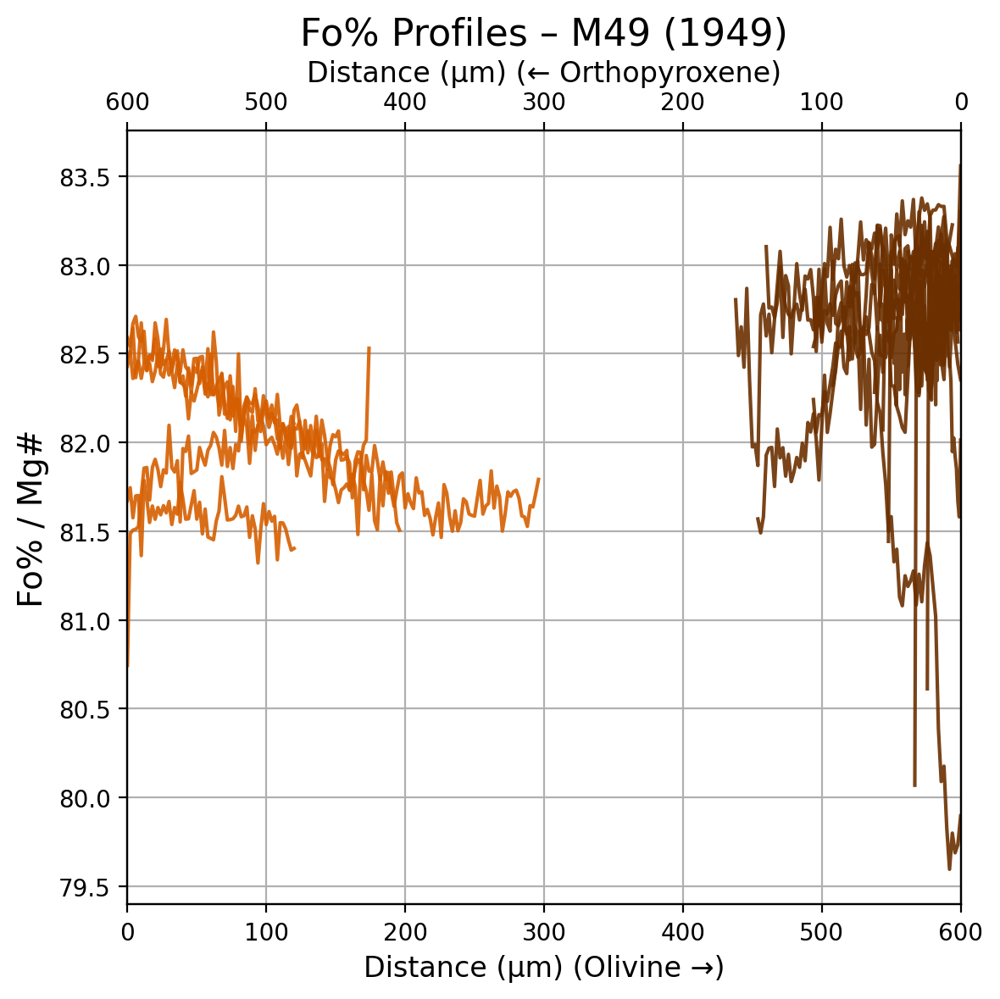

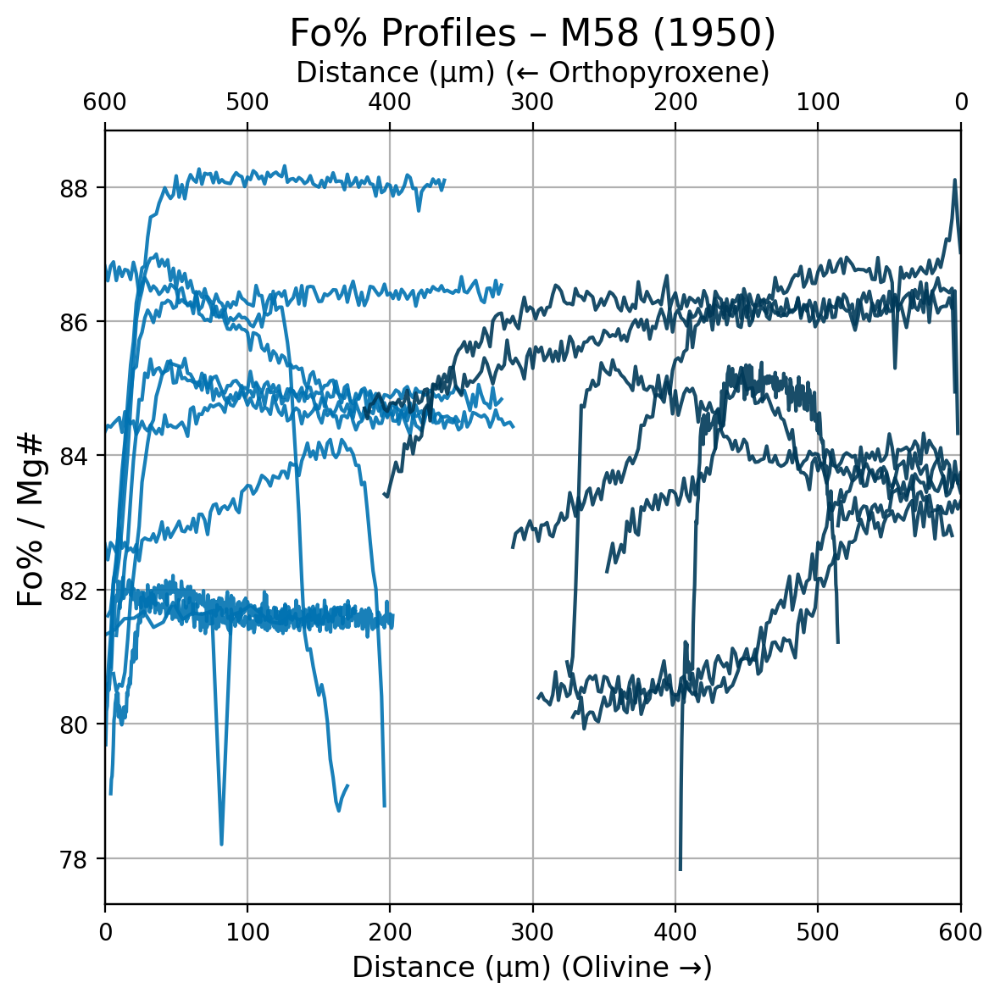

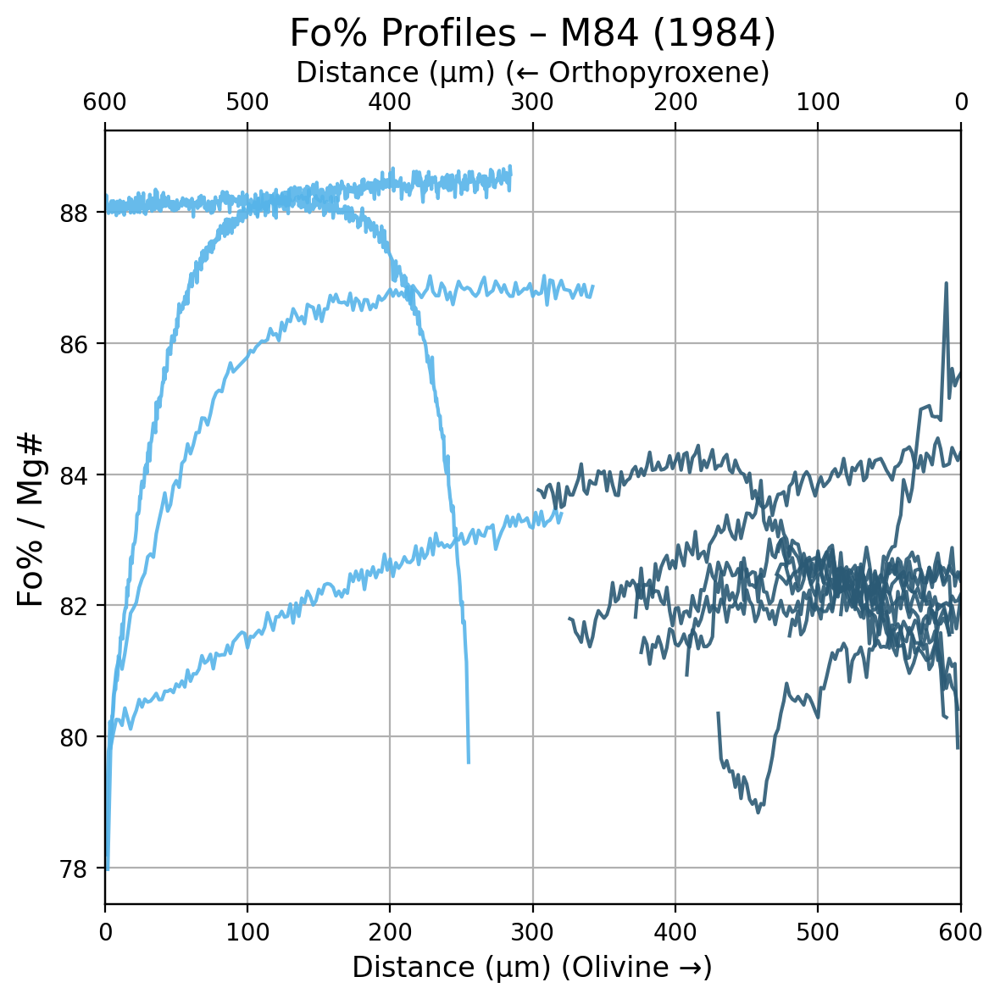

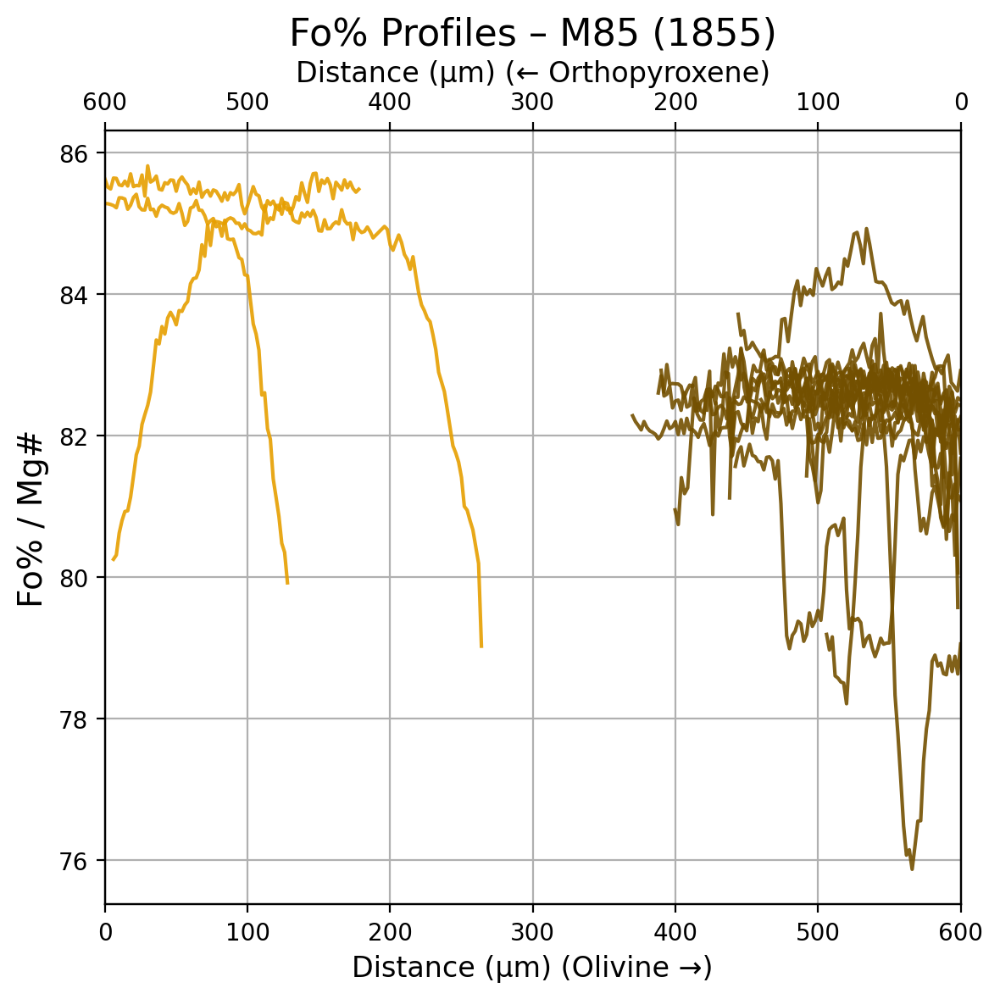

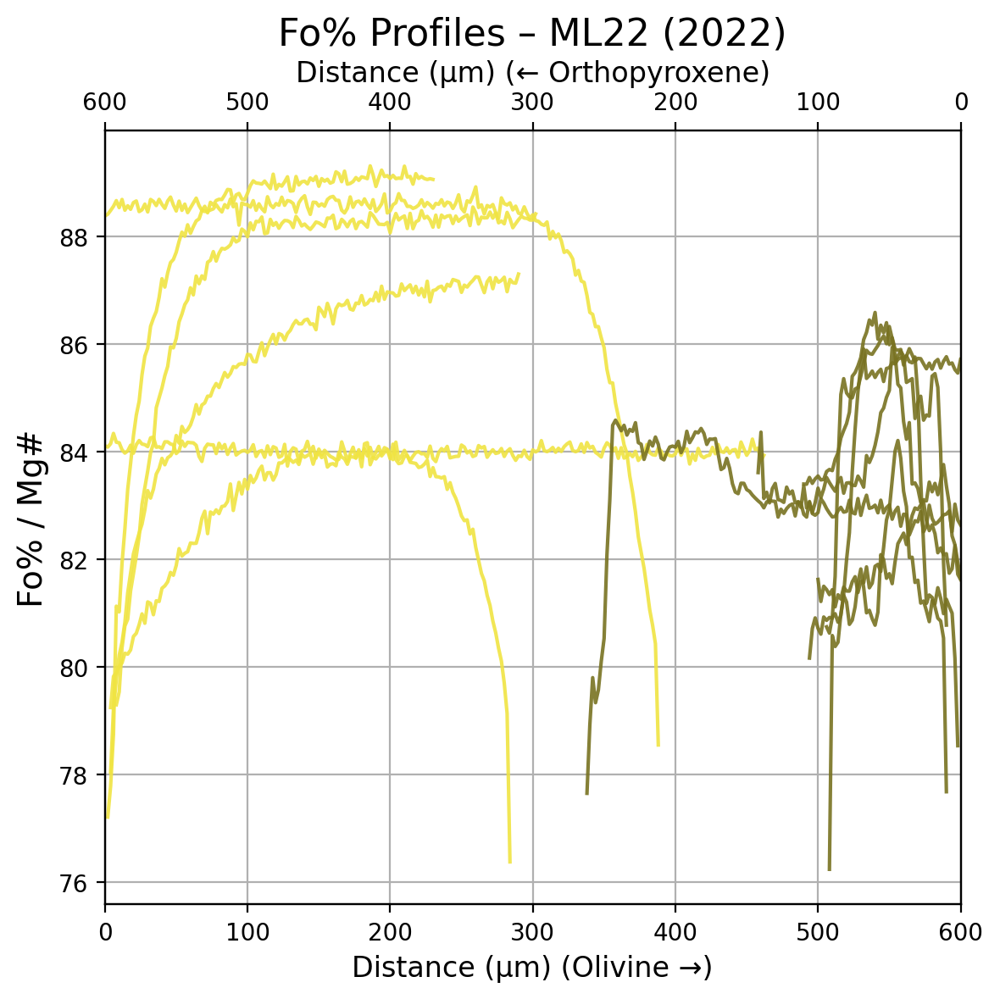

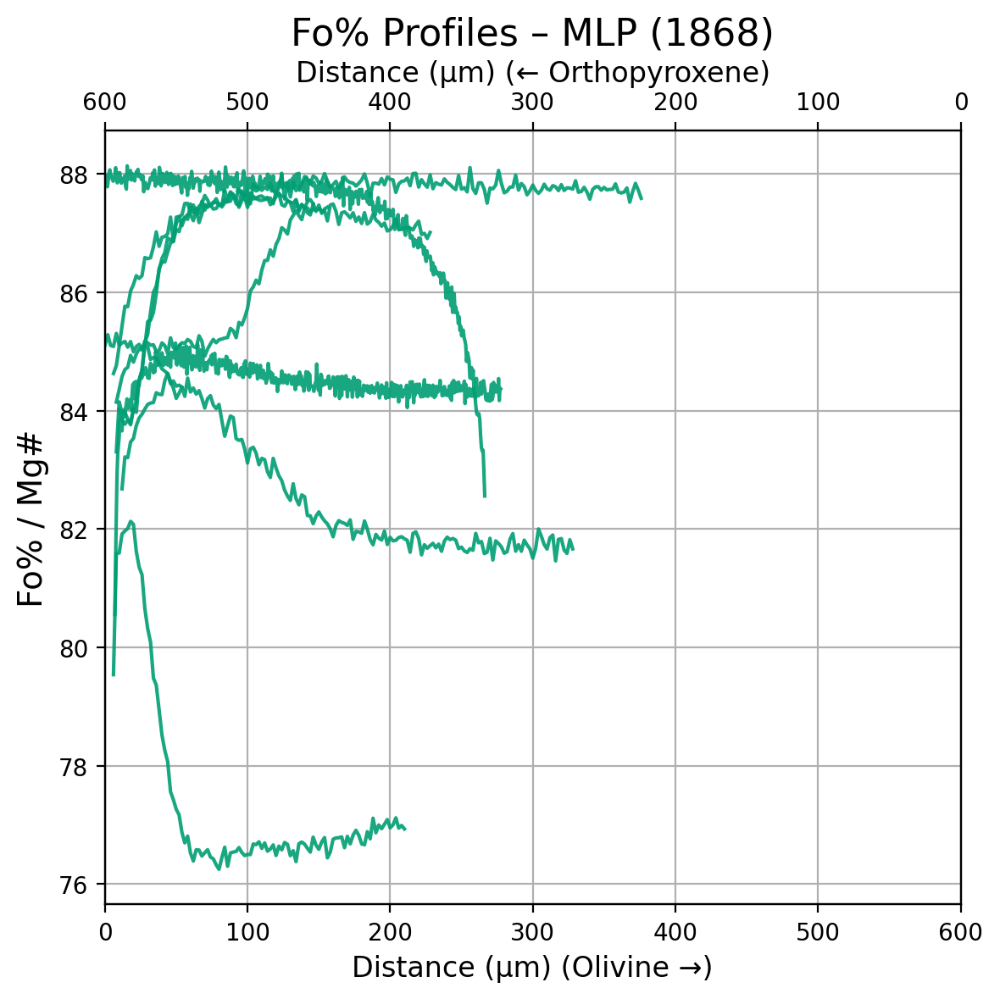

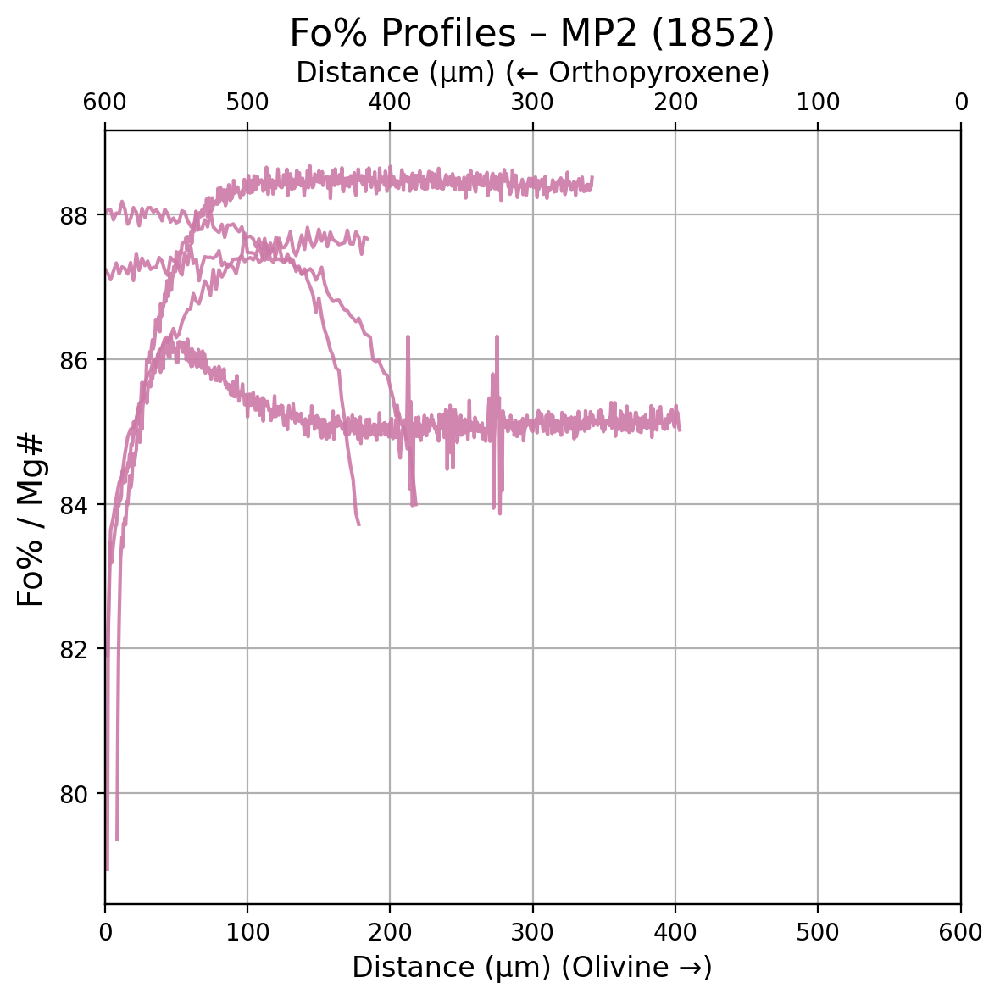

In [72]:

# Plot mirrored Fo% profiles with fixed 0–500 µm x‑axis
for eruption, profiles in fo_profiles_by_eruption.items():
    color, year = eruption_colors_year.get(eruption, ('gray', 'unknown'))

    fig, ax = plt.subplots(figsize=(6, 6), dpi=200)
    ax2 = ax.twiny()  # mirrored x-axis for Opx

    ax.set_title(f"Fo% Profiles – {eruption} ({year})", fontsize=16)

    for p in profiles:
        x = p['distance']
        y = p['fo']
        label = f"{p['mineral']}: {p['sample']}"

        if p['mineral'] == 'Olivine':
            ax.plot(x, y, label=label, color=color, alpha=0.9, linewidth=1.5)
        elif p['mineral'] == 'Orthopyroxene':
            darker_color = darken_color(color, amount=0.5)
            ax2.plot(x, y, label=label, color=darker_color, linestyle='-', alpha=0.9, linewidth=1.5)

    # Fixed axes 0–500 µm
    ax.set_xlim(0, 600)
    ax2.set_xlim(600, 0)  # mirrored

    ax.set_xlabel("Distance (µm) (Olivine →)", fontsize=12)
    ax2.set_xlabel("Distance (µm) (← Orthopyroxene)", fontsize=12)
    ax.set_ylabel("Fo% / Mg#", fontsize=14)

    # Combine legends
    handles1, labels1 = ax.get_legend_handles_labels()
    handles2, labels2 = ax2.get_legend_handles_labels()
    # ax.legend(handles1 + handles2, labels1 + labels2, fontsize=8, title="Profiles")

    ax.grid(True)
    plt.tight_layout()
    plt.show()

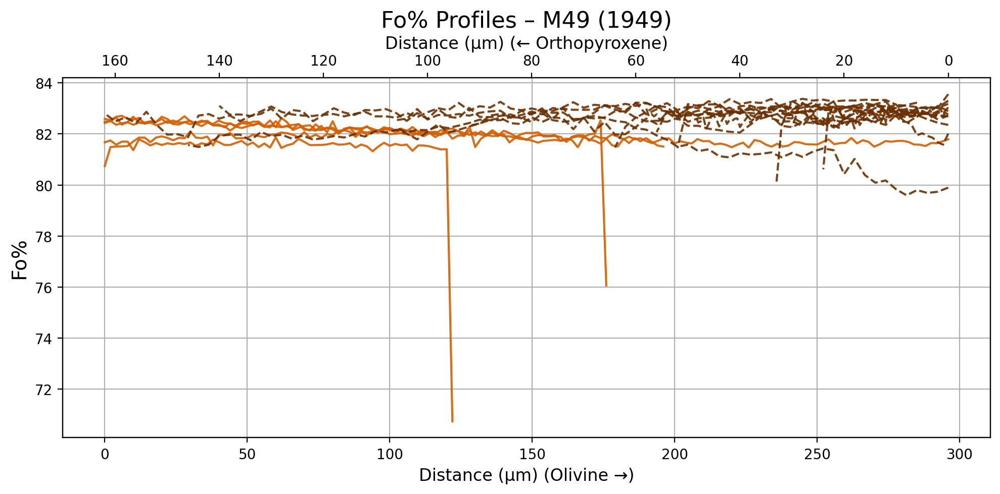

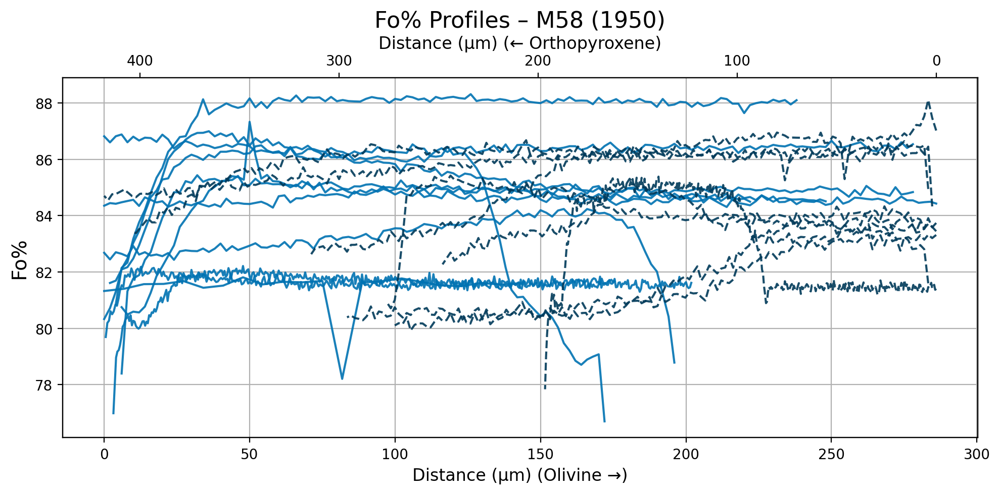

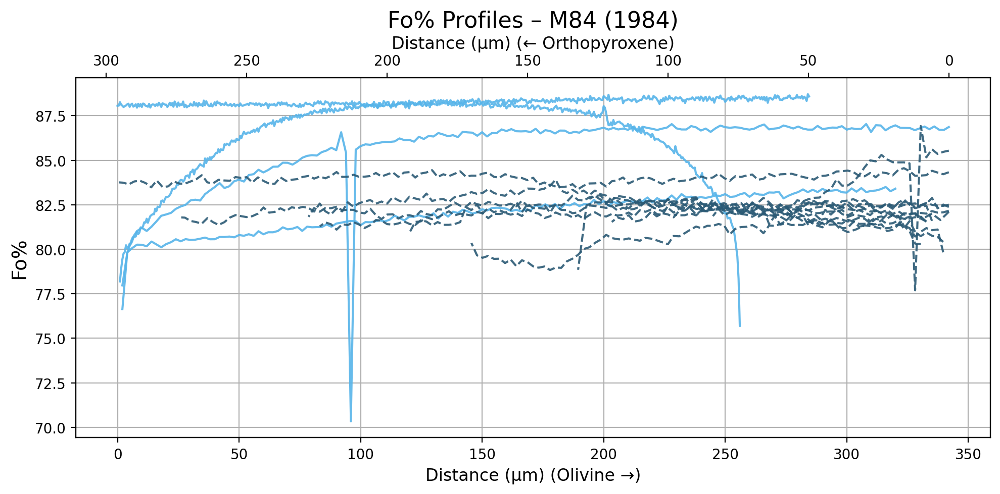

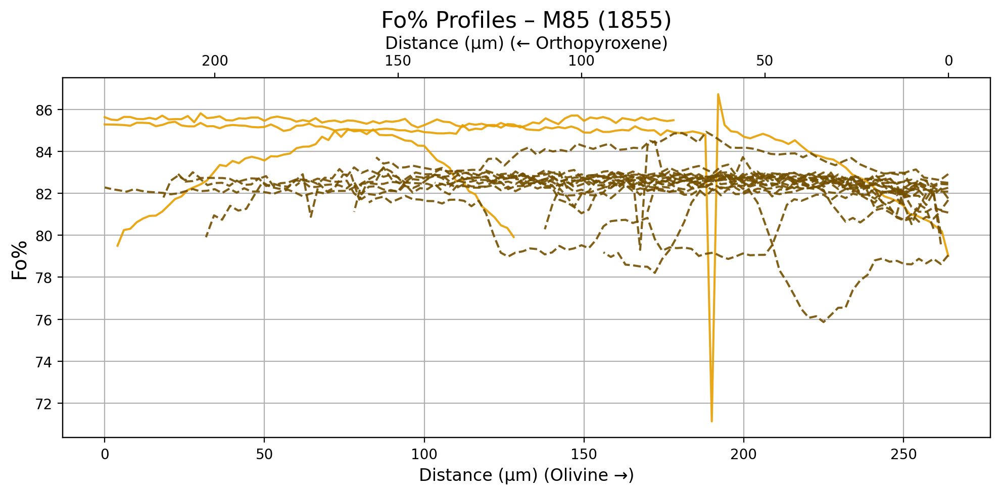

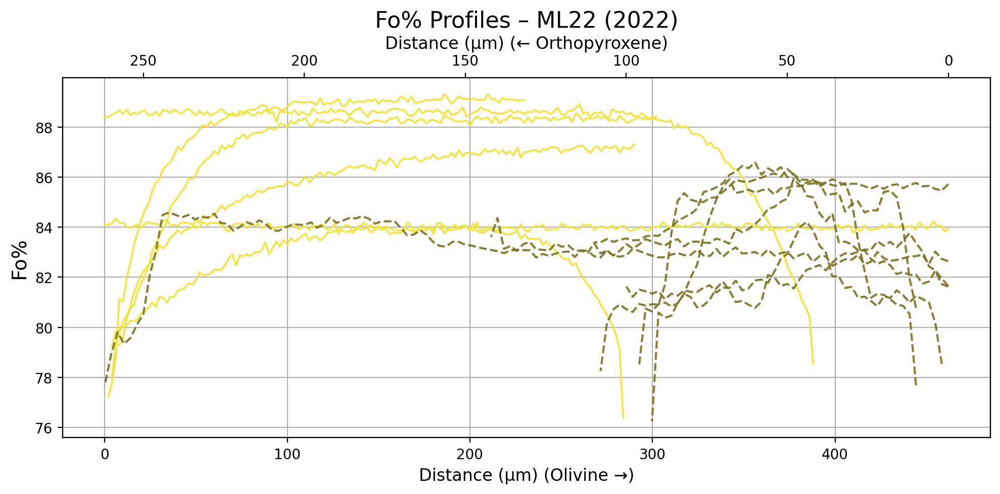

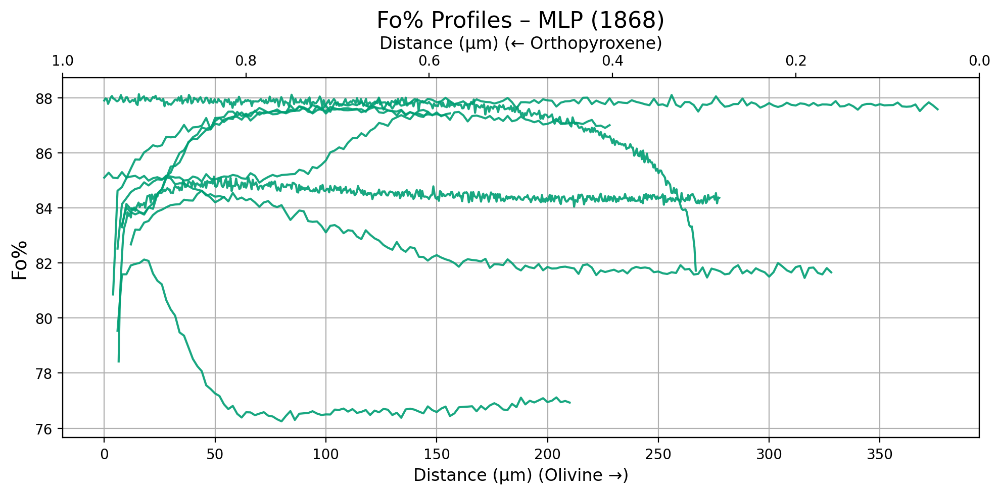

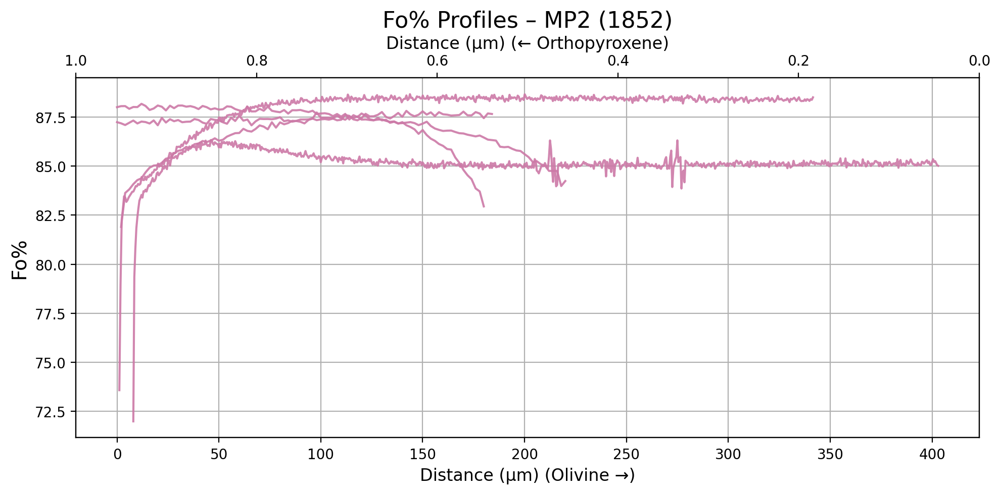

In [53]:
from matplotlib.colors import to_rgb

def darken_color(color, amount=0.5):
    """Darken a matplotlib color by multiplying RGB values"""
    r, g, b = to_rgb(color)
    return (r * amount, g * amount, b * amount)

for eruption, profiles in fo_profiles_by_eruption.items():
    color, year = eruption_colors_year.get(eruption, ('gray', 'unknown'))

    fig, ax = plt.subplots(figsize=(10, 5), dpi=200)
    ax2 = ax.twiny()  # mirrored x-axis for Opx

    ax.set_title(f"Fo% Profiles – {eruption} ({year})", fontsize=16)

    for p in profiles:
        x = p['distance']
        y = p['fo']
        label = f"{p['mineral']}: {p['sample']}"

        if p['mineral'] == 'Olivine':
            ax.plot(x, y, label=label, color=color, alpha=0.9, linewidth=1.5)
        elif p['mineral'] == 'Orthopyroxene':
            darker_color = darken_color(color, amount=0.5)
            ax2.plot(x, y, label=label, color=darker_color, alpha=0.9, linestyle='--', linewidth=1.5)

    # Format axes
    ax.set_xlabel("Distance (µm) (Olivine →)", fontsize=12)
    ax2.set_xlabel("Distance (µm) (← Orthopyroxene)", fontsize=12)
    ax.set_ylabel("Fo%", fontsize=14)
    ax2.invert_xaxis()

    # Combine legends from both axes
    handles1, labels1 = ax.get_legend_handles_labels()
    handles2, labels2 = ax2.get_legend_handles_labels()
    
    ax.grid(True)
    plt.tight_layout()
    plt.show()


Processing folder: M49
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_200_Line1
  Working on sample folder: M49_200_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.985335
1         Olivine             0.985842
2         Olivine             0.985529
3         Olivine             0.985122
4         Olivine             0.985181
Predict_Mineral
Olivine          150
Clinopyroxene      2
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)
C:\Users\alex7\AppData\Local\T

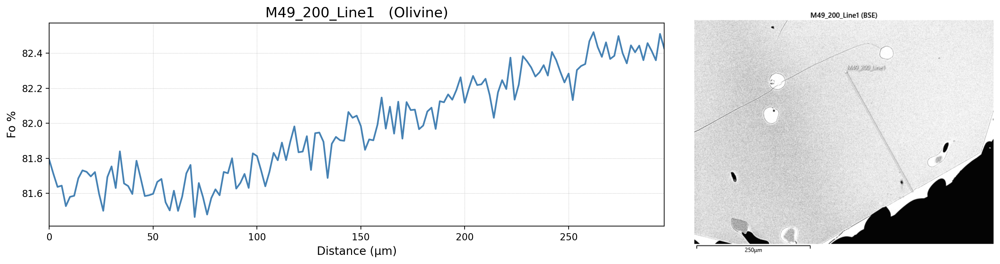

  Finished processing sample: M49_200_Line1
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_201_Line1
  Working on sample folder: M49_201_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.635827
1   Orthopyroxene             0.952215
2   Orthopyroxene             0.961174
3   Orthopyroxene             0.963357
4   Orthopyroxene             0.962932
Predict_Mineral
Orthopyroxene    81
Amphibole         1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)
C:\Users\alex7\AppData\Local\T

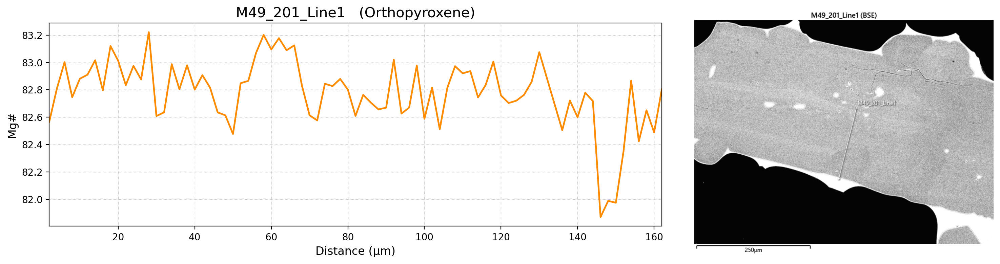

  Finished processing sample: M49_201_Line1
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_201_XL2_Line2
  Working on sample folder: M49_201_XL2_Line2
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.975551
1   Orthopyroxene             0.975930
2   Orthopyroxene             0.975338
3   Orthopyroxene             0.974958
4   Orthopyroxene             0.975850
Predict_Mineral
Orthopyroxene    17
Amphibole         3
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)
C:\Users\alex7\AppData\Local\T

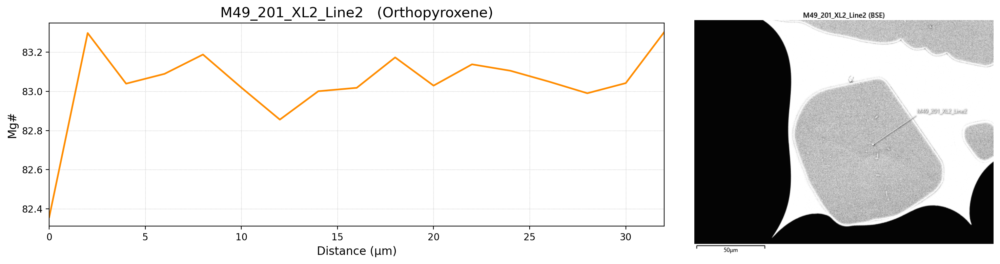

  Finished processing sample: M49_201_XL2_Line2
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_Line1
  Working on sample folder: M49_212_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0       Amphibole             0.923321
1       Amphibole             0.925939
2       Amphibole             0.945298
3   Orthopyroxene             0.948468
4   Orthopyroxene             0.959040
Predict_Mineral
Orthopyroxene    51
Amphibole         3
Name: count, dtype: int64


C:\Users\alex7\AppData\Local\Temp\ipykernel_9352\4021630095.py:414: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


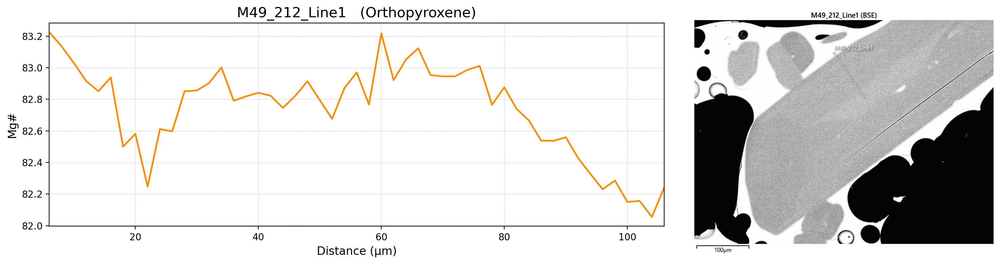

  Finished processing sample: M49_212_Line1
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_Line2
  Working on sample folder: M49_212_Line2
  Predict_Mineral  Predict_Probability
0       Amphibole             0.934066
1       Amphibole             0.927680
2       Amphibole             0.936888
3       Amphibole             0.947109
4   Orthopyroxene             0.949871
Predict_Mineral
Orthopyroxene    67
Amphibole         4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)
C:\Users\alex7\AppData\Local\T

KeyboardInterrupt: 

In [ ]:
base_directory = r"C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans"
fo_profiles = []
for eruption_folder in os.listdir(base_directory):
        eruption_folder_path = os.path.join(base_directory, eruption_folder)
        if os.path.isdir(eruption_folder_path):
            print(f"Processing folder: {eruption_folder}")
            for sample_folder in os.listdir(eruption_folder_path):
                sample_folder_path = os.path.join(eruption_folder_path, sample_folder)
                print(f"    Found: {sample_folder_path}")  # NEW DEBUG LINE
                if not os.path.isdir(sample_folder_path):
                    print(f"    Skipping (not a dir): {sample_folder_path}")
                    continue
                
                # If it's a directory, proceed with the sample
                if not os.path.isdir(sample_folder_path):
                    continue
                print(f"  Working on sample folder: {sample_folder}")
                # Get all CSV files in the folder
                csv_files = [f for f in os.listdir(sample_folder_path) if f.endswith('.csv')]
                if not csv_files:
                    print(f"    No CSV found in {sample_folder_path}")
                    continue
                        # Load the first CSV file (assuming only one file per sample)
                linescan_file = csv_files[0]
                linescan_file_path = os.path.join(sample_folder_path, linescan_file)
                    
                # Read in the CSV data
                data = pd.read_csv(linescan_file_path)

                # Step 1: Rename the oxide columns
                rename_dict = {
                    'Mg Ox%': 'MgO',
                    'Si Ox%': 'SiO2',
                    'Ca Ox%': 'CaO',
                    'Mn Ox%': 'MnO',
                    'Fe Ox%': 'FeOt',
                    'Ni Ox%': 'NiO',
                    'Al Ox%': 'Al2O3',
                    'Ti Ox%': 'TiO2',
                    'Cr Ox%': 'Cr2O3'
                }
                data.rename(columns=rename_dict, inplace=True)

                # Step 2: Use pt.minClass to classify the points and add 'Predict_Mineral' and 'Predict_Probability'
                data = pt.minClass(data)  # Assuming pt.minClass() adds these columns
                print(data[['Predict_Mineral', 'Predict_Probability']].head())
                print(data['Predict_Mineral'].value_counts())
                # Step 3: Classify each spot based on Predict_Mineral and Predict_Probability
                classification = np.where(
                    (data['Predict_Probability'] >= 0.9),
                    data['Predict_Mineral'],
                    'Glass'
                )
                data['MineralType'] = classification
                # Step 4: Identify transitions (change in mineral type)
                # Identify transitions: first row where MineralType changes
                data['PrevType'] = data['MineralType'].shift(1)
                transition_mask = data['MineralType'] != data['PrevType']
                transition_mask.iloc[0] = False
                transitions_df = data[transition_mask].copy()

                # 🔴 Filter out any transitions *into* Glass
                transitions_df = transitions_df[transitions_df['MineralType'] != 'Glass']
            
                
                # Step 4: Filter for plotting — only Olivine and Orthopyroxene
                allowed_minerals = ['Olivine', 'Orthopyroxene']
                mineral_data = data[data['MineralType'].isin(allowed_minerals)].copy()
                # Group by dominant mineral in this sample
                mineral_label = data['MineralType'].mode().iloc[0]
                mineral_data = data[data['MineralType'] == mineral_label].copy()
                
                # STEP X: Calculate Mg# and Fo% for olivine-only samples
                if mineral_label == 'Olivine':
                    mineral_data['Mg_mol'] = mineral_data['MgO'] / 40.304
                    mineral_data['Fe_mol'] = mineral_data['FeOt'] / 71.844
                    mineral_data['Fo%'] = 100 * mineral_data['Mg_mol'] / (mineral_data['Mg_mol'] + mineral_data['Fe_mol'])
                if mineral_label == 'Orthopyroxene':
                    mineral_data['Mg_mol'] = mineral_data['MgO'] / 40.304
                    mineral_data['Fe_mol'] = mineral_data['FeOt'] / 71.844
                    mineral_data['Mg#'] = 100 * mineral_data['Mg_mol'] / (mineral_data['Mg_mol'] + mineral_data['Fe_mol'])   
                    
                    
                        # Remove specific bad points
                if sample_folder == 'M49_201_Line1':
                    mineral_data = mineral_data[~mineral_data['Distance (µm)'].isin([132, 134])]
                if sample_folder == 'M49_200_Line1':
                    bad_distances = [298]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)] 
                if sample_folder == 'M84_212_Line1':
                    bad_distances = [96]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]
                if sample_folder == 'M49_220_Line1':
                    bad_distances = [176]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]  
                if sample_folder == 'M49_214_Line2':
                    bad_distances = [20]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]  
                if sample_folder == 'M49_220_Line2':
                    bad_distances = [128,130]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M49_220_Line3':
                    bad_distances = [0]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M49_222_XL2_Line1':
                    bad_distances = [122, 60]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M49_226_XL2_Line2':
                    bad_distances = [64]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M49_226_XL2_Line2':
                    bad_distances = [56]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M58_201_Line1':
                    bad_distances = [34]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M58_207_Line2':
                    bad_distances = [3.1818181818]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M58_210_Line1':
                    bad_distances = [172]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_212_Line1':
                    bad_distances = [48, 50, 52]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_215_Line1':
                    bad_distances = [4]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_218_Line1':
                    bad_distances = [2]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_227_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_229_Line1':
                    bad_distances = [76, 4]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_232_Line1':
                    bad_distances = [6]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_223_Line1':
                    bad_distances = [0]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_202_Line1':
                    bad_distances = [12, 32, 24, 26, 38]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_204_Line1':
                    bad_distances = [132]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_207_Line1':
                    bad_distances = [2]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_210_Line1':
                    bad_distances = [255.5, 256, 200.5, 201, 199, 199.5, 200]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_212_Line1':
                    bad_distances = [2, 92, 94, 96, 98]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_215_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_216_Line1':
                    bad_distances = [1]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_218_Line1':
                    bad_distances = [2, 2.00000000000002]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_215_Line1':
                    bad_distances = [4, 4.00000000000001]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_215_XL2_Line2':
                    bad_distances = [190, 192, 194]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_223_XL2_Line2':
                    bad_distances = [214]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_224_XL2_Line2':
                    bad_distances = [110]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_225_Line1':
                    bad_distances = [162]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_225_XL2_Line2':
                    bad_distances = [82]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_227_XL2_Line4':
                    bad_distances = [2]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_228_Line1':
                    bad_distances = [202.4]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_228_Line2':
                    bad_distances = [2, 84, 80, 82]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'ML22_77_5_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'ML22_88_6_Line2':
                    bad_distances = [10]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'ML22_88_6_Line3':
                    bad_distances = [108]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'ML22_88_6_XL2_Line4':
                    bad_distances = [96]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_206_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_207_Line1':
                    bad_distances = [266.894736842105]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_208_Line1':
                    bad_distances = [6.5, 7, 7.5]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_211_Line1':
                    bad_distances = [4]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_213_Line1':
                    bad_distances = [6,8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MP2_212_Line1':
                    bad_distances = [1.15, 1.14999999999999]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MP2_214_Line1':
                    bad_distances = [216, 220]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MP2_218_Line1':
                    bad_distances = [180]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MP2_220_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]
                if sample_folder == 'M58_220_Line1':
                    bad_distances = [182, 184, 186]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)] 
                if sample_folder == 'M58_218_Line1':
                    bad_distances = [1.99999999999999, 2]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]
                if sample_folder == 'M84_210_Line1':
                    bad_distances = [201.5, 202, 202.5, 203, 203.5, 204, 204.5, 205]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]  
                if sample_folder == 'MP2_220_Line1':
                    bad_distances = [212.5, 213, 213.5, 214,214.5, 215, 215.5, 216, 216.5, 272, 272.5, 273, 273.5, 274, 274.5, 275, 275.5, 276,276.5, 277, 277.5, 278, 278.5, 279]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]  
                         
                if sample_folder == 'ML22_27_2_Line1':
                    bad_distances = [284]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)] 
                           
                       
                # ── samples whose distance scale must be flipped ──────────────────
                reverse_samples = {
                    'M49_200_Line1',
                    'M49_201_XL2_Line2',
                    'M49_212_XL2_Line3',
                    'M49_212_XL3_Line5',
                    'M49_212_Xl4_Line6',
                    'M49_214_Line2',
                    'M49_220_Line1',
                    'M49_220_Line2',
                    'M49_222_XL2_Line1',
                    'M49_226_XL1_Line1',
                    'M49_226_XL2_Line2',
                    'M59_226_XL3_Line3',
                    'M58_203_Line1',
                    'M58_210_Line1',
                    'M58_216_Line1',
                    'M58_220_Line1',
                    'M58_230_Line1',
                    'M84_202_Line1'
                    'M84_204_Line1',
                    'M84_208_Line1',
                    'M84_210_Line1',
                    'M84_217_Line1',
                    'M85_207_Line1',
                    'M85_215_XL2_Line2',
                    'M85_215_XL3_Line3',
                    'M85_220_XL2_Line2',
                    'M85_220_Xl3_Line3',
                    'M85_223_XL2_Line2',
                    'M85_224_XL2_Line2',
                    'M85_225_Line1',
                    'M85_225_XL2_Line2',
                    'M85_228_Line1',
                    'ML22_27_2_Line1',
                    'ML22_76_1_Line1',
                    'ML22_88_5_Line1',
                    'ML22_88_6_Line3',
                    'ML22_88_6_XL2_Line4',
                    'ML22_88_6_XL3_Line5',
                    'MLP_207_Line1',
                    'MLP_211_XL2_Line2',
                    'MP2_214_Line1',
                    'MP2_218_Line1'
                }

                # ── reverse the distance scale if this sample is in the set ───────
                if sample_folder in reverse_samples:
                    d_max = mineral_data['Distance (µm)'].max()
                    mineral_data['Distance (µm)'] = d_max - mineral_data['Distance (µm)']
                    mineral_data.sort_values('Distance (µm)', inplace=True)                      
                    
                # Step 5: Identify transitions → first Olivine or Opx after Glass or Clinopyroxene
                mineral_data['PrevType'] = mineral_data['MineralType'].shift(1)
                transition_mask = mineral_data['PrevType'].isin(['Glass', 'Clinopyroxene'])
                transitions_df = mineral_data[transition_mask].copy()
                # Step 6: Identify transitions (Glass → Mineral)
                # data['PrevType'] = data['MineralType'].shift(1)
                # transition_mask = (data['PrevType'] == 'Glass') & (data['MineralType'] != 'Glass')

                # # For M49_200_Line1, also exclude Cpx transitions
                # if sample_folder == 'M49_200_Line1':
                #     transition_mask &= data['MineralType'] != 'Clinopyroxene'

                # transitions_df = data[transition_mask].copy()

                # Exclude 'Glass' when choosing the dominant mineral
                valid_minerals = mineral_data['MineralType'].unique()
                if len(valid_minerals) == 0:
                    print(f"  Skipping {sample_folder} — no valid mineral data.")
                    continue

                mineral_label = mineral_data['MineralType'].mode().iloc[0]

                if mineral_label == 'Orthopyroxene':
                    element_columns = ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']
                elif mineral_label == 'Olivine':
                    raw_ol_element_cols = ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']
                    element_columns = [c for c in raw_ol_element_cols if c in mineral_data.columns]
                # elif mineral_label == 'Clinopyroxene':
                #     element_columns = ['MgO', 'CaO', 'FeOt', 'SiO2', 'Al2O3', 'TiO2']  # Example — adjust as needed
                else:
                    print(f"  Unknown mineral type '{mineral_label}' for {sample_folder}, skipping.")
                    continue

                # Step 6: Load BSE image if it exists
                bse_image_path = os.path.join(sample_folder_path, f"{sample_folder} (BSE).tif")
                bse_image = None
                if os.path.exists(bse_image_path):
                    bse_image = io.imread(bse_image_path)

                # Step 7: Plot the linescan (only minerals, with transition points)
                # ── Step 7: Fo % / Mg# vs Distance  +  BSE image ─────────────────
                # sort by distance for a clean profile
                data_sorted = mineral_data.sort_values('Distance (µm)').reset_index(drop=True)

                fig, ax = plt.subplots(figsize=(10, 4), dpi=200)
                ax.set_title(f"{sample_folder}   ({mineral_label})", fontsize=15)

                if mineral_label == "Olivine":            # plot Fo %
                    ax.plot(data_sorted['Distance (µm)'], data_sorted['Fo%'],
                            lw=1.8, color="steelblue")
                    ax.set_ylabel("Fo %", fontsize=12)
                else:                                     # plot Mg# for Opx
                    ax.plot(data_sorted['Distance (µm)'], data_sorted['Mg#'],
                            lw=1.8, color="darkorange")
                    ax.set_ylabel("Mg#", fontsize=12)

                ax.set_xlabel("Distance (µm)", fontsize=12)
                ax.set_xlim(data_sorted['Distance (µm)'].min(), data_sorted['Distance (µm)'].max())
                ax.grid(True, ls=":", lw=0.5)

                # mark transition points, if any
                if not transitions_df.empty:
                    y_col = 'Fo%' if mineral_label == 'Olivine' else 'Mg#'
                    ax.scatter(transitions_df['Distance (µm)'], transitions_df[y_col],
                            s=60, c='red', marker='*', zorder=3)

                # # ── add BSE image on the right, if it exists ─────────────────────
                # if bse_image is not None:
                #     # [left, bottom, width, height] in figure fractions
                #     ax_img = fig.add_axes([0.70, 0.10, 0.27, 0.80])
                #     ax_img.imshow(bse_image, cmap='gray')
                #     ax_img.axis('off')
                if bse_image is not None:
                    ax_image = fig.add_axes([0.8, 0.05, 0.9, 0.9])
                    ax_image.imshow(bse_image, alpha=1)
                    ax_image.axis('off')

                plt.tight_layout()
                plt.show()
                print(f"  Finished processing sample: {sample_folder}")

In [ ]:
base_directory = r"C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans"
fo_profiles = []

# Create folders to save the plots if they don't already exist
olivine_folder = r"C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots"
opx_folder = r"C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots"
os.makedirs(olivine_folder, exist_ok=True)
os.makedirs(opx_folder, exist_ok=True)



for eruption_folder in os.listdir(base_directory):
        eruption_folder_path = os.path.join(base_directory, eruption_folder)
        if os.path.isdir(eruption_folder_path):
            print(f"Processing folder: {eruption_folder}")
            for sample_folder in os.listdir(eruption_folder_path):
                sample_folder_path = os.path.join(eruption_folder_path, sample_folder)
                print(f"    Found: {sample_folder_path}")  # NEW DEBUG LINE
                if not os.path.isdir(sample_folder_path):
                    print(f"    Skipping (not a dir): {sample_folder_path}")
                    continue
                
                # If it's a directory, proceed with the sample
                if not os.path.isdir(sample_folder_path):
                    continue
                print(f"  Working on sample folder: {sample_folder}")
                # Get all CSV files in the folder
                csv_files = [f for f in os.listdir(sample_folder_path) if f.endswith('.csv')]
                if not csv_files:
                    print(f"    No CSV found in {sample_folder_path}")
                    continue
                        # Load the first CSV file (assuming only one file per sample)
                linescan_file = csv_files[0]
                linescan_file_path = os.path.join(sample_folder_path, linescan_file)
                    
                # Read in the CSV data
                data = pd.read_csv(linescan_file_path)

                # Step 1: Rename the oxide columns
                rename_dict = {
                    'Mg Ox%': 'MgO',
                    'Si Ox%': 'SiO2',
                    'Ca Ox%': 'CaO',
                    'Mn Ox%': 'MnO',
                    'Fe Ox%': 'FeOt',
                    'Ni Ox%': 'NiO',
                    'Al Ox%': 'Al2O3',
                    'Ti Ox%': 'TiO2',
                    'Cr Ox%': 'Cr2O3'
                }
                data.rename(columns=rename_dict, inplace=True)

                # Step 2: Use pt.minClass to classify the points and add 'Predict_Mineral' and 'Predict_Probability'
                data = pt.minClass(data)  # Assuming pt.minClass() adds these columns
                print(data[['Predict_Mineral', 'Predict_Probability']].head())
                print(data['Predict_Mineral'].value_counts())
                # Step 3: Classify each spot based on Predict_Mineral and Predict_Probability
                classification = np.where(
                    (data['Predict_Probability'] >= 0.9),
                    data['Predict_Mineral'],
                    'Glass'
                )
                data['MineralType'] = classification
                # Step 4: Identify transitions (change in mineral type)
                # Identify transitions: first row where MineralType changes
                data['PrevType'] = data['MineralType'].shift(1)
                transition_mask = data['MineralType'] != data['PrevType']
                transition_mask.iloc[0] = False
                transitions_df = data[transition_mask].copy()

                # 🔴 Filter out any transitions *into* Glass
                transitions_df = transitions_df[transitions_df['MineralType'] != 'Glass']
            
                
                # Step 4: Filter for plotting — only Olivine and Orthopyroxene
                allowed_minerals = ['Olivine', 'Orthopyroxene']
                mineral_data = data[data['MineralType'].isin(allowed_minerals)].copy()
                # Group by dominant mineral in this sample
                mineral_label = data['MineralType'].mode().iloc[0]
                mineral_data = data[data['MineralType'] == mineral_label].copy()
                
                # STEP X: Calculate Mg# and Fo% for olivine-only samples
                if mineral_label == 'Olivine':
                    mineral_data['Mg_mol'] = mineral_data['MgO'] / 40.304
                    mineral_data['Fe_mol'] = mineral_data['FeOt'] / 71.844
                    mineral_data['Fo%'] = 100 * mineral_data['Mg_mol'] / (mineral_data['Mg_mol'] + mineral_data['Fe_mol'])
                if mineral_label == 'Orthopyroxene':
                    mineral_data['Mg_mol'] = mineral_data['MgO'] / 40.304
                    mineral_data['Fe_mol'] = mineral_data['FeOt'] / 71.844
                    mineral_data['Mg#'] = 100 * mineral_data['Mg_mol'] / (mineral_data['Mg_mol'] + mineral_data['Fe_mol'])   
                    
                    
                        # Remove specific bad points
                if sample_folder == 'M49_201_Line1':
                    mineral_data = mineral_data[~mineral_data['Distance (µm)'].isin([132, 134])]
                if sample_folder == 'M49_200_Line1':
                    bad_distances = [298]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)] 
                if sample_folder == 'M84_212_Line1':
                    bad_distances = [96]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]
                if sample_folder == 'M49_220_Line1':
                    bad_distances = [176]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]  
                if sample_folder == 'M49_214_Line2':
                    bad_distances = [20]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]  
                if sample_folder == 'M49_220_Line2':
                    bad_distances = [128,130]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M49_220_Line3':
                    bad_distances = [0]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M49_222_XL2_Line1':
                    bad_distances = [122, 60]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M49_226_XL2_Line2':
                    bad_distances = [64]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M49_226_XL2_Line2':
                    bad_distances = [56]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M58_201_Line1':
                    bad_distances = [34]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M58_207_Line2':
                    bad_distances = [3.1818181818,4.0909090909090 ]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M58_210_Line1':
                    bad_distances = [172]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_212_Line1':
                    bad_distances = [48, 50, 52]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_215_Line1':
                    bad_distances = [4]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_218_Line1':
                    bad_distances = [2]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_227_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_229_Line1':
                    bad_distances = [76, 4]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_232_Line1':
                    bad_distances = [6]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_223_Line1':
                    bad_distances = [0]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_202_Line1':
                    bad_distances = [12, 32, 24, 26, 38]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_204_Line1':
                    bad_distances = [132]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_207_Line1':
                    bad_distances = [2]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_210_Line1':
                    bad_distances = [255.5, 256, 200.5, 201, 199, 199.5, 200]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_212_Line1':
                    bad_distances = [2, 92, 94, 96, 98]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_215_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_216_Line1':
                    bad_distances = [1]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_218_Line1':
                    bad_distances = [2, 2.00000000000002]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_215_Line1':
                    bad_distances = [4, 4.00000000000001]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_215_XL2_Line2':
                    bad_distances = [190, 192, 194]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_223_XL2_Line2':
                    bad_distances = [214]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_224_XL2_Line2':
                    bad_distances = [110]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_225_Line1':
                    bad_distances = [162]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_225_XL2_Line2':
                    bad_distances = [82]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_227_XL2_Line4':
                    bad_distances = [2]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_228_Line1':
                    bad_distances = [202.4]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_228_Line2':
                    bad_distances = [2, 84, 80, 82]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'ML22_77_5_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'ML22_88_6_Line2':
                    bad_distances = [10]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'ML22_88_6_Line3':
                    bad_distances = [108]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'ML22_88_6_XL2_Line4':
                    bad_distances = [96]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_206_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_207_Line1':
                    bad_distances = [266.894736842105]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_208_Line1':
                    bad_distances = [6.5, 7, 7.5]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_211_Line1':
                    bad_distances = [4]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_213_Line1':
                    bad_distances = [6,8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MP2_212_Line1':
                    bad_distances = [1.15, 1.14999999999999]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MP2_214_Line1':
                    bad_distances = [216, 220]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MP2_218_Line1':
                    bad_distances = [180]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MP2_220_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]
                if sample_folder == 'M58_220_Line1':
                    bad_distances = [182, 184, 186]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)] 
                if sample_folder == 'M58_218_Line1':
                    bad_distances = [1.99999999999999, 2]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]
                if sample_folder == 'M84_210_Line1':
                    bad_distances = [201.5, 202, 202.5, 203, 203.5, 204, 204.5, 205]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]  
                if sample_folder == 'MP2_220_Line1':
                    bad_distances = [212.5, 213, 213.5, 214,214.5, 215, 215.5, 216, 216.5, 272, 272.5, 273, 273.5, 274, 274.5, 275, 275.5, 276,276.5, 277, 277.5, 278, 278.5, 279]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]          
                if sample_folder == 'ML22_27_2_Line1':
                    bad_distances = [284]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]       
                # ── samples whose distance scale must be flipped ──────────────────
                reverse_samples = {
                    'M49_200_Line1',
                    'M49_201_XL2_Line2',
                    'M49_212_XL2_Line3',
                    'M49_212_XL3_Line5',
                    'M49_212_Xl4_Line6',
                    'M49_214_Line2',
                    'M49_220_Line1',
                    'M49_220_Line2',
                    'M49_222_XL2_Line1',
                    'M49_226_XL1_Line1',
                    'M49_226_XL2_Line2',
                    'M59_226_XL3_Line3',
                    'M58_203_Line1',
                    'M58_210_Line1',
                    'M58_216_Line1',
                    'M58_220_Line1',
                    'M58_230_Line1',
                    'M84_202_Line1',
                    'M84_204_Line1',
                    'M84_208_Line1',
                    'M84_210_Line1',
                    'M84_217_Line1',
                    'M85_207_Line1',
                    'M85_215_XL2_Line2',
                    'M85_215_XL3_Line3',
                    'M85_220_XL2_Line2',
                    'M85_220_Xl3_Line3',
                    'M85_223_XL2_Line2',
                    'M85_224_XL2_Line2',
                    'M85_225_Line1',
                    'M85_225_XL2_Line2',
                    'M85_228_Line1',
                    'ML22_27_2_Line1',
                    'ML22_76_1_Line1',
                    'ML22_88_5_Line1',
                    'ML22_88_6_Line3',
                    'ML22_88_6_XL2_Line4',
                    'ML22_88_6_XL3_Line5',
                    'MLP_207_Line1',
                    'MLP_211_XL2_Line2',
                    'MP2_214_Line1',
                    'MP2_218_Line1'
                }
                # ── reverse the distance scale if this sample is in the set ───────
                if sample_folder in reverse_samples:
                    d_max = mineral_data['Distance (µm)'].max()
                    mineral_data['Distance (µm)'] = d_max - mineral_data['Distance (µm)']
                    mineral_data.sort_values('Distance (µm)', inplace=True)                      
                    
                # Step 5: Identify transitions → first Olivine or Opx after Glass or Clinopyroxene
                mineral_data['PrevType'] = mineral_data['MineralType'].shift(1)
                transition_mask = mineral_data['PrevType'].isin(['Glass', 'Clinopyroxene'])
                transitions_df = mineral_data[transition_mask].copy()
                # Step 6: Identify transitions (Glass → Mineral)
                # data['PrevType'] = data['MineralType'].shift(1)
                # transition_mask = (data['PrevType'] == 'Glass') & (data['MineralType'] != 'Glass')

                # # For M49_200_Line1, also exclude Cpx transitions
                # if sample_folder == 'M49_200_Line1':
                #     transition_mask &= data['MineralType'] != 'Clinopyroxene'

                # transitions_df = data[transition_mask].copy()

                # Exclude 'Glass' when choosing the dominant mineral
                valid_minerals = mineral_data['MineralType'].unique()
                if len(valid_minerals) == 0:
                    print(f"  Skipping {sample_folder} — no valid mineral data.")
                    continue

                mineral_label = mineral_data['MineralType'].mode().iloc[0]

                if mineral_label == 'Orthopyroxene':
                    element_columns = ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']
                elif mineral_label == 'Olivine':
                    raw_ol_element_cols = ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']
                    element_columns = [c for c in raw_ol_element_cols if c in mineral_data.columns]
                # elif mineral_label == 'Clinopyroxene':
                #     element_columns = ['MgO', 'CaO', 'FeOt', 'SiO2', 'Al2O3', 'TiO2']  # Example — adjust as needed
                else:
                    print(f"  Unknown mineral type '{mineral_label}' for {sample_folder}, skipping.")
                    continue

                # Step 6: Load BSE image if it exists
                bse_image_path = os.path.join(sample_folder_path, f"{sample_folder} (BSE).tif")
                bse_image = None
                if os.path.exists(bse_image_path):
                    bse_image = io.imread(bse_image_path)

                # Step 7: Plot the linescan (only minerals, with transition points)
                # ── Step 7: Fo % / Mg# vs Distance  +  BSE image ─────────────────
                # sort by distance for a clean profile
                data_sorted = mineral_data.sort_values('Distance (µm)').reset_index(drop=True)
                n = 3  # number of points to average for rim and core

                if mineral_label == "Olivine" and 'Fo%' in data_sorted.columns:
                    rim_Fo = data_sorted['Fo%'].iloc[:n].mean()
                    core_Fo = data_sorted['Fo%'].iloc[-n:].mean()
                    
                    fo_profiles.append({
                        'Sample Name': sample_folder,
                        'Fo_Rim': rim_Fo,
                        'Fo_Core': core_Fo
                    })
                if mineral_label == "Orthopyroxene" and 'Mg#' in data_sorted.columns:
                    rim_Mg = data_sorted['Mg#'].iloc[:n].mean()
                    core_Mg = data_sorted['Mg#'].iloc[-n:].mean()
                    
                    fo_profiles.append({
                        'Sample Name': sample_folder,
                        'Mg_Rim': rim_Mg,
                        'Mg_Core': core_Mg
                    })
                    
                fig, ax = plt.subplots(figsize=(10, 4), dpi=200)
                ax.set_title(f"{sample_folder}   ({mineral_label})", fontsize=15)

                if mineral_label == "Olivine":            # plot Fo %
                    ax.plot(data_sorted['Distance (µm)'], data_sorted['Fo%'],
                            lw=1.8, color="steelblue")
                    ax.set_ylabel("Fo %", fontsize=12)
                else:                                     # plot Mg# for Opx
                    ax.plot(data_sorted['Distance (µm)'], data_sorted['Mg#'],
                            lw=1.8, color="darkorange")
                    ax.set_ylabel("Mg#", fontsize=12)

                ax.set_xlabel("Distance (µm)", fontsize=12)
                ax.set_xlim(data_sorted['Distance (µm)'].min(), data_sorted['Distance (µm)'].max())
                ax.grid(True, ls=":", lw=0.5)

                # mark transition points, if any
                if not transitions_df.empty:
                    y_col = 'Fo%' if mineral_label == 'Olivine' else 'Mg#'
                    ax.scatter(transitions_df['Distance (µm)'], transitions_df[y_col],
                            s=60, c='red', marker='*', zorder=3)

                # # ── add BSE image on the right, if it exists ─────────────────────
                # if bse_image is not None:
                #     # [left, bottom, width, height] in figure fractions
                #     ax_img = fig.add_axes([0.70, 0.10, 0.27, 0.80])
                #     ax_img.imshow(bse_image, cmap='gray')
                #     ax_img.axis('off')
                if bse_image is not None:
                    ax_image = fig.add_axes([0.8, 0.05, 0.9, 0.9])
                    ax_image.imshow(bse_image, alpha=1)
                    ax_image.axis('off')
                # Save the plot in the corresponding folder based on mineral
                if mineral_label == "Olivine":
                    save_path = os.path.join(olivine_folder, f"{sample_folder}_Olivine_Linescan.png")
                elif mineral_label == "Orthopyroxene":
                    save_path = os.path.join(opx_folder, f"{sample_folder}_Orthopyroxene_Linescan.png")
                else:
                    save_path = os.path.join(base_directory, f"{sample_folder}_Linescan.png")  # fallback

                #plt.tight_layout()
                plt.savefig(save_path, dpi=300, bbox_inches="tight")
                plt.close()
                print(f"  Plot saved to: {save_path}")
                
# Convert the Fo% rim/core list to a DataFrame
df_fo_summary = pd.DataFrame(fo_profiles)

# Optionally save to Excel or CSV
df_fo_summary.to_csv("Fo_Rim_Core_Summary2.csv", index=False)

# Preview
print(df_fo_summary.head())

Processing folder: M49
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_200_Line1
  Working on sample folder: M49_200_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.973326
1         Olivine             0.974237
2         Olivine             0.973681
3         Olivine             0.972959
4         Olivine             0.973074
Predict_Mineral
Olivine          150
Clinopyroxene      2
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M49_200_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_201_Line1
  Working on sample folder: M49_201_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.614524
1   Orthopyroxene             0.967481
2   Orthopyroxene             0.974048
3   Orthopyroxene             0.975567
4   Orthopyroxene             0.975294
Predict_Mineral
Orthopyroxene    81
Amphibole         1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M49_201_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_201_XL2_Line2
  Working on sample folder: M49_201_XL2_Line2
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.970172
1   Orthopyroxene             0.970919
2   Orthopyroxene             0.970041
3   Orthopyroxene             0.969686
4   Orthopyroxene             0.970968
Predict_Mineral
Orthopyroxene    17
Amphibole         3
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M49_201_XL2_Line2_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_Line1
  Working on sample folder: M49_212_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.932426
1       Amphibole             0.933614
2       Amphibole             0.947191
3   Orthopyroxene             0.956313
4   Orthopyroxene             0.965476
Predict_Mineral
Orthopyroxene    51
Amphibole         3
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M49_212_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_Line2
  Working on sample folder: M49_212_Line2
  Predict_Mineral  Predict_Probability
0       Amphibole             0.939989
1       Amphibole             0.932174
2       Amphibole             0.947252
3       Amphibole             0.952996
4   Orthopyroxene             0.954719
Predict_Mineral
Orthopyroxene    67
Amphibole         4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M49_212_Line2_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_Line4
  Working on sample folder: M49_212_Line4
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.967628
1   Orthopyroxene             0.968033
2   Orthopyroxene             0.967679
3   Orthopyroxene             0.970152
4   Orthopyroxene             0.966199
Predict_Mineral
Orthopyroxene    14
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M49_212_Line4_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_Line7
  Working on sample folder: M49_212_Line7
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.975879
1   Orthopyroxene             0.974600
2   Orthopyroxene             0.974721
3   Orthopyroxene             0.973618
4   Orthopyroxene             0.973760
Predict_Mineral
Orthopyroxene    117
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M49_212_Line7_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_XL2_Line3
  Working on sample folder: M49_212_XL2_Line3


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.966343
1   Orthopyroxene             0.968036
2   Orthopyroxene             0.965970
3   Orthopyroxene             0.966359
4   Orthopyroxene             0.964848
Predict_Mineral
Orthopyroxene    34
Amphibole         2
Name: count, dtype: int64
  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M49_212_XL2_Line3_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_XL3_Line5
  Working on sample folder: M49_212_XL3_Line5
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.974904
1   Orthopyroxene             0.973069
2   Orthopyroxene             0.972747
3   Orthopyroxene             0.972955
4   Orthopyroxene             0.974111
Predict_Mineral
Orthopyroxene    31
Amphibole         3
Name: count, d

c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M49_212_XL3_Line5_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_212_XL4_Line6
  Working on sample folder: M49_212_XL4_Line6
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.964329
1   Orthopyroxene             0.962981
2   Orthopyroxene             0.964903
3   Orthopyroxene             0.966486
4   Orthopyroxene             0.966159
Predict_Mineral
Orthopyroxene    25
Amphibole         5
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M49_212_XL4_Line6_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_214_Line1
  Working on sample folder: M49_214_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.921998
1       Amphibole             0.918866
2       Amphibole             0.494851
3   Orthopyroxene             0.971225
4   Orthopyroxene             0.973173
Predict_Mineral
Orthopyroxene    71
Amphibole         3
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M49_214_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_214_Line2
  Working on sample folder: M49_214_Line2
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.948390
1   Orthopyroxene             0.952599
2   Orthopyroxene             0.950400
3   Orthopyroxene             0.950468
4   Orthopyroxene             0.950271
Predict_Mineral
Orthopyroxene    54
Amphibole         4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M49_214_Line2_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_214_XL2_Line3
  Working on sample folder: M49_214_XL2_Line3
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.979061
1   Orthopyroxene             0.977969
2   Orthopyroxene             0.977516
3   Orthopyroxene             0.977414
4   Orthopyroxene             0.976572
Predict_Mineral
Orthopyroxene    27
Amphibole         3
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M49_214_XL2_Line3_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_220_Line1
  Working on sample folder: M49_220_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.989471
1         Olivine             0.989218
2         Olivine             0.989071
3         Olivine             0.989614
4         Olivine             0.988950
Predict_Mineral
Olivine          88
Clinopyroxene     6
Orthopyroxene     1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M49_220_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_220_Line2
  Working on sample folder: M49_220_Line2
  Predict_Mineral  Predict_Probability
0         Olivine             0.977914
1         Olivine             0.978965
2         Olivine             0.978932
3         Olivine             0.978715
4         Olivine             0.978751
Predict_Mineral
Olivine          99
Clinopyroxene     4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M49_220_Line2_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_220_XL2_Line3
  Working on sample folder: M49_220_XL2_Line3
  Predict_Mineral  Predict_Probability
0         Olivine             0.959306
1         Olivine             0.977437
2         Olivine             0.976212
3         Olivine             0.976912
4         Olivine             0.976855
Predict_Mineral
Olivine    61
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M49_220_XL2_Line3_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_222_XL2_Line1
  Working on sample folder: M49_222_XL2_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0         Olivine             0.987827
1         Olivine             0.987554
2         Olivine             0.987610
3         Olivine             0.988056
4         Olivine             0.988339
Predict_Mineral
Olivine          61
Clinopyroxene     2
Orthopyroxene     1
Name: count, dtype: int64
  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M49_222_XL2_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_226_XL1_Line1
  Working on sample folder: M49_226_XL1_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.967873
1   Orthopyroxene             0.969837
2   Orthopyroxene             0.967898
3   Orthopyroxene             0.967413
4   Orthopyroxene             0.969146
Predict_Mineral
Orthopyroxene    48
Amphibole         2
Name: 

c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M49_226_XL1_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_226_XL2_Line2
  Working on sample folder: M49_226_XL2_Line2
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.964786
1   Orthopyroxene             0.965671
2   Orthopyroxene             0.964767
3   Orthopyroxene             0.965342
4   Orthopyroxene             0.965047
Predict_Mineral
Orthopyroxene    33
Amphibole         4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M49_226_XL2_Line2_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M49\M49_226_XL3_Line3
  Working on sample folder: M49_226_XL3_Line3
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.970127
1   Orthopyroxene             0.970475
2   Orthopyroxene             0.972315
3   Orthopyroxene             0.970130
4   Orthopyroxene             0.971240
Predict_Mineral
Orthopyroxene    29
Amphibole         6
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M49_226_XL3_Line3_Orthopyroxene_Linescan.png
Processing folder: M58
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_201_Line1
  Working on sample folder: M58_201_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.966851
1   Clinopyroxene             0.577277
2         Olivine             0.971191
3         Olivine             0.971441
4         Olivine             0.974606
Predict_Mineral
Olivine          118
Clinopyroxene      2
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M58_201_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_203_Line1
  Working on sample folder: M58_203_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.986840
1         Olivine             0.986894
2         Olivine             0.988109
3         Olivine             0.987201
4         Olivine             0.987368
Predict_Mineral
Olivine          99
Clinopyroxene     4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M58_203_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_207_Line1
  Working on sample folder: M58_207_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.559943
1         Olivine             0.956542
2         Olivine             0.980400
3         Olivine             0.984375
4         Olivine             0.985077
Predict_Mineral
Olivine    320
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M58_207_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_207_Line2
  Working on sample folder: M58_207_Line2
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.928410
1   Clinopyroxene             0.923451
2   Clinopyroxene             0.941707
3   Clinopyroxene             0.934874
4   Clinopyroxene             0.938463
Predict_Mineral
Olivine          436
Clinopyroxene      7
Orthopyroxene      2
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M58_207_Line2_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_207_Line3
  Working on sample folder: M58_207_Line3
  Predict_Mineral  Predict_Probability
0         Olivine             0.976979
1         Olivine             0.977270
2         Olivine             0.978027
3         Olivine             0.977890
4         Olivine             0.977328
Predict_Mineral
Orthopyroxene    222
Olivine          172
Amphibole         18
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M58_207_Line3_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_207_Line4
  Working on sample folder: M58_207_Line4
  Predict_Mineral  Predict_Probability
0         Olivine             0.986154
1         Olivine             0.986349
2         Olivine             0.985339
3         Olivine             0.985742
4         Olivine             0.986102
Predict_Mineral
Olivine    22
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M58_207_Line4_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_209_Line1
  Working on sample folder: M58_209_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.664855
1         Olivine             0.979051
2         Olivine             0.982772
3         Olivine             0.982409
4         Olivine             0.982773
Predict_Mineral
Olivine          143
Clinopyroxene      1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M58_209_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_210_Line1
  Working on sample folder: M58_210_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.972841
1         Olivine             0.972939
2         Olivine             0.972744
3         Olivine             0.972822
4         Olivine             0.973462
Predict_Mineral
Olivine      87
Amphibole     2
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M58_210_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_212_Line1
  Working on sample folder: M58_212_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.949801
1   Clinopyroxene             0.932302
2   Orthopyroxene             0.521169
3         Olivine             0.986020
4         Olivine             0.988568
Predict_Mineral
Olivine          122
Clinopyroxene      2
Orthopyroxene      1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M58_212_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_212_Line2
  Working on sample folder: M58_212_Line2
  Predict_Mineral  Predict_Probability
0         Olivine             0.991744
1         Olivine             0.990953
2         Olivine             0.991448
3         Olivine             0.991227
4         Olivine             0.991313
Predict_Mineral
Olivine    112
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M58_212_Line2_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_215_Line1
  Working on sample folder: M58_215_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.928532
1       Amphibole             0.936711
2   Orthopyroxene             0.855618
3   Orthopyroxene             0.971370
4   Orthopyroxene             0.970625
Predict_Mineral
Orthopyroxene    135
Amphibole          2
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M58_215_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_216_Line1
  Working on sample folder: M58_216_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.965950
1   Orthopyroxene             0.966527
2   Orthopyroxene             0.966093
3   Orthopyroxene             0.967511
4   Orthopyroxene             0.967296
Predict_Mineral
Orthopyroxene    125
Amphibole          3
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M58_216_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_218_Line1
  Working on sample folder: M58_218_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.921062
1   Orthopyroxene             0.884678
2   Orthopyroxene             0.974195
3   Orthopyroxene             0.973709
4   Orthopyroxene             0.973434
Predict_Mineral
Orthopyroxene    202
Amphibole          1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M58_218_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_220_Line1
  Working on sample folder: M58_220_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.962888
1   Orthopyroxene             0.963777
2   Orthopyroxene             0.963125
3   Orthopyroxene             0.965790
4   Orthopyroxene             0.964780
Predict_Mineral
Orthopyroxene    139
Amphibole          3
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M58_220_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_221_Line1
  Working on sample folder: M58_221_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.979972
1         Olivine             0.980783
2         Olivine             0.982073
3         Olivine             0.981647
4         Olivine             0.981377
Predict_Mineral
Olivine    140
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M58_221_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_227_Line1
  Working on sample folder: M58_227_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.921351
1       Amphibole             0.915882
2       Amphibole             0.919524
3       Amphibole             0.778287
4   Orthopyroxene             0.938739
Predict_Mineral
Orthopyroxene    145
Amphibole          4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M58_227_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_229_Line1
  Working on sample folder: M58_229_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.917448
1       Amphibole             0.927777
2   Orthopyroxene             0.944559
3   Orthopyroxene             0.963116
4   Orthopyroxene             0.964610
Predict_Mineral
Orthopyroxene    208
Amphibole          2
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M58_229_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_230_Line1
  Working on sample folder: M58_230_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.972258
1   Orthopyroxene             0.971836
2   Orthopyroxene             0.970762
3   Orthopyroxene             0.972306
4   Orthopyroxene             0.973068
Predict_Mineral
Orthopyroxene    44
Amphibole         2
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M58_230_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_232_Line1
  Working on sample folder: M58_232_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.943234
1   Clinopyroxene             0.950724
2   Clinopyroxene             0.962810
3   Orthopyroxene             0.864931
4         Olivine             0.973751
Predict_Mineral
Olivine          136
Clinopyroxene      3
Orthopyroxene      1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M58_232_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M58\M58_233_Line1
  Working on sample folder: M58_233_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.952029
1   Orthopyroxene             0.965073
2   Orthopyroxene             0.969535
3   Orthopyroxene             0.971117
4   Orthopyroxene             0.971618
Predict_Mineral
Orthopyroxene    158
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M58_233_Line1_Orthopyroxene_Linescan.png
Processing folder: M84
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_202_Line1
  Working on sample folder: M84_202_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.983093
1   Orthopyroxene             0.983191
2   Orthopyroxene             0.984542
3   Orthopyroxene             0.983001
4   Orthopyroxene             0.981616
Predict_Mineral
Orthopyroxene    65
Amphibole         4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M84_202_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_203_Line1
  Working on sample folder: M84_203_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.488448
1         Olivine             0.486845
2         Olivine             0.486417
3         Olivine             0.486609
4         Olivine             0.486226
Predict_Mineral
Amphibole      69
Olivine        24
Plagioclase    11
Ilmenite        1
Name: count, dtype: int64
  Unknown mineral type 'Amphibole' for M84_203_Line1, skipping.
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_204_Line1
  Working on sample folder: M84_204_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)
c:\Users\alex7\anaconda3\Lib\s

  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.964289
1   Orthopyroxene             0.964733
2   Orthopyroxene             0.963151
3   Orthopyroxene             0.963406
4   Orthopyroxene             0.962922
Predict_Mineral
Orthopyroxene    45
Name: count, dtype: int64
  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M84_204_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_204_XL2_Line2
  Working on sample folder: M84_204_XL2_Line2
  Predict_Mineral  Predict_Probability
0       Amphibole             0.922566
1       Amphibole             0.923266
2       Amphibole             0.938218
3   Orthopyroxene             0.956453
4   Orthopyroxene             0.976432
Predict_Mineral
Orthopyroxene    40
Amphibole         4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M84_204_XL2_Line2_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_204_XL2_Line3
  Working on sample folder: M84_204_XL2_Line3
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.980497
1   Orthopyroxene             0.978950
2   Orthopyroxene             0.979724
3   Orthopyroxene             0.980468
4   Orthopyroxene             0.980472
Predict_Mineral
Orthopyroxene    50
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M84_204_XL2_Line3_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_206_Line1
  Working on sample folder: M84_206_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.940199
1   Orthopyroxene             0.954927
2   Orthopyroxene             0.962092
3   Orthopyroxene             0.962104
4   Orthopyroxene             0.962648
Predict_Mineral
Orthopyroxene    114
Amphibole          5
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M84_206_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_206_Line2
  Working on sample folder: M84_206_Line2
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.965477
1   Orthopyroxene             0.964116
2   Orthopyroxene             0.963908
3   Orthopyroxene             0.963912
4   Orthopyroxene             0.964170
Predict_Mineral
Orthopyroxene    61
Amphibole         4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M84_206_Line2_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_207_Line1
  Working on sample folder: M84_207_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.939693
1   Orthopyroxene             0.889590
2   Orthopyroxene             0.960297
3   Orthopyroxene             0.958193
4   Orthopyroxene             0.957459
Predict_Mineral
Orthopyroxene    112
Amphibole          3
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M84_207_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_208_Line1
  Working on sample folder: M84_208_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.971596
1   Orthopyroxene             0.971317
2   Orthopyroxene             0.970860
3   Orthopyroxene             0.972552
4   Orthopyroxene             0.971334
Predict_Mineral
Orthopyroxene    97
Amphibole         3
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M84_208_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_208_XL2_Line2
  Working on sample folder: M84_208_XL2_Line2
  Predict_Mineral  Predict_Probability
0       Amphibole             0.911662
1       Amphibole             0.916745
2       Amphibole             0.910306
3       Amphibole             0.893471
4   Orthopyroxene             0.948294
Predict_Mineral
Orthopyroxene    27
Amphibole         4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M84_208_XL2_Line2_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_210_Line1
  Working on sample folder: M84_210_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.980015
1         Olivine             0.979211
2         Olivine             0.979077
3         Olivine             0.979053
4         Olivine             0.979843
Predict_Mineral
Olivine          512
Clinopyroxene      6
Orthopyroxene      1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)
c:\Users\alex7\anaconda3\Lib\s

  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M84_210_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_212_Line1
  Working on sample folder: M84_212_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.909693
1         Olivine             0.973767
2         Olivine             0.986252
3         Olivine             0.986186
4         Olivine             0.986650
Predict_Mineral
Olivine          171
Clinopyroxene      1
Name: count, dtype: int64
  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M84_212_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_215_Line1
  Working on

c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M84_215_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_216_Line1
  Working on sample folder: M84_216_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.577728
1         Olivine             0.635866
2         Olivine             0.960510
3         Olivine             0.973951
4         Olivine             0.975429
Predict_Mineral
Olivine          569
Clinopyroxene      1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M84_216_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_217_Line1
  Working on sample folder: M84_217_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.978652
1   Orthopyroxene             0.978638
2   Orthopyroxene             0.978764
3   Orthopyroxene             0.978145
4   Orthopyroxene             0.980522
Predict_Mineral
Orthopyroxene    138
Amphibole          4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M84_217_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_218_Line1
  Working on sample folder: M84_218_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.954655
1         Olivine             0.854697
2         Olivine             0.979251
3         Olivine             0.979596
4         Olivine             0.978858
Predict_Mineral
Olivine          160
Clinopyroxene      1
Name: count, dtype: int64
  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M84_218_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M84\M84_220_Line1
  Working on sample folder: M84_220_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.921228
1       Amphibole             0.917363
2       Amphibole             0.919902
3       Amphibole             0.915557
4   Orthopyroxene             0.615838
Predict_Mineral
Orthopyroxene    82
Amphibole         4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M84_220_Line1_Orthopyroxene_Linescan.png
Processing folder: M85
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_207_Line1
  Working on sample folder: M85_207_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.962214
1   Orthopyroxene             0.962302
2   Orthopyroxene             0.961629
3   Orthopyroxene             0.961715
4   Orthopyroxene             0.961345
Predict_Mineral
Orthopyroxene    80
Amphibole         5
Clinopyroxene     2
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M85_207_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_207_XL2_Line2
  Working on sample folder: M85_207_XL2_Line2
  Predict_Mineral  Predict_Probability
0       Amphibole             0.903719
1       Amphibole             0.911396
2       Amphibole             0.760585
3   Orthopyroxene             0.954950
4   Orthopyroxene             0.952464
Predict_Mineral
Orthopyroxene    113
Amphibole          3
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M85_207_XL2_Line2_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_215_Line1
  Working on sample folder: M85_215_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.966262
1   Clinopyroxene             0.951265
2         Olivine             0.948542
3         Olivine             0.985005
4         Olivine             0.984059
Predict_Mineral
Olivine          88
Clinopyroxene     2
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M85_215_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_215_XL2_Line2
  Working on sample folder: M85_215_XL2_Line2
  Predict_Mineral  Predict_Probability
0         Olivine             0.985092
1         Olivine             0.985826
2         Olivine             0.985849
3         Olivine             0.985564
4         Olivine             0.985576
Predict_Mineral
Olivine          133
Clinopyroxene      2
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M85_215_XL2_Line2_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_215_XL3_Line3
  Working on sample folder: M85_215_XL3_Line3
  Predict_Mineral  Predict_Probability
0         Olivine             0.972620
1         Olivine             0.974528
2         Olivine             0.974262
3         Olivine             0.973791
4         Olivine             0.974634
Predict_Mineral
Olivine          65
Clinopyroxene     4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M85_215_XL3_Line3_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_220_Line1
  Working on sample folder: M85_220_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.916103
1       Amphibole             0.916289
2       Amphibole             0.917227
3       Amphibole             0.906750
4   Orthopyroxene             0.955213
Predict_Mineral
Orthopyroxene    86
Amphibole         4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M85_220_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_220_XL2_Line2
  Working on sample folder: M85_220_XL2_Line2
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.968470
1   Orthopyroxene             0.959319
2   Orthopyroxene             0.959733
3   Orthopyroxene             0.959897
4   Orthopyroxene             0.963475
Predict_Mineral
Orthopyroxene    14
Amphibole         2
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M85_220_XL2_Line2_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_220_XL3_Line3
  Working on sample folder: M85_220_XL3_Line3
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.966094
1   Orthopyroxene             0.962396
2   Orthopyroxene             0.964787
3   Orthopyroxene             0.964715
4   Orthopyroxene             0.966530
Predict_Mineral
Orthopyroxene    8
Amphibole        3
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M85_220_XL3_Line3_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_223_Line1
  Working on sample folder: M85_223_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.927328
1       Amphibole             0.944836
2   Orthopyroxene             0.933438
3   Orthopyroxene             0.960862
4   Orthopyroxene             0.961074
Predict_Mineral
Orthopyroxene    104
Amphibole          2
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M85_223_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_223_XL2_Line2
  Working on sample folder: M85_223_XL2_Line2


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.970354
1   Orthopyroxene             0.969785
2   Orthopyroxene             0.971339
3   Orthopyroxene             0.970833
4   Orthopyroxene             0.970100
Predict_Mineral
Orthopyroxene    108
Amphibole          5
Name: count, dtype: int64
  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M85_223_XL2_Line2_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_224_Line1
  Working on sample folder: M85_224_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.926266
1       Amphibole             0.889117
2   Orthopyroxene             0.957623
3   Orthopyroxene             0.964975
4   Orthopyroxene             0.966858
Predict_Mineral
Orthopyroxene    69
Amphibole         2
Name: count, dtype: 

c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M85_224_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_224_XL2_Line2
  Working on sample folder: M85_224_XL2_Line2
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.973549
1   Orthopyroxene             0.974107
2   Orthopyroxene             0.974289
3   Orthopyroxene             0.974093
4   Orthopyroxene             0.973276
Predict_Mineral
Orthopyroxene    56
Amphibole         4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M85_224_XL2_Line2_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_224_XL2_Line3
  Working on sample folder: M85_224_XL2_Line3
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.969597
1   Orthopyroxene             0.968641
2   Orthopyroxene             0.966685
3   Orthopyroxene             0.969559
4   Orthopyroxene             0.968224
Predict_Mineral
Orthopyroxene    68
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M85_224_XL2_Line3_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_225_Line1
  Working on sample folder: M85_225_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.950183
1   Orthopyroxene             0.947256
2   Orthopyroxene             0.944455
3   Orthopyroxene             0.945525
4   Orthopyroxene             0.947420
Predict_Mineral
Orthopyroxene    82
Amphibole         3
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M85_225_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_225_XL2_Line2
  Working on sample folder: M85_225_XL2_Line2
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.970871
1   Orthopyroxene             0.972265
2   Orthopyroxene             0.974359
3   Orthopyroxene             0.972631
4   Orthopyroxene             0.972697
Predict_Mineral
Orthopyroxene    42
Amphibole         2
Clinopyroxene     1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M85_225_XL2_Line2_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_227_Line1
  Working on sample folder: M85_227_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.938075
1       Amphibole             0.940979
2       Amphibole             0.939264
3   Orthopyroxene             0.540712
4   Orthopyroxene             0.965333
Predict_Mineral
Orthopyroxene    45
Amphibole         3
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M85_227_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_227_Line2
  Working on sample folder: M85_227_Line2
  Predict_Mineral  Predict_Probability
0       Amphibole             0.932544
1       Amphibole             0.929539
2       Amphibole             0.930221
3       Amphibole             0.930123
4       Amphibole             0.930631
Predict_Mineral
Orthopyroxene    44
Amphibole         6
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M85_227_Line2_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_227_XL2_Line3
  Working on sample folder: M85_227_XL2_Line3
  Predict_Mineral  Predict_Probability
0       Amphibole             0.918797
1       Amphibole             0.918137
2       Amphibole             0.924837
3       Amphibole             0.918085
4       Amphibole             0.918739
Predict_Mineral
Orthopyroxene    55
Amphibole         5
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M85_227_XL2_Line3_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_227_XL2_Line4
  Working on sample folder: M85_227_XL2_Line4
  Predict_Mineral  Predict_Probability
0       Amphibole             0.876965
1   Orthopyroxene             0.924266
2   Orthopyroxene             0.985192
3   Orthopyroxene             0.985705
4   Orthopyroxene             0.984915
Predict_Mineral
Orthopyroxene    59
Amphibole         1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M85_227_XL2_Line4_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_228_Line1
  Working on sample folder: M85_228_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.956907
1   Orthopyroxene             0.953336
2   Orthopyroxene             0.955733
3   Orthopyroxene             0.962834
4   Orthopyroxene             0.963894
Predict_Mineral
Orthopyroxene    93
Amphibole         1
Name: count, dtype: int64
  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M85_228_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\M85\M85_228_Line2
  Working on sample folder: M85_228_Line2
  Predict_Mineral  Predict_Probability
0       Amphibole             0.931601
1   Orthopyroxene             0.851098
2   Orthopyroxene             0.967664
3   Orthopyroxene             0.972008
4   Orthopyroxene             0.970252
Predict_Mineral
Orthopyroxene    78
Amphibole         1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\M85_228_Line2_Orthopyroxene_Linescan.png
Processing folder: ML22
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_27_2_Line1
  Working on sample folder: ML22_27_2_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.981373
1         Olivine             0.981149
2         Olivine             0.981061
3         Olivine             0.981049
4         Olivine             0.981219
Predict_Mineral
Olivine          143
Clinopyroxene      4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\ML22_27_2_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_76_1_Line1
  Working on sample folder: ML22_76_1_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.970373
1   Orthopyroxene             0.971529
2   Orthopyroxene             0.971384
3   Orthopyroxene             0.972303
4   Orthopyroxene             0.972990
Predict_Mineral
Orthopyroxene    132
Amphibole          4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\ML22_76_1_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_77_4_Line1
  Working on sample folder: ML22_77_4_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.922312
1   Clinopyroxene             0.910299
2   Clinopyroxene             0.909385
3   Clinopyroxene             0.515053
4         Olivine             0.951826
Predict_Mineral
Olivine          148
Clinopyroxene      4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\ML22_77_4_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_77_5_Line1
  Working on sample folder: ML22_77_5_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.572621
1         Olivine             0.977222
2         Olivine             0.980566
3         Olivine             0.980467
4         Olivine             0.935534
Predict_Mineral
Olivine          115
Clinopyroxene      1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\ML22_77_5_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_10_Line1
  Working on sample folder: ML22_88_10_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.938314
1         Olivine             0.545444
2         Olivine             0.986169
3         Olivine             0.986621
4         Olivine             0.986180
Predict_Mineral
Olivine          231
Clinopyroxene      1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\ML22_88_10_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_5_Line1
  Working on sample folder: ML22_88_5_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.980670
1         Olivine             0.980065
2         Olivine             0.982138
3         Olivine             0.980988
4         Olivine             0.979703
Predict_Mineral
Olivine          195
Clinopyroxene      5
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\ML22_88_5_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_6_Line1
  Working on sample folder: ML22_88_6_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.933372
1       Amphibole             0.938591
2       Amphibole             0.934233
3       Amphibole             0.924007
4       Amphibole             0.547985
Predict_Mineral
Orthopyroxene    67
Amphibole         5
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\ML22_88_6_Line1_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_6_Line2
  Working on sample folder: ML22_88_6_Line2
  Predict_Mineral  Predict_Probability
0       Amphibole             0.920113
1       Amphibole             0.921257
2       Amphibole             0.923852
3       Amphibole             0.920787
4       Amphibole             0.926405
Predict_Mineral
Orthopyroxene    51
Amphibole         5
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\ML22_88_6_Line2_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_6_Line3
  Working on sample folder: ML22_88_6_Line3


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.957463
1   Orthopyroxene             0.955858
2   Orthopyroxene             0.955669
3   Orthopyroxene             0.956724
4   Orthopyroxene             0.956641
Predict_Mineral
Orthopyroxene    55
Amphibole         4
Name: count, dtype: int64
  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\ML22_88_6_Line3_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_6_XL2_Line4
  Working on sample folder: ML22_88_6_XL2_Line4
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.976565
1   Orthopyroxene             0.976609
2   Orthopyroxene             0.975978
3   Orthopyroxene             0.975667
4   Orthopyroxene             0.975526
Predict_Mineral
Orthopyroxene    49
Clinopyroxene     2
Amphibole  

c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\ML22_88_6_XL2_Line4_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_6_XL3_Line5
  Working on sample folder: ML22_88_6_XL3_Line5
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.972525
1   Orthopyroxene             0.972503
2   Orthopyroxene             0.971903
3   Orthopyroxene             0.973146
4   Orthopyroxene             0.975386
Predict_Mineral
Orthopyroxene    47
Amphibole         4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\ML22_88_6_XL3_Line5_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_6_XL3_Line6
  Working on sample folder: ML22_88_6_XL3_Line6
  Predict_Mineral  Predict_Probability
0       Amphibole             0.929811
1   Orthopyroxene             0.954620
2   Orthopyroxene             0.973325
3   Orthopyroxene             0.973057
4   Orthopyroxene             0.974642
Predict_Mineral
Orthopyroxene    50
Amphibole         1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Orthopyroxene Linescan Plots\ML22_88_6_XL3_Line6_Orthopyroxene_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\ML22\ML22_88_9_Line1
  Working on sample folder: ML22_88_9_Line1
  Predict_Mineral  Predict_Probability
0       Amphibole             0.575213
1       Amphibole             0.692638
2         Olivine             0.977894
3         Olivine             0.983133
4         Olivine             0.982532
Predict_Mineral
Olivine      144
Amphibole      2
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\ML22_88_9_Line1_Olivine_Linescan.png
Processing folder: MLP
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_206_Line1
  Working on sample folder: MLP_206_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.935559
1   Clinopyroxene             0.923613
2   Clinopyroxene             0.937819
3   Clinopyroxene             0.631057
4         Olivine             0.961385
Predict_Mineral
Olivine          111
Clinopyroxene      4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\MLP_206_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_206_Line2
  Working on sample folder: MLP_206_Line2
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.949947
1   Clinopyroxene             0.948560
2   Clinopyroxene             0.950681
3   Clinopyroxene             0.905108
4         Olivine             0.955233
Predict_Mineral
Olivine          75
Clinopyroxene     4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\MLP_206_Line2_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_207_Line1
  Working on sample folder: MLP_207_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.979849
1         Olivine             0.980154
2         Olivine             0.980103
3         Olivine             0.980517
4         Olivine             0.980355
Predict_Mineral
Olivine          463
Clinopyroxene     12
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\MLP_207_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_208_Line1
  Working on sample folder: MLP_208_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.928552
1   Clinopyroxene             0.942332
2   Clinopyroxene             0.966311
3   Clinopyroxene             0.962940
4   Clinopyroxene             0.952116
Predict_Mineral
Olivine          542
Clinopyroxene     13
Orthopyroxene      1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\MLP_208_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_211_Line1
  Working on sample folder: MLP_211_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.954475
1   Clinopyroxene             0.961807
2   Orthopyroxene             0.865151
3         Olivine             0.979869
4         Olivine             0.980835
Predict_Mineral
Olivine          186
Clinopyroxene      2
Orthopyroxene      1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\MLP_211_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_211_XL2_Line2
  Working on sample folder: MLP_211_XL2_Line2
  Predict_Mineral  Predict_Probability
0         Olivine             0.990394
1         Olivine             0.989831
2         Olivine             0.989832
3         Olivine             0.990078
4         Olivine             0.988960
Predict_Mineral
Olivine          28
Clinopyroxene     4
Orthopyroxene     1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\MLP_211_XL2_Line2_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_211_XL2_Line3
  Working on sample folder: MLP_211_XL2_Line3
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.969351
1   Clinopyroxene             0.967844
2   Clinopyroxene             0.984922
3   Orthopyroxene             0.860677
4         Olivine             0.976035
Predict_Mineral
Olivine          70
Clinopyroxene     3
Orthopyroxene     1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\MLP_211_XL2_Line3_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_212_Line1
  Working on sample folder: MLP_212_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.912645
1   Clinopyroxene             0.910023
2   Clinopyroxene             0.936749
3   Clinopyroxene             0.922034
4   Clinopyroxene             0.920225
Predict_Mineral
Olivine          159
Clinopyroxene      6
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\MLP_212_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MLP\MLP_213_Line1
  Working on sample folder: MLP_213_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.966797
1   Clinopyroxene             0.966488
2   Clinopyroxene             0.950833
3         Olivine             0.981555
4         Olivine             0.987920
Predict_Mineral
Olivine          103
Clinopyroxene      3
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\MLP_213_Line1_Olivine_Linescan.png
Processing folder: MP2
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MP2\MP2_212_Line1
  Working on sample folder: MP2_212_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.800839
1   Clinopyroxene             0.536929
2   Orthopyroxene             0.925957
3         Olivine             0.734213
4         Olivine             0.966419
Predict_Mineral
Olivine          592
Clinopyroxene      2
Orthopyroxene      1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\MP2_212_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MP2\MP2_214_Line1
  Working on sample folder: MP2_214_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.983003
1         Olivine             0.983364
2         Olivine             0.982016
3         Olivine             0.983034
4         Olivine             0.981581
Predict_Mineral
Olivine          111
Clinopyroxene      6
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\MP2_214_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MP2\MP2_218_Line1
  Working on sample folder: MP2_218_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.980018
1         Olivine             0.981201
2         Olivine             0.981053
3         Olivine             0.980752
4         Olivine             0.981131
Predict_Mineral
Olivine          91
Clinopyroxene     4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\MP2_218_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MP2\MP2_219_Line1
  Working on sample folder: MP2_219_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.908567
1         Olivine             0.974316
2         Olivine             0.979026
3         Olivine             0.979636
4         Olivine             0.979638
Predict_Mineral
Olivine          92
Clinopyroxene     1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\MP2_219_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\MP2\MP2_220_Line1
  Working on sample folder: MP2_220_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.955038
1   Clinopyroxene             0.967597
2   Clinopyroxene             0.942950
3   Clinopyroxene             0.945396
4   Clinopyroxene             0.941598
Predict_Mineral
Olivine          790
Clinopyroxene     16
Orthopyroxene      1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Plot saved to: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\MP2_220_Line1_Olivine_Linescan.png
Processing folder: Olivine Linescan Plots
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M49_200_Line1_Olivine_Linescan.png
    Skipping (not a dir): C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M49_200_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M49_220_Line1_Olivine_Linescan.png
    Skipping (not a dir): C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans\Olivine Linescan Plots\M49_220_Line1_Olivine_Linescan.png
    Found: C:\Users\alex7\Documents\UC Berkeley\Thes

c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)
c:\Users\alex7\anaconda3\Lib\s

NameError: name 'darker_color' is not defined

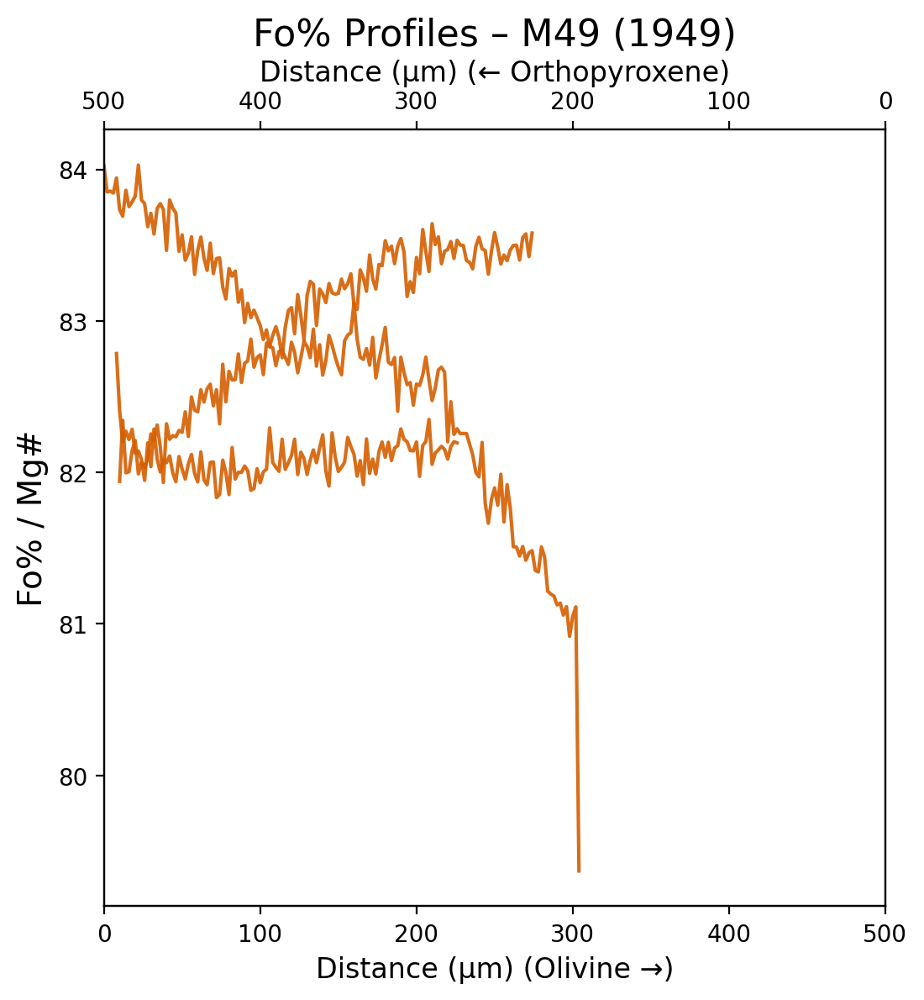

In [46]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import to_rgb
import mineralML as mm
from scipy.ndimage import uniform_filter1d
from matplotlib.lines import Line2D


# Define color and year per eruption
eruption_colors_year = {
    'MP2': ('#CC79A7', '1852'),
    'M85': ('#E69F00', '1855'),
    'MLP': ('#009E73', '1868'),
    'M49': ('#D55E00', '1949'),
    'M58': ('#0072B2', '1950'),
    'M84': ('#56B4E9', '1984'),
    'ML22': ('#F0E442', '2022')
}
eruption_shades = {
    'MP2': {
        'base': '#CC79A7',
        'reverse': '#E8BFD5',
        'complex': '#9F4D7E'
    },
    'M85': {
        'base': '#E69F00',
        'reverse': '#F3C66C',
        'complex': '#B06F00'
    },
    'MLP': {
        'base': '#009E73',
        'reverse': '#5DC9A6',
        'complex': '#006B4F'
    },
    'M49': {
        'base': '#D55E00',
        'reverse': '#F29B5C',
        'complex': '#993F00'
    },
    'M58': {
        'base': '#0072B2',
        'reverse': '#60B1E0',
        'complex': '#004F7D'
    },
    'M84': {
        'base': '#56B4E9',
        'reverse': '#A6D6F4',
        'complex': '#3183B6'
    },
    'ML22': {
        'base': '#F0E442',
        'reverse': '#F7F0AA',
        'complex': '#BBAF33'
    }
}

# Base directory path
base_directory = r"C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2"

# Store Fo% profiles by eruption
fo_profiles_by_eruption = {}

def darken_color(color, amount=0.5):
    r, g, b = to_rgb(color)
    return (r * amount, g * amount, b * amount)
skip_samples = [
            'M84_204_XL2_Line3',
            'MLP_211_XL2_Line3',
            'M58_207_Line3',
            'M58_207_Line4',
            'M58_212_Line2',
            'M58_207_Line1',
            'M49_220_Line2',
            'M84_202_Line1',
            'M84_204_XL2_Line3',
            'M84_206_Line2',
            'M85_224_XL2_Line3',
            'ML22_88_6_Line3',
            'ML22_88_6_Line1', 
            'M49_212_Line2',
            'M49_212_Line4',
            'M49_212_Line7', 
            'M49_214_Line1',
        ]
# Loop through eruption folders
for eruption_folder in os.listdir(base_directory):
    eruption_folder_path = os.path.join(base_directory, eruption_folder)
    if not os.path.isdir(eruption_folder_path):
        continue

    for sample_folder in os.listdir(eruption_folder_path):
        if sample_folder in skip_samples:
            continue            # skip the whole sample – nothing will be read or plotted
    
        sample_folder_path = os.path.join(eruption_folder_path, sample_folder)
        if not os.path.isdir(sample_folder_path):
            continue

        csv_files = [f for f in os.listdir(sample_folder_path) if f.endswith('.csv')]
        if not csv_files:
            continue

        linescan_file_path = os.path.join(sample_folder_path, csv_files[0])
        data = pd.read_csv(linescan_file_path)

        # Rename oxide columns
        rename_dict = {
            'Mg Ox%': 'MgO', 'Si Ox%': 'SiO2', 'Ca Ox%': 'CaO', 'Mn Ox%': 'MnO',
            'Fe Ox%': 'FeOt', 'Ni Ox%': 'NiO', 'Al Ox%': 'Al2O3', 'Ti Ox%': 'TiO2', 'Cr Ox%': 'Cr2O3'
        }
        data.rename(columns=rename_dict, inplace=True)
        data = data.loc[:, ~data.columns.str.contains('^Unnamed')]
        data.dropna(subset=['MgO', 'FeOt'], inplace=True)

        # Classify with mineralML
        data = pt.minClass(data)
        classification = np.where(data['Predict_Probability'] >= 0.7, data['Predict_Mineral'], 'Glass')
        data['MineralType'] = classification

        # Only keep olivine or orthopyroxene rows
        data = data[data['MineralType'].isin(['Olivine', 'Orthopyroxene'])].copy()
        if data.empty:
            continue

        # Group by dominant mineral in this sample
        mineral_label = data['MineralType'].mode().iloc[0]
        mineral_data = data[data['MineralType'] == mineral_label].copy()
        if mineral_data.empty:
            continue

        # Calculate Fo%
        mineral_data['Mg_mol'] = mineral_data['MgO'] / 40.304
        mineral_data['Fe_mol'] = mineral_data['FeOt'] / 71.844
        mineral_data['Fo%'] = 100 * mineral_data['Mg_mol'] / (mineral_data['Mg_mol'] + mineral_data['Fe_mol'])

        # Remove specific bad points
        if sample_folder == 'M49_201_Line1':
            mineral_data = mineral_data[~mineral_data['Distance (µm)'].isin([132, 134])]
        if sample_folder == 'M49_200_Line1':
            bad_distances = [298]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)] 
        if sample_folder == 'M84_212_Line1':
            bad_distances = [96]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]
        if sample_folder == 'M49_220_Line1':
            bad_distances = [176]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]  
        if sample_folder == 'M49_214_Line2':
            bad_distances = [20]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]  
        if sample_folder == 'M49_220_Line2':
            bad_distances = [128,130]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
        if sample_folder == 'M49_220_Line3':
            bad_distances = [0]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
        if sample_folder == 'M49_222_XL2_Line1':
            bad_distances = [122, 60]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
        if sample_folder == 'M49_226_XL2_Line2':
            bad_distances = [64]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
        if sample_folder == 'M49_226_XL2_Line2':
            bad_distances = [56]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
        if sample_folder == 'M58_201_Line1':
            bad_distances = [34]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
        if sample_folder == 'M58_207_Line2':
            bad_distances = [3.1818181818]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
        if sample_folder == 'M58_210_Line1':
            bad_distances = [172]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M58_212_Line1':
            bad_distances = [48, 50, 52]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M58_215_Line1':
            bad_distances = [4]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M58_218_Line1':
            bad_distances = [2]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M58_227_Line1':
            bad_distances = [8]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M58_229_Line1':
            bad_distances = [76, 4]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M58_232_Line1':
            bad_distances = [6]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M58_223_Line1':
            bad_distances = [0]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_202_Line1':
            bad_distances = [12, 32, 24, 26, 38]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_204_Line1':
            bad_distances = [132]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_207_Line1':
            bad_distances = [2]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_210_Line1':
            bad_distances = [255.5, 256, 200.5, 201, 199, 199.5, 200]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_212_Line1':
            bad_distances = [2, 92, 94, 96, 98]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_215_Line1':
            bad_distances = [8]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_216_Line1':
            bad_distances = [1]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_218_Line1':
            bad_distances = [2, 2.00000000000002]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_215_Line1':
            bad_distances = [4, 4.00000000000001]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_215_XL2_Line2':
            bad_distances = [190, 192, 194]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_223_XL2_Line2':
            bad_distances = [214]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_224_XL2_Line2':
            bad_distances = [110]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M84_225_Line1':
            bad_distances = [162]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_225_XL2_Line2':
            bad_distances = [82]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_227_XL2_Line4':
            bad_distances = [2]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_228_Line1':
            bad_distances = [202.4]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M85_228_Line2':
            bad_distances = [2, 84, 80, 82]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'ML22_77_5_Line1':
            bad_distances = [8]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'ML22_88_6_Line2':
            bad_distances = [10]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'ML22_88_6_Line3':
            bad_distances = [108]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'ML22_88_6_XL2_Line4':
            bad_distances = [96]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MLP_206_Line1':
            bad_distances = [8]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MLP_207_Line1':
            bad_distances = [266.894736842105]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MLP_208_Line1':
            bad_distances = [6.5, 7, 7.5]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MLP_211_Line1':
            bad_distances = [4]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MLP_213_Line1':
            bad_distances = [6,8]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MP2_212_Line1':
            bad_distances = [1.15, 1.14999999999999]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MP2_214_Line1':
            bad_distances = [216, 220]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'MP2_218_Line1':
            bad_distances = [180]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

        if sample_folder == 'M58_220_Line1':
            bad_distances = [182, 184, 186]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)] 
        if sample_folder == 'M58_218_Line1':
            bad_distances = [1.99999999999999, 2]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]
        if sample_folder == 'M84_210_Line1':
            bad_distances = [201.5, 202, 202.5, 203, 203.5, 204, 204.5, 205]
            mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)] 
        # if sample_folder == 'MP2_220_Line1':
                    #  bad_distances = [8, 211, 211.5, 212, 212.5, 213, 213.5, 214, 214.5, 215, 215.5, 216, 216.5,217, 240, 242.5, 244, 269, 269.5, 270, 270.5, 271, 271.5, 272, 272.5, 273, 273.5, 274, 274.5, 275, 275.5, 276,276.5, 277, 277.5, 278, 278.5, 279]
                    #  mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]      
        if sample_folder == 'MP2_220_Line1':
                     bad_distances = [8]
                     mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]      
        if sample_folder == 'MP2_220_Line1':
            # Step 1: Define distances you want to smooth over (preserving 8)
            bad_distances = [
                211, 211.5, 212, 212.5, 213, 213.5, 214, 214.5, 215,
                215.5, 216, 216.5, 217, 240, 242.5, 244, 269, 269.5,
                270, 270.5, 271, 271.5, 272, 272.5, 273, 273.5, 274,
                274.5, 275, 275.5, 276, 276.5, 277, 277.5, 278, 278.5, 279
            ]

            # Step 2: Smooth the entire Fo% column
            smoothed_Fo = uniform_filter1d(mineral_data["Fo%"].values, size=8)

            # Step 3: Replace only the Fo% values at bad distances (excluding 8) with smoothed values
            mineral_data = mineral_data.copy()
            for i, row in mineral_data.iterrows():
                dist = row["Distance (µm)"]
                if dist in bad_distances:
                    mineral_data.at[i, "Fo%"] = smoothed_Fo[i]
                
        if sample_folder == 'ML22_27_2_Line1':
                    bad_distances = [284]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]             
         # ── samples whose distance scale must be flipped ──────────────────
        reverse_samples = {
                    'M49_200_Line1',
                    'M49_201_XL2_Line2',
                    'M49_212_XL2_Line3',
                    'M49_212_XL3_Line5',
                    'M49_212_Xl4_Line6',
                    'M49_214_Line2',
                    'M49_220_Line1',
                    'M49_220_Line2',
                    'M49_222_XL2_Line1',
                    'M49_226_XL1_Line1',
                    'M49_226_XL2_Line2',
                    'M49_226_XL3_Line3',
                    'M58_203_Line1',
                    'M58_210_Line1',
                    'M58_216_Line1',
                    'M58_220_Line1',
                    'M58_230_Line1',
                    'M84_202_Line1'
                    'M84_204_Line1',
                    'M84_208_Line1',
                    'M84_210_Line1',
                    'M84_217_Line1',
                    'M85_207_Line1',
                    'M85_215_XL2_Line2',
                    'M85_215_XL3_Line3',
                    'M85_220_XL2_Line2',
                    'M85_220_Xl3_Line3',
                    'M85_223_XL2_Line2',
                    'M85_224_XL2_Line2',
                    'M85_225_Line1',
                    'M85_225_XL2_Line2',
                    'M85_228_Line1',
                    'ML22_27_2_Line1',
                    'ML22_76_1_Line1',
                    'ML22_88_5_Line1',
                    'ML22_88_6_Line3',
                    'ML22_88_6_XL2_Line4',
                    'ML22_88_6_XL3_Line5',
                    'MLP_207_Line1',
                    'MLP_211_XL2_Line2',
                    'MP2_214_Line1',
                    'MP2_218_Line1'
                }

                # ── reverse the distance scale if this sample is in the set ───────
        if sample_folder in reverse_samples:
                    d_max = mineral_data['Distance (µm)'].max()
                    mineral_data['Distance (µm)'] = d_max - mineral_data['Distance (µm)']
                    mineral_data.sort_values('Distance (µm)', inplace=True)             
        # Store raw profile (no interpolation)
        fo_profiles_by_eruption.setdefault(eruption_folder, []).append({
            'sample': sample_folder,
            'eruption': eruption_folder,
            'mineral': mineral_label,
            'distance': mineral_data['Distance (µm)'].values,
            'fo': mineral_data['Fo%'].values
        })

# Plot mirrored Fo% profiles with fixed 0–500 µm x‑axis
for eruption, profiles in fo_profiles_by_eruption.items():
    color, year = eruption_colors_year.get(eruption, ('gray', 'unknown'))

    fig, ax = plt.subplots(figsize=(6, 6), dpi=200)
    ax2 = ax.twiny()  # mirrored x-axis for Opx

    ax.set_title(f"Fo% Profiles – {eruption} ({year})", fontsize=16)

    for p in profiles:
        x = p['distance']
        y = p['fo']
        label = f"{p['mineral']}: {p['sample']}"

        if p['mineral'] == 'Olivine':
            ax.plot(x, y, label=label, color=color, alpha=0.9, linewidth=1.5)
        elif p['mineral'] == 'Orthopyroxene':
            darker_color = darken_color(color, amount=0.5)
            ax2.plot(x, y, label=label, color=darker_color, linestyle='-', alpha=0.9, linewidth=1.5)
    # Fixed axes 0–500 µm
    ax.set_xlim(0, 500)
    ax2.set_xlim(500, 0)  # mirrored

    ax.set_xlabel("Distance (µm) (Olivine →)", fontsize=12)
    ax2.set_xlabel("Distance (µm) (← Orthopyroxene)", fontsize=12)
    ax.set_ylabel("Fo% / Mg#", fontsize=14)
     # -------- legend with two proxy handles ---------------------------
    oliv_proxy = Line2D([], [], color=color,        lw=2, label='Olivine')
    opx_proxy  = Line2D([], [], color=darker_color, lw=2, label='Orthopyroxene')
    ax.legend([oliv_proxy, opx_proxy],
            ['Olivine', 'Orthopyroxene'],
            fontsize=8)

    # Combine legends
    handles1, labels1 = ax.get_legend_handles_labels()
    handles2, labels2 = ax2.get_legend_handles_labels()
    # ax.legend(handles1 + handles2, labels1 + labels2, fontsize=8, title="Profiles")

    ax.grid(True)
    plt.tight_layout()
    plt.show()


Processing folder: M49
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\M49\M49_204_Line1
  Working on sample folder: M49_204_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.952235
1   Clinopyroxene             0.947257
2   Clinopyroxene             0.960427
3   Clinopyroxene             0.859971
4   Orthopyroxene             0.536582
Predict_Mineral
Olivine          133
Clinopyroxene      4
Orthopyroxene      1
Name: count, dtype: int64


C:\Users\alex7\AppData\Local\Temp\ipykernel_9352\644654897.py:439: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


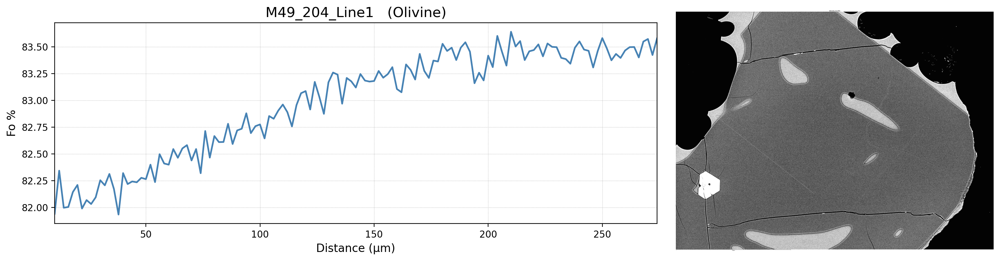

  Finished processing sample: M49_204_Line1
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\M49\M49_207_Line1
  Working on sample folder: M49_207_Line1
  Predict_Mineral  Predict_Probability
0         Olivine             0.977706
1         Olivine             0.978332
2         Olivine             0.978708
3         Olivine             0.978954
4         Olivine             0.978528
Predict_Mineral
Olivine          153
Clinopyroxene      1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)
C:\Users\alex7\AppData\Local\T

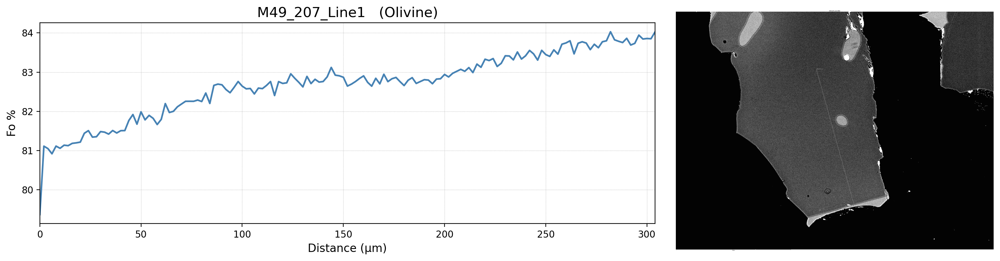

  Finished processing sample: M49_207_Line1
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\M49\M49_219_Line1
  Working on sample folder: M49_219_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.948723
1   Clinopyroxene             0.951528
2   Clinopyroxene             0.957095
3   Clinopyroxene             0.589525
4         Olivine             0.967903
Predict_Mineral
Olivine          110
Clinopyroxene      4
Name: count, dtype: int64


C:\Users\alex7\AppData\Local\Temp\ipykernel_9352\644654897.py:439: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


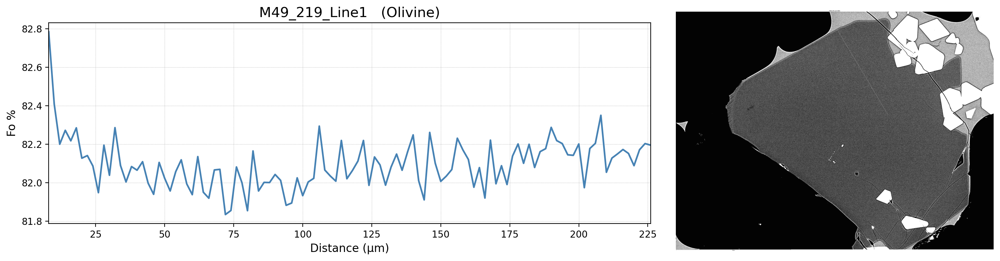

  Finished processing sample: M49_219_Line1
Processing folder: M58
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\M58\M58_200_Line3
  Working on sample folder: M58_200_Line3


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0       Amphibole             0.913847
1       Amphibole             0.892890
2       Amphibole             0.883184
3       Amphibole             0.866755
4       Amphibole             0.877686
Predict_Mineral
Orthopyroxene    207
Amphibole          7
Name: count, dtype: int64


C:\Users\alex7\AppData\Local\Temp\ipykernel_9352\644654897.py:439: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


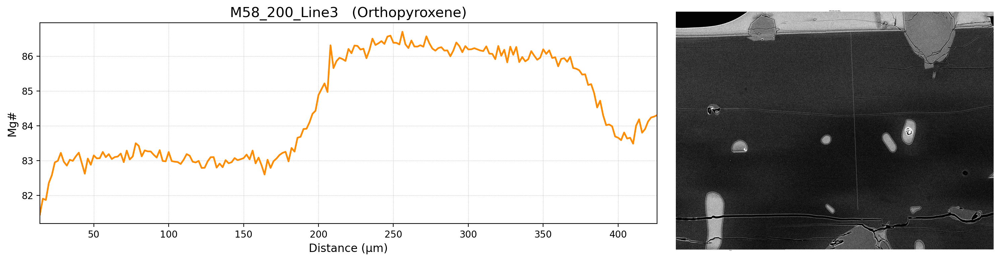

  Finished processing sample: M58_200_Line3
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\M58\M58_200_XL2_Line2
  Working on sample folder: M58_200_XL2_Line2


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0       Amphibole             0.872477
1       Amphibole             0.865454
2       Amphibole             0.863230
3       Amphibole             0.834606
4       Amphibole             0.858269
Predict_Mineral
Clinopyroxene    117
Amphibole          8
Name: count, dtype: int64
  Unknown mineral type 'Clinopyroxene' for M58_200_XL2_Line2, skipping.
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\M58\M58_200_XL3_Line2
  Working on sample folder: M58_200_XL3_Line2


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.995224
1   Clinopyroxene             0.994837
2   Clinopyroxene             0.995074
3   Clinopyroxene             0.995101
4   Clinopyroxene             0.994580
Predict_Mineral
Clinopyroxene    49
Amphibole        10
Name: count, dtype: int64
  Unknown mineral type 'Clinopyroxene' for M58_200_XL3_Line2, skipping.
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\M58\M58_203_Line1
  Working on sample folder: M58_203_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.944586
1   Clinopyroxene             0.945935
2   Clinopyroxene             0.940960
3   Clinopyroxene             0.731370
4         Olivine             0.986123
Predict_Mineral
Olivine          319
Clinopyroxene      4
Name: count, dtype: int64


C:\Users\alex7\AppData\Local\Temp\ipykernel_9352\644654897.py:439: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


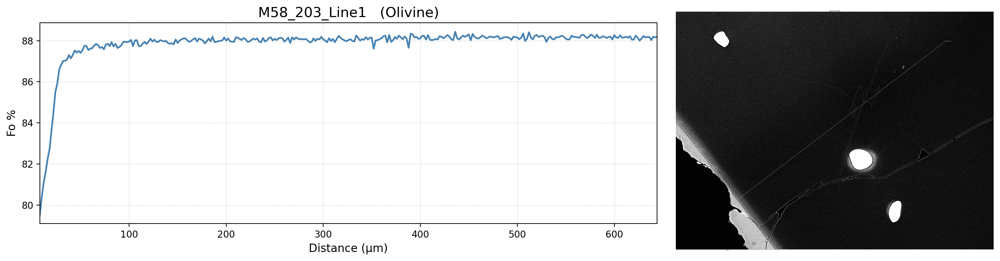

  Finished processing sample: M58_203_Line1
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\M58\M58_208_Line1
  Working on sample folder: M58_208_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0         Olivine             0.985296
1         Olivine             0.984770
2         Olivine             0.985187
3         Olivine             0.984948
4         Olivine             0.984468
Predict_Mineral
Olivine          289
Clinopyroxene      8
Name: count, dtype: int64


C:\Users\alex7\AppData\Local\Temp\ipykernel_9352\644654897.py:439: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


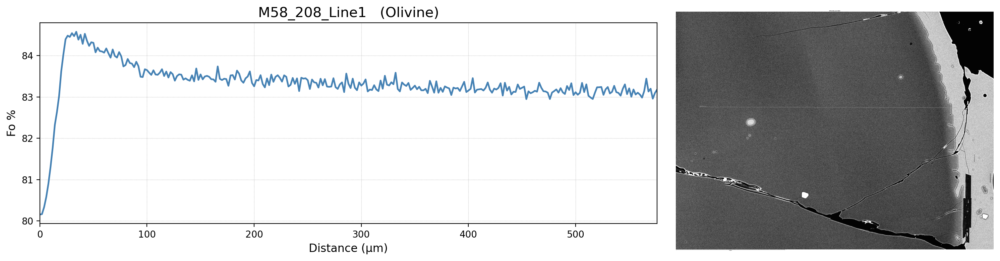

  Finished processing sample: M58_208_Line1
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\M58\M58_213_Line1
  Working on sample folder: M58_213_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.929563
1   Clinopyroxene             0.947815
2   Clinopyroxene             0.948066
3   Clinopyroxene             0.949455
4   Clinopyroxene             0.920538
Predict_Mineral
Olivine          249
Clinopyroxene      5
Name: count, dtype: int64


C:\Users\alex7\AppData\Local\Temp\ipykernel_9352\644654897.py:439: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


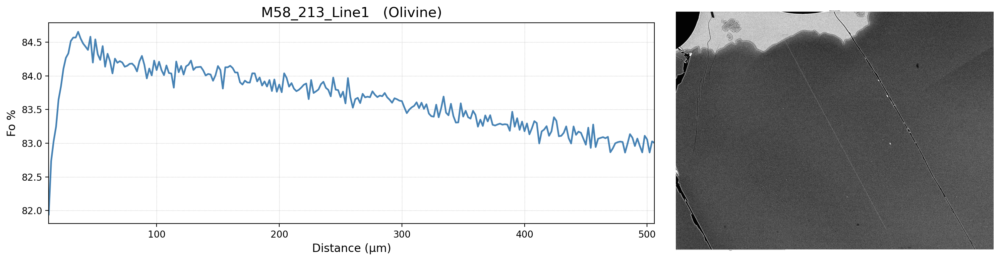

  Finished processing sample: M58_213_Line1
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\M58\M58_214_Line1
  Working on sample folder: M58_214_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.944370
1   Clinopyroxene             0.939715
2   Clinopyroxene             0.933343
3   Clinopyroxene             0.645625
4         Olivine             0.930106
Predict_Mineral
Olivine          146
Clinopyroxene      4
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)
C:\Users\alex7\AppData\Local\T

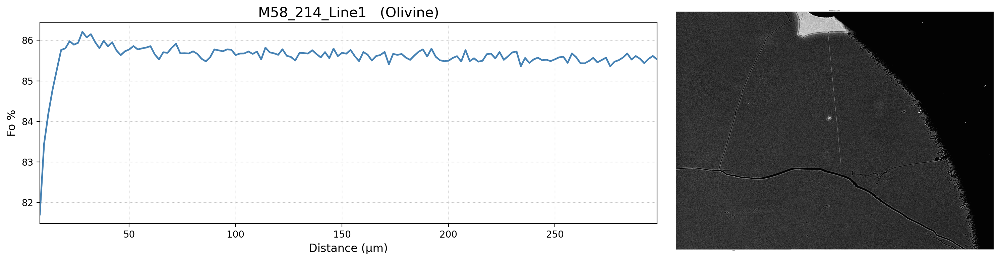

  Finished processing sample: M58_214_Line1
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\M58\M58_217_Line1
  Working on sample folder: M58_217_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.949863
1   Clinopyroxene             0.955790
2   Clinopyroxene             0.946734
3   Clinopyroxene             0.940192
4   Clinopyroxene             0.800262
Predict_Mineral
Orthopyroxene    263
Clinopyroxene      5
Name: count, dtype: int64


C:\Users\alex7\AppData\Local\Temp\ipykernel_9352\644654897.py:439: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


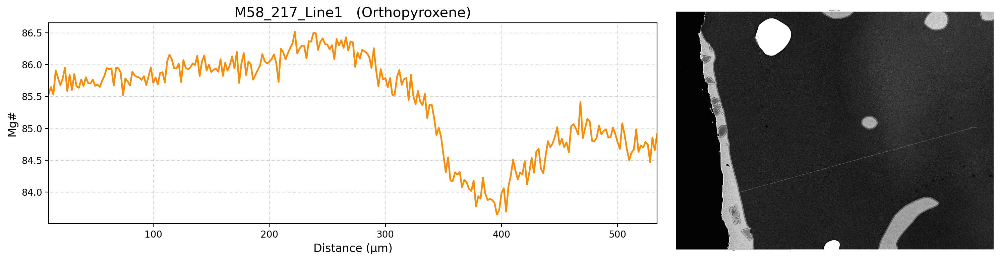

  Finished processing sample: M58_217_Line1
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\M58\M58_220_Line1
  Working on sample folder: M58_220_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.969636
1   Orthopyroxene             0.970935
2   Orthopyroxene             0.970170
3   Orthopyroxene             0.969845
4   Orthopyroxene             0.969520
Predict_Mineral
Orthopyroxene    181
Clinopyroxene      6
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)
C:\Users\alex7\AppData\Local\T

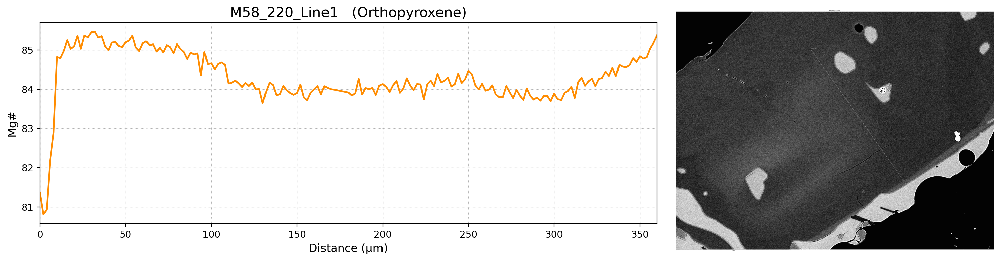

  Finished processing sample: M58_220_Line1
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\M58\M58_223_Line1
  Working on sample folder: M58_223_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.951458
1   Clinopyroxene             0.957322
2   Clinopyroxene             0.963316
3   Clinopyroxene             0.960394
4   Clinopyroxene             0.971344
Predict_Mineral
Orthopyroxene    165
Clinopyroxene      6
Name: count, dtype: int64


C:\Users\alex7\AppData\Local\Temp\ipykernel_9352\644654897.py:439: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


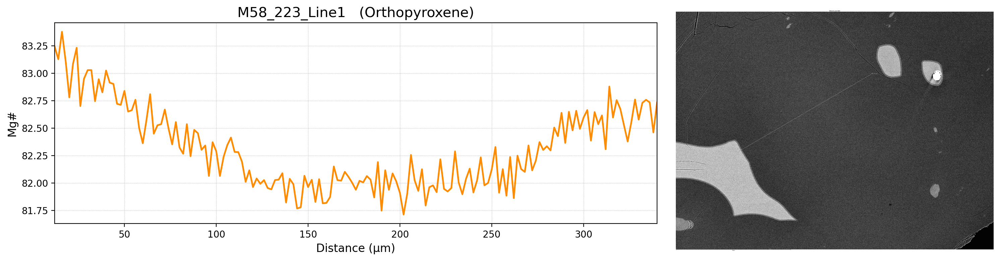

  Finished processing sample: M58_223_Line1
Processing folder: M84
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\M84\M84_203_Line1
  Working on sample folder: M84_203_Line1
  Predict_Mineral  Predict_Probability
0   Orthopyroxene             0.978075
1   Orthopyroxene             0.977029
2   Orthopyroxene             0.977605
3   Orthopyroxene             0.977323
4   Orthopyroxene             0.978520
Predict_Mineral
Orthopyroxene    98
Clinopyroxene     8
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)
C:\Users\alex7\AppData\Local\T

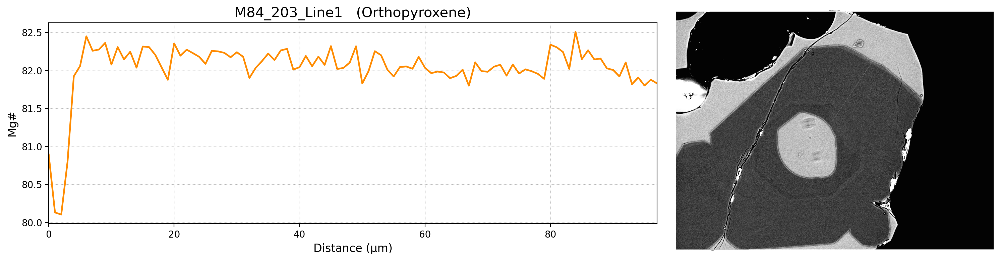

  Finished processing sample: M84_203_Line1
Processing folder: M85
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\M85\M85_201_Line1
  Working on sample folder: M85_201_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0         Olivine             0.980351
1         Olivine             0.980291
2         Olivine             0.980419
3         Olivine             0.980462
4         Olivine             0.980287
Predict_Mineral
Olivine          173
Clinopyroxene      4
Name: count, dtype: int64


C:\Users\alex7\AppData\Local\Temp\ipykernel_9352\644654897.py:439: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


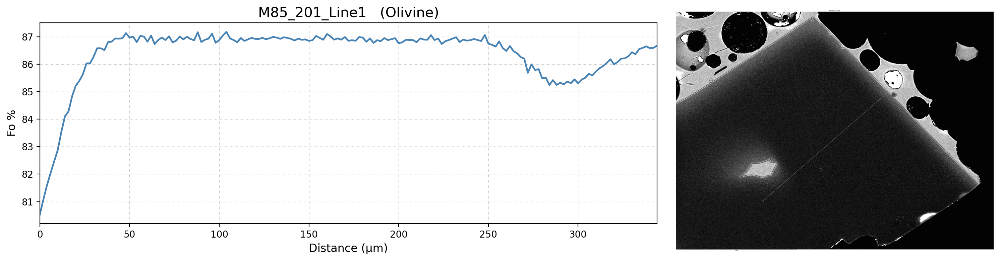

  Finished processing sample: M85_201_Line1
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\M85\M85_217_Olv_Line2
  Working on sample folder: M85_217_Olv_Line2


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0       Amphibole             0.926828
1       Amphibole             0.925349
2       Amphibole             0.926504
3       Amphibole             0.930604
4       Amphibole             0.923984
Predict_Mineral
Olivine          247
Amphibole         19
Orthopyroxene      2
Name: count, dtype: int64


C:\Users\alex7\AppData\Local\Temp\ipykernel_9352\644654897.py:439: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


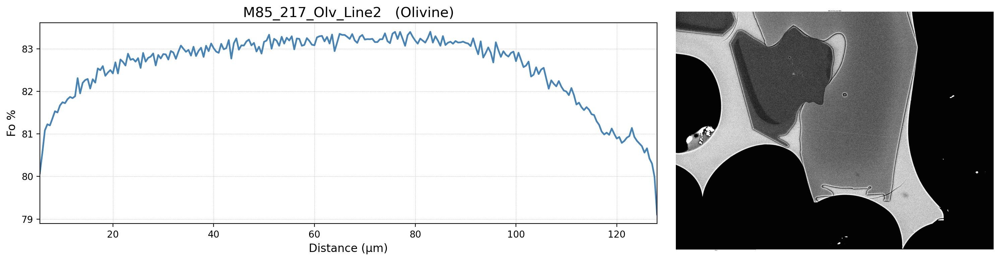

  Finished processing sample: M85_217_Olv_Line2
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\M85\M85_217_Opx_Line3
  Working on sample folder: M85_217_Opx_Line3
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.928963
1   Clinopyroxene             0.928744
2   Clinopyroxene             0.920499
3   Clinopyroxene             0.924949
4   Clinopyroxene             0.925471
Predict_Mineral
Orthopyroxene    242
Clinopyroxene     25
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)
C:\Users\alex7\AppData\Local\T

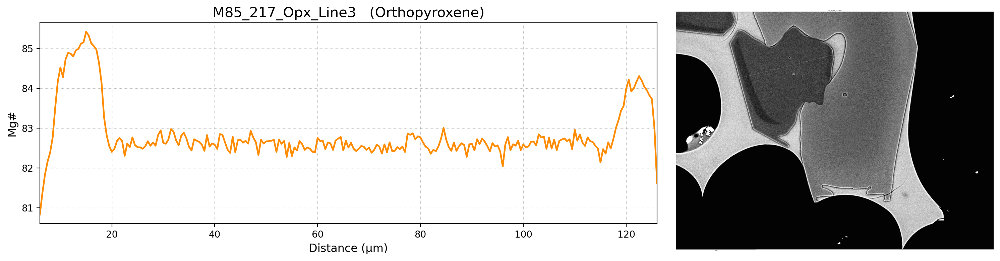

  Finished processing sample: M85_217_Opx_Line3
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\M85\M85_219_Line1
  Working on sample folder: M85_219_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.909936
1   Clinopyroxene             0.785968
2   Orthopyroxene             0.806335
3   Orthopyroxene             0.966263
4   Orthopyroxene             0.966907
Predict_Mineral
Orthopyroxene    162
Clinopyroxene      2
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)
C:\Users\alex7\AppData\Local\T

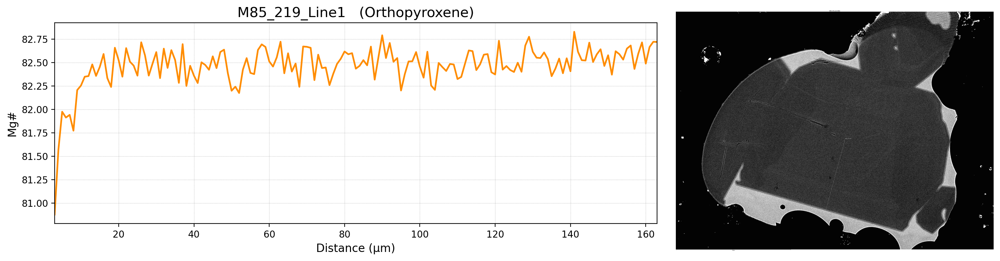

  Finished processing sample: M85_219_Line1
Processing folder: ML22
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\ML22\ML22_16_Line1
  Working on sample folder: ML22_16_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.927141
1   Clinopyroxene             0.898476
2         Olivine             0.882919
3         Olivine             0.982400
4         Olivine             0.984691
Predict_Mineral
Olivine          194
Clinopyroxene      2
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)
C:\Users\alex7\AppData\Local\T

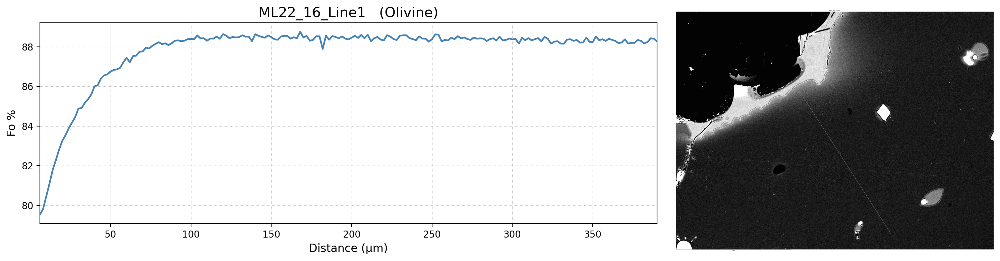

  Finished processing sample: ML22_16_Line1
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\ML22\ML22_77_1_Line1
  Working on sample folder: ML22_77_1_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0         Olivine             0.985285
1         Olivine             0.985599
2         Olivine             0.985880
3         Olivine             0.984780
4         Olivine             0.985273
Predict_Mineral
Olivine          169
Clinopyroxene      6
Orthopyroxene      4
Name: count, dtype: int64


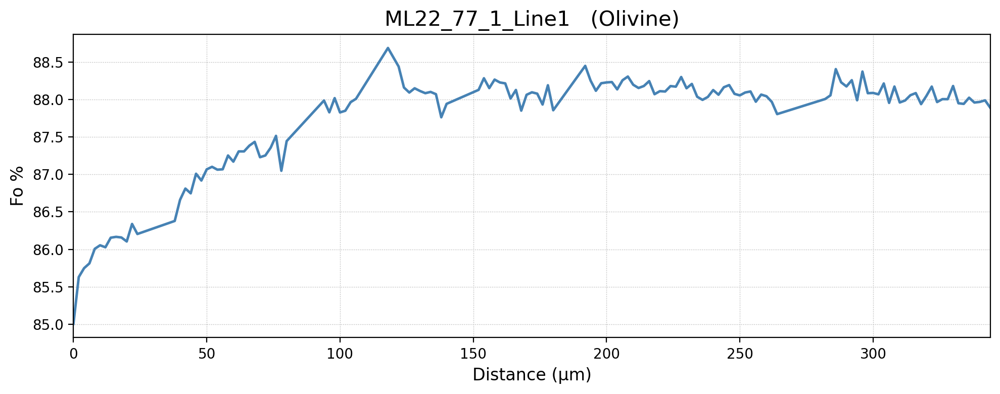

  Finished processing sample: ML22_77_1_Line1
Processing folder: MLP
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\MLP\MLP_16_Line1
  Working on sample folder: MLP_16_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.933406
1   Clinopyroxene             0.927771
2   Clinopyroxene             0.925810
3   Orthopyroxene             0.953582
4         Olivine             0.963113
Predict_Mineral
Olivine          200
Clinopyroxene      3
Orthopyroxene      1
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)
C:\Users\alex7\AppData\Local\T

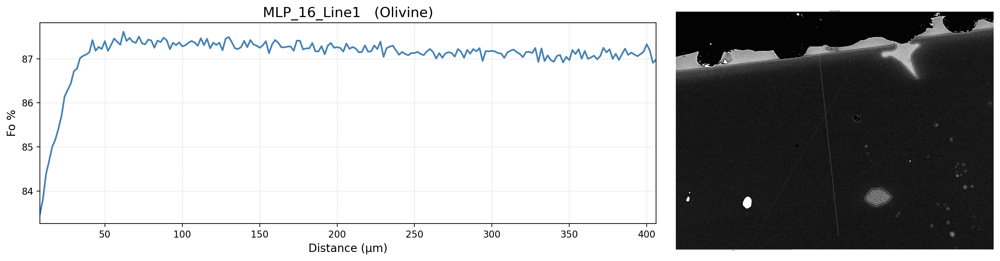

  Finished processing sample: MLP_16_Line1
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\MLP\MLP_200_Line1
  Working on sample folder: MLP_200_Line1
  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.958418
1   Clinopyroxene             0.942564
2         Olivine             0.966978
3         Olivine             0.980802
4         Olivine             0.981540
Predict_Mineral
Olivine          264
Clinopyroxene      2
Name: count, dtype: int64


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)
C:\Users\alex7\AppData\Local\T

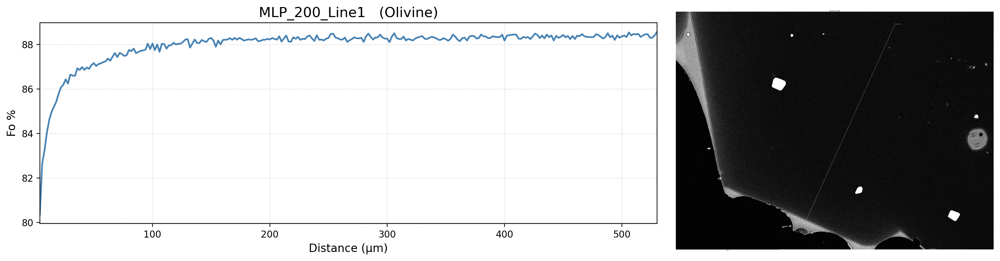

  Finished processing sample: MLP_200_Line1
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\MLP\MLP_204_Line1
  Working on sample folder: MLP_204_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0         Olivine             0.969158
1         Olivine             0.969420
2         Olivine             0.969434
3         Olivine             0.968748
4         Olivine             0.968445
Predict_Mineral
Olivine          234
Clinopyroxene      3
Name: count, dtype: int64


C:\Users\alex7\AppData\Local\Temp\ipykernel_9352\644654897.py:439: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


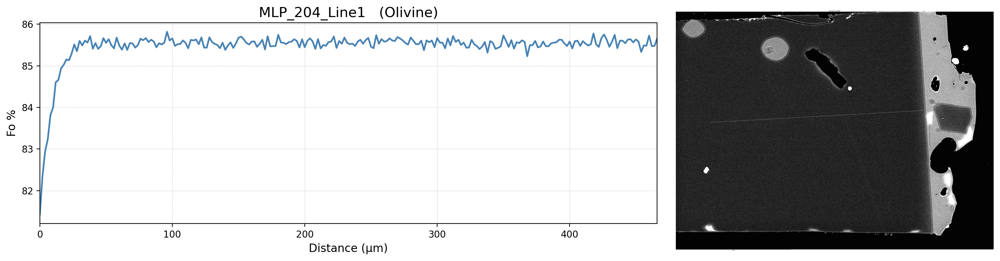

  Finished processing sample: MLP_204_Line1
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\MLP\MLP_204_XL2_Line2
  Working on sample folder: MLP_204_XL2_Line2


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0         Olivine             0.989000
1         Olivine             0.988625
2         Olivine             0.988463
3         Olivine             0.988818
4         Olivine             0.988765
Predict_Mineral
Olivine          58
Clinopyroxene    16
Orthopyroxene     1
Name: count, dtype: int64


C:\Users\alex7\AppData\Local\Temp\ipykernel_9352\644654897.py:439: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


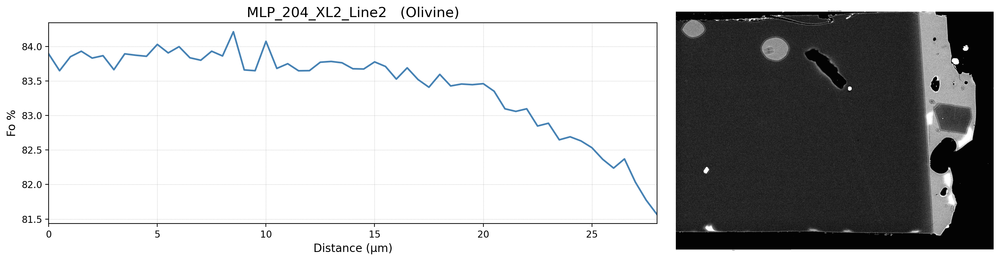

  Finished processing sample: MLP_204_XL2_Line2
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\MLP\MLP_217_Line1
  Working on sample folder: MLP_217_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.952069
1   Clinopyroxene             0.941765
2   Clinopyroxene             0.939302
3   Clinopyroxene             0.955350
4   Clinopyroxene             0.947409
Predict_Mineral
Olivine          147
Clinopyroxene      9
Orthopyroxene      1
Name: count, dtype: int64


C:\Users\alex7\AppData\Local\Temp\ipykernel_9352\644654897.py:439: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


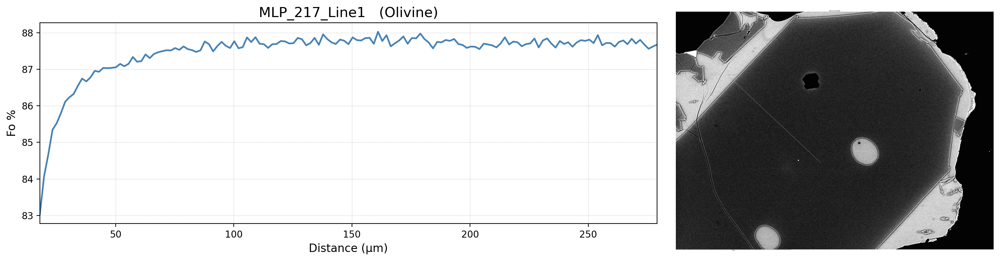

  Finished processing sample: MLP_217_Line1
Processing folder: MP2
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\MP2\MP2_201_Line1
  Working on sample folder: MP2_201_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.959276
1   Clinopyroxene             0.950577
2   Clinopyroxene             0.956407
3   Clinopyroxene             0.930022
4         Olivine             0.964484
Predict_Mineral
Olivine          197
Clinopyroxene      4
Name: count, dtype: int64


C:\Users\alex7\AppData\Local\Temp\ipykernel_9352\644654897.py:439: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


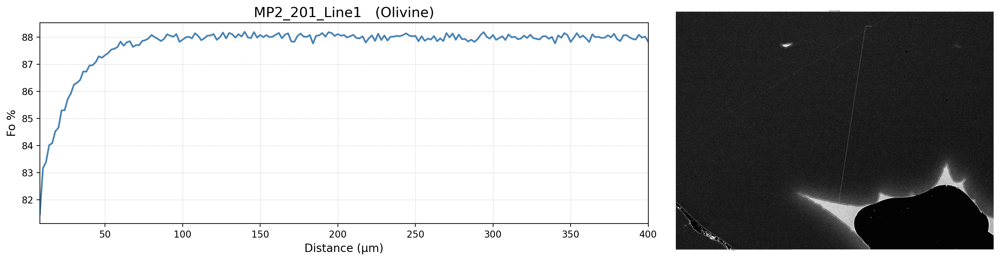

  Finished processing sample: MP2_201_Line1
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\MP2\MP2_201_Line2
  Working on sample folder: MP2_201_Line2


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0         Olivine             0.984590
1         Olivine             0.984174
2         Olivine             0.985076
3         Olivine             0.984352
4         Olivine             0.983972
Predict_Mineral
Olivine          247
Clinopyroxene      7
Name: count, dtype: int64


C:\Users\alex7\AppData\Local\Temp\ipykernel_9352\644654897.py:439: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


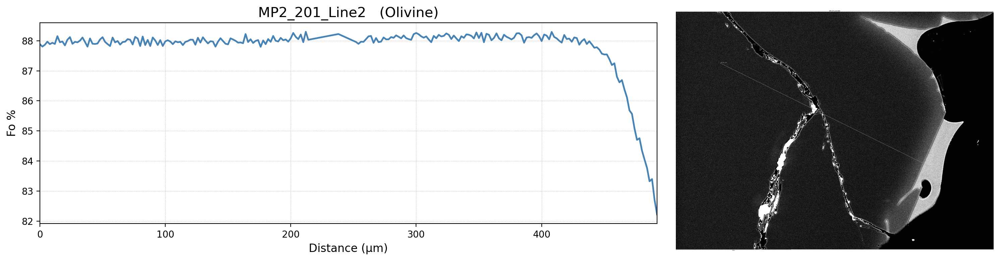

  Finished processing sample: MP2_201_Line2
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\MP2\MP2_203_Line1
  Working on sample folder: MP2_203_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.926237
1   Clinopyroxene             0.932106
2   Clinopyroxene             0.919936
3   Clinopyroxene             0.906938
4         Olivine             0.939098
Predict_Mineral
Olivine          235
Clinopyroxene      4
Name: count, dtype: int64


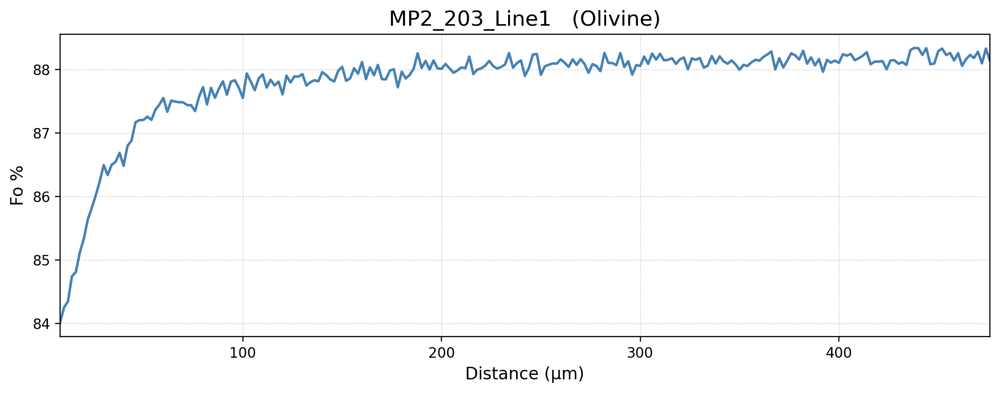

  Finished processing sample: MP2_203_Line1
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\MP2\MP2_215_Line1
  Working on sample folder: MP2_215_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0   Clinopyroxene             0.925381
1   Clinopyroxene             0.928344
2   Clinopyroxene             0.919814
3   Clinopyroxene             0.852982
4         Olivine             0.940745
Predict_Mineral
Olivine          144
Clinopyroxene      4
Name: count, dtype: int64


C:\Users\alex7\AppData\Local\Temp\ipykernel_9352\644654897.py:439: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


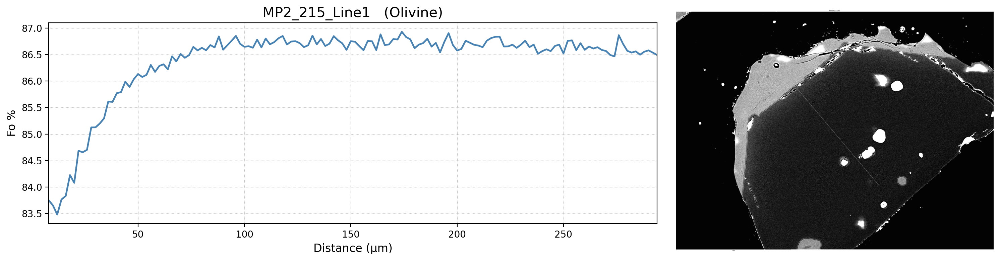

  Finished processing sample: MP2_215_Line1
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\MP2\MP2_217_Line1
  Working on sample folder: MP2_217_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0         Olivine             0.982930
1         Olivine             0.982955
2         Olivine             0.982258
3         Olivine             0.982404
4         Olivine             0.982596
Predict_Mineral
Olivine          247
Clinopyroxene      9
Orthopyroxene      1
Name: count, dtype: int64


C:\Users\alex7\AppData\Local\Temp\ipykernel_9352\644654897.py:439: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


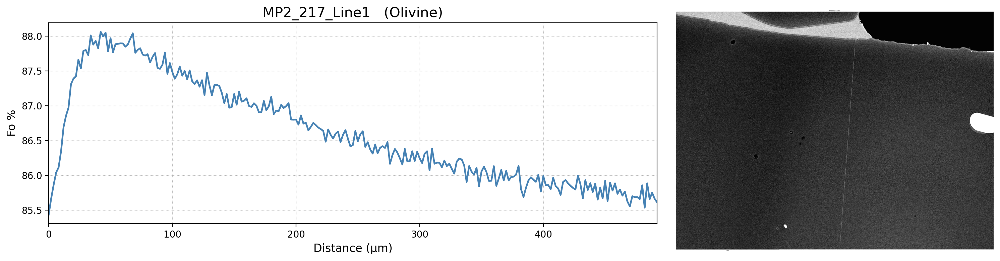

  Finished processing sample: MP2_217_Line1
    Found: C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2\MP2\MP2_221_Line1
  Working on sample folder: MP2_221_Line1


c:\Users\alex7\anaconda3\Lib\site-packages\mineralML\core.py:285: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  check_point = torch.load(path)


  Predict_Mineral  Predict_Probability
0         Olivine             0.985133
1         Olivine             0.984786
2         Olivine             0.984396
3         Olivine             0.984704
4         Olivine             0.984541
Predict_Mineral
Olivine          119
Clinopyroxene      5
Name: count, dtype: int64


C:\Users\alex7\AppData\Local\Temp\ipykernel_9352\644654897.py:439: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


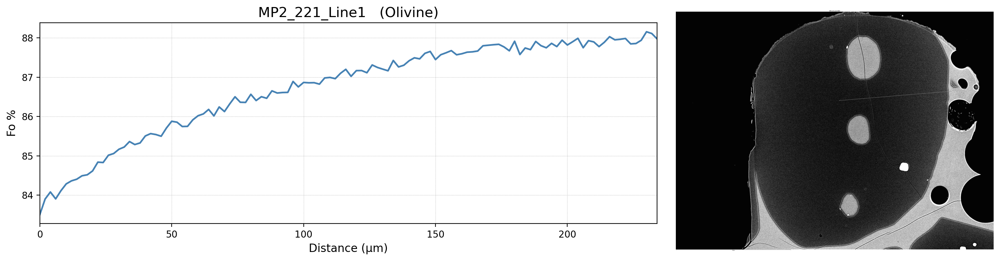

  Finished processing sample: MP2_221_Line1


In [ ]:
base_directory = r"C:\Users\alex7\Documents\UC Berkeley\Thesis Research\MaunaLoa_MeltInclusions\SEM\EDS_Linescans\Linescans2"
fo_profiles = []
for eruption_folder in os.listdir(base_directory):
        eruption_folder_path = os.path.join(base_directory, eruption_folder)
        if os.path.isdir(eruption_folder_path):
            print(f"Processing folder: {eruption_folder}")
            for sample_folder in os.listdir(eruption_folder_path):
                sample_folder_path = os.path.join(eruption_folder_path, sample_folder)
                print(f"    Found: {sample_folder_path}")  # NEW DEBUG LINE
                if not os.path.isdir(sample_folder_path):
                    print(f"    Skipping (not a dir): {sample_folder_path}")
                    continue
                
                # If it's a directory, proceed with the sample
                if not os.path.isdir(sample_folder_path):
                    continue
                print(f"  Working on sample folder: {sample_folder}")
                # Get all CSV files in the folder
                csv_files = [f for f in os.listdir(sample_folder_path) if f.endswith('.csv')]
                if not csv_files:
                    print(f"    No CSV found in {sample_folder_path}")
                    continue
                        # Load the first CSV file (assuming only one file per sample)
                linescan_file = csv_files[0]
                linescan_file_path = os.path.join(sample_folder_path, linescan_file)
                    
                # Read in the CSV data
                data = pd.read_csv(linescan_file_path)

                # Step 1: Rename the oxide columns
                rename_dict = {
                    'Mg Ox%': 'MgO',
                    'Si Ox%': 'SiO2',
                    'Ca Ox%': 'CaO',
                    'Mn Ox%': 'MnO',
                    'Fe Ox%': 'FeOt',
                    'Ni Ox%': 'NiO',
                    'Al Ox%': 'Al2O3',
                    'Ti Ox%': 'TiO2',
                    'Cr Ox%': 'Cr2O3'
                }
                data.rename(columns=rename_dict, inplace=True)

                # Step 2: Use pt.minClass to classify the points and add 'Predict_Mineral' and 'Predict_Probability'
                data = pt.minClass(data)  # Assuming pt.minClass() adds these columns
                print(data[['Predict_Mineral', 'Predict_Probability']].head())
                print(data['Predict_Mineral'].value_counts())
                # Step 3: Classify each spot based on Predict_Mineral and Predict_Probability
                classification = np.where(
                    (data['Predict_Probability'] >= 0.9),
                    data['Predict_Mineral'],
                    'Glass'
                )
                data['MineralType'] = classification
                # Step 4: Identify transitions (change in mineral type)
                # Identify transitions: first row where MineralType changes
                data['PrevType'] = data['MineralType'].shift(1)
                transition_mask = data['MineralType'] != data['PrevType']
                transition_mask.iloc[0] = False
                transitions_df = data[transition_mask].copy()

                # 🔴 Filter out any transitions *into* Glass
                transitions_df = transitions_df[transitions_df['MineralType'] != 'Glass']
            
                
                # Step 4: Filter for plotting — only Olivine and Orthopyroxene
                allowed_minerals = ['Olivine', 'Orthopyroxene']
                mineral_data = data[data['MineralType'].isin(allowed_minerals)].copy()
                # Group by dominant mineral in this sample
                mineral_label = data['MineralType'].mode().iloc[0]
                mineral_data = data[data['MineralType'] == mineral_label].copy()
                
                # STEP X: Calculate Mg# and Fo% for olivine-only samples
                if mineral_label == 'Olivine':
                    mineral_data['Mg_mol'] = mineral_data['MgO'] / 40.304
                    mineral_data['Fe_mol'] = mineral_data['FeOt'] / 71.844
                    mineral_data['Fo%'] = 100 * mineral_data['Mg_mol'] / (mineral_data['Mg_mol'] + mineral_data['Fe_mol'])
                if mineral_label == 'Orthopyroxene':
                    mineral_data['Mg_mol'] = mineral_data['MgO'] / 40.304
                    mineral_data['Fe_mol'] = mineral_data['FeOt'] / 71.844
                    mineral_data['Mg#'] = 100 * mineral_data['Mg_mol'] / (mineral_data['Mg_mol'] + mineral_data['Fe_mol'])   
                    
                    
                        # Remove specific bad points
                if sample_folder == 'M49_201_Line1':
                    mineral_data = mineral_data[~mineral_data['Distance (µm)'].isin([132, 134])]
                if sample_folder == 'M49_200_Line1':
                    bad_distances = [298]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)] 
                if sample_folder == 'M84_212_Line1':
                    bad_distances = [96]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]
                if sample_folder == 'M49_220_Line1':
                    bad_distances = [176]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]  
                if sample_folder == 'M49_214_Line2':
                    bad_distances = [20]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]  
                if sample_folder == 'M49_220_Line2':
                    bad_distances = [128,130]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M49_220_Line3':
                    bad_distances = [0]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M49_222_XL2_Line1':
                    bad_distances = [122, 60]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M49_226_XL2_Line2':
                    bad_distances = [64]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M49_226_XL2_Line2':
                    bad_distances = [56]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M58_201_Line1':
                    bad_distances = [34]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M58_207_Line2':
                    bad_distances = [3.1818181818]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]   
                if sample_folder == 'M58_210_Line1':
                    bad_distances = [172]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_212_Line1':
                    bad_distances = [48, 50, 52]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_215_Line1':
                    bad_distances = [4]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_218_Line1':
                    bad_distances = [2]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_227_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_229_Line1':
                    bad_distances = [76, 4]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_232_Line1':
                    bad_distances = [6]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M58_223_Line1':
                    bad_distances = [0]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_202_Line1':
                    bad_distances = [12, 32, 24, 26, 38]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_204_Line1':
                    bad_distances = [132]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_207_Line1':
                    bad_distances = [2]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_210_Line1':
                    bad_distances = [255.5, 256, 200.5, 201, 199, 199.5, 200]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_212_Line1':
                    bad_distances = [2, 92, 94, 96, 98]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_215_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_216_Line1':
                    bad_distances = [1]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_218_Line1':
                    bad_distances = [2, 2.00000000000002]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_215_Line1':
                    bad_distances = [4, 4.00000000000001]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_215_XL2_Line2':
                    bad_distances = [190, 192, 194]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_223_XL2_Line2':
                    bad_distances = [214]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_224_XL2_Line2':
                    bad_distances = [110]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M84_225_Line1':
                    bad_distances = [162]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_225_XL2_Line2':
                    bad_distances = [82]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_227_XL2_Line4':
                    bad_distances = [2]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_228_Line1':
                    bad_distances = [202.4]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'M85_228_Line2':
                    bad_distances = [2, 84, 80, 82]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'ML22_77_5_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'ML22_88_6_Line2':
                    bad_distances = [10]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'ML22_88_6_Line3':
                    bad_distances = [108]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'ML22_88_6_XL2_Line4':
                    bad_distances = [96]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_206_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_207_Line1':
                    bad_distances = [266.894736842105]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_208_Line1':
                    bad_distances = [6.5, 7, 7.5]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_211_Line1':
                    bad_distances = [4]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MLP_213_Line1':
                    bad_distances = [6,8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MP2_212_Line1':
                    bad_distances = [1.15, 1.14999999999999]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MP2_214_Line1':
                    bad_distances = [216, 220]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MP2_218_Line1':
                    bad_distances = [180]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]

                if sample_folder == 'MP2_220_Line1':
                    bad_distances = [8]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]
                if sample_folder == 'M58_220_Line1':
                    bad_distances = [182, 184, 186]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)] 
                if sample_folder == 'M58_218_Line1':
                    bad_distances = [1.99999999999999, 2]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]
                if sample_folder == 'M84_210_Line1':
                    bad_distances = [201.5, 202, 202.5, 203, 203.5, 204, 204.5, 205]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]  
                if sample_folder == 'MP2_220_Line1':
                    bad_distances = [212.5, 213, 213.5, 214,214.5, 215, 215.5, 216, 216.5, 272, 272.5, 273, 273.5, 274, 274.5, 275, 275.5, 276,276.5, 277, 277.5, 278, 278.5, 279]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]  
                         
                if sample_folder == 'ML22_27_2_Line1':
                    bad_distances = [284]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)] 
                if sample_folder == 'ML22_77_1_Line1':
                    bad_distances = [64, 66, 68, 70, 72, 74, 76,78, 156, 154, 158, 160, 162, 194, 196, 198, 200, 202, 224, 228, 230, 232, 234, 236, 252, 254, 256, 258, 260, 262]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)] 
                if sample_folder == 'MP2_201_Line2':
                    bad_distances = [216, 218, 220, 222, 224, 226, 228, 230, 232, 234, 236, 240, 242, 244, 246, 248, 250]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]                      
                if sample_folder == 'MP2_221_Line1':
                    bad_distances = [64]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]                      
                if sample_folder == 'M84_203_Line1':
                    bad_distances = [98, 99, 100, 101, 102, 103, 104, 105]
                    mineral_data = mineral_data[~mineral_data["Distance (µm)"].isin(bad_distances)]                      
                            
                # ── samples whose distance scale must be flipped ──────────────────
                reverse_samples = {
                    'M49_200_Line1',
                    'M49_207_Line1',
                    'M49_201_XL2_Line2',
                    'M49_212_XL2_Line3',
                    'M49_212_XL3_Line5',
                    'M49_212_Xl4_Line6',
                    'M49_214_Line2',
                    'M49_220_Line1',
                    'M49_220_Line2',
                    'M49_222_XL2_Line1',
                    'M49_226_XL1_Line1',
                    'M49_226_XL2_Line2',
                    'M59_226_XL3_Line3',
                    #'M58_203_Line1',
                    'M58_208_Line1',
                    'M84_203_Line1',
                    'M58_210_Line1',
                    'M58_216_Line1',
                    'M58_220_Line1',
                    'M58_230_Line1',
                    'M84_202_Line1',
                    'M84_204_Line1',
                    'M84_208_Line1',
                    'M84_210_Line1',
                    'M84_217_Line1',
                    'M85_201_Line1',
                    'M85_207_Line1',
                    'M85_215_XL2_Line2',
                    'M85_215_XL3_Line3',
                    'M85_220_XL2_Line2',
                    'M85_220_Xl3_Line3',
                    'M85_223_XL2_Line2',
                    'M85_224_XL2_Line2',
                    'M85_225_Line1',
                    'M85_225_XL2_Line2',
                    'M85_228_Line1',
                    'ML22_27_2_Line1',
                    'ML22_76_1_Line1',
                    'ML22_88_5_Line1',
                    'ML22_88_6_Line3',
                    'ML22_88_6_XL2_Line4',
                    'ML22_88_6_XL3_Line5',
                    'ML22_77_1_Line1',
                    'MLP_204_Line1',
                    'MLP_207_Line1',
                    'MLP_211_XL2_Line2',
                    'MP2_201_Line2',
                    'MP2_202_Line2',
                    'MP2_214_Line1',
                    'MP2_217_Line1',
                    'MP2_218_Line1',
                    'MP2_221_Line1'
                }

                # ── reverse the distance scale if this sample is in the set ───────
                if sample_folder in reverse_samples:
                    d_max = mineral_data['Distance (µm)'].max()
                    mineral_data['Distance (µm)'] = d_max - mineral_data['Distance (µm)']
                    mineral_data.sort_values('Distance (µm)', inplace=True)                      
                    
                # Step 5: Identify transitions → first Olivine or Opx after Glass or Clinopyroxene
                mineral_data['PrevType'] = mineral_data['MineralType'].shift(1)
                transition_mask = mineral_data['PrevType'].isin(['Glass', 'Clinopyroxene'])
                transitions_df = mineral_data[transition_mask].copy()
                # Step 6: Identify transitions (Glass → Mineral)
                # data['PrevType'] = data['MineralType'].shift(1)
                # transition_mask = (data['PrevType'] == 'Glass') & (data['MineralType'] != 'Glass')

                # # For M49_200_Line1, also exclude Cpx transitions
                # if sample_folder == 'M49_200_Line1':
                #     transition_mask &= data['MineralType'] != 'Clinopyroxene'

                # transitions_df = data[transition_mask].copy()

                # Exclude 'Glass' when choosing the dominant mineral
                valid_minerals = mineral_data['MineralType'].unique()
                if len(valid_minerals) == 0:
                    print(f"  Skipping {sample_folder} — no valid mineral data.")
                    continue

                mineral_label = mineral_data['MineralType'].mode().iloc[0]

                if mineral_label == 'Orthopyroxene':
                    element_columns = ['MgO', 'Al2O3', 'CaO', 'TiO2', 'Cr2O3', 'FeOt']
                elif mineral_label == 'Olivine':
                    raw_ol_element_cols = ['MgO', 'SiO2', 'CaO', 'MnO', 'FeOt', 'NiO']
                    element_columns = [c for c in raw_ol_element_cols if c in mineral_data.columns]
                # elif mineral_label == 'Clinopyroxene':
                #     element_columns = ['MgO', 'CaO', 'FeOt', 'SiO2', 'Al2O3', 'TiO2']  # Example — adjust as needed
                else:
                    print(f"  Unknown mineral type '{mineral_label}' for {sample_folder}, skipping.")
                    continue

                # Step 6: Load BSE image if it exists
                #bse_image_path = os.path.join(sample_folder_path, f"{sample_folder} (BSE).tif")
                bse_image_path = os.path.join(sample_folder_path, f"{sample_folder} (BSE).png")
                bse_image = None
                if os.path.exists(bse_image_path):
                    bse_image = io.imread(bse_image_path)

                # Step 7: Plot the linescan (only minerals, with transition points)
                # ── Step 7: Fo % / Mg# vs Distance  +  BSE image ─────────────────
                # sort by distance for a clean profile
                data_sorted = mineral_data.sort_values('Distance (µm)').reset_index(drop=True)

                fig, ax = plt.subplots(figsize=(10, 4), dpi=200)
                ax.set_title(f"{sample_folder}   ({mineral_label})", fontsize=15)

                if mineral_label == "Olivine":            # plot Fo %
                    ax.plot(data_sorted['Distance (µm)'], data_sorted['Fo%'],
                            lw=1.8, color="steelblue")
                    ax.set_ylabel("Fo %", fontsize=12)
                else:                                     # plot Mg# for Opx
                    ax.plot(data_sorted['Distance (µm)'], data_sorted['Mg#'],
                            lw=1.8, color="darkorange")
                    ax.set_ylabel("Mg#", fontsize=12)

                ax.set_xlabel("Distance (µm)", fontsize=12)
                ax.set_xlim(data_sorted['Distance (µm)'].min(), data_sorted['Distance (µm)'].max())
                ax.grid(True, ls=":", lw=0.5)

                # mark transition points, if any
                if not transitions_df.empty:
                    y_col = 'Fo%' if mineral_label == 'Olivine' else 'Mg#'
                    ax.scatter(transitions_df['Distance (µm)'], transitions_df[y_col],
                            s=60, c='red', marker='*', zorder=3)

                # # ── add BSE image on the right, if it exists ─────────────────────
                # if bse_image is not None:
                #     # [left, bottom, width, height] in figure fractions
                #     ax_img = fig.add_axes([0.70, 0.10, 0.27, 0.80])
                #     ax_img.imshow(bse_image, cmap='gray')
                #     ax_img.axis('off')
                if bse_image is not None:
                    ax_image = fig.add_axes([0.8, 0.05, 0.9, 0.9])
                    ax_image.imshow(bse_image, alpha=1)
                    ax_image.axis('off')

                plt.tight_layout()
                plt.show()
                print(f"  Finished processing sample: {sample_folder}")